In [1]:
import hickle
import pandas as pd
import scipy.signal
import shap
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import FormatStrFormatter
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from astropy.table import Table
from scipy import ndimage
from tqdm import tqdm
import seaborn as sns
import dense_basis as db

import torch
from torch.autograd import Variable
from torch.utils.data import Dataset, DataLoader, TensorDataset
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision.transforms as transforms
from torchvision import models

import sklearn
from sklearn.cluster import KMeans
from sklearn import metrics
from sklearn.metrics import accuracy_score, confusion_matrix, r2_score
from sklearn.model_selection import train_test_split
from PIL import Image as image_PIL
from PIL import Image, ImageOps
import PIL
from PIL import ImageShow
from astropy.io import fits

work_dir = 'INSERT YOUR DIRECTORY HERE (INCLUDE FINAL SLASH IN DIRECTORY)'

Starting dense_basis. please wait ~ a minute for the FSPS backend to initialize.
running without emcee


In [2]:
filepath = work_dir+'Catalogues\scalars'
d = hickle.load(filepath)
manga_scalars = pd.DataFrame(d)
manga_scalars

,mangaid,log_mstar,log_sfr,redshift,redshift_gz,sersic_n,t50_Pipe3D,t50_model,d4000,Av,...,smooth,merger_gz,p_merger,over_density,z_completeness,split,pred_mstar,pred_sfr,pred_d4000,sfh
0,1-1009,11.178438,1.495913,0.064825,0.184862,1.611328,8.877647,9.326651,1.230853,0.686813,...,0.268,0.000000,NaN,NaN,66.667000,Train,11.189139,1.439512,1.324850,"[[0.0, 0.012615064327869829, 0.025230128655739..."
1,1-10166,11.513323,1.304750,0.080584,0.090679,1.575562,7.787529,11.744946,1.324540,0.507066,...,1.000,0.000000,NaN,NaN,83.333000,Train,11.126817,1.155431,1.386914,"[[0.0, 0.012416507192248781, 0.024833014384497..."
2,1-10177,10.615028,-1.669238,0.048429,0.191842,2.399448,6.001504,3.695137,1.736577,0.198316,...,0.333,0.061335,NaN,NaN,60.784000,Train,10.297707,-1.271890,1.715749,"[[0.0, 0.012826418133447521, 0.025652836266895..."
3,1-10263,9.305632,-0.712431,0.020133,0.147054,1.085304,4.886795,11.957582,1.181307,0.117113,...,0.116,0.000000,NaN,NaN,18.570999,Train,9.894065,-0.861873,1.178038,"[[0.0, 0.013203016973830754, 0.026406033947661..."
4,1-1033,9.172108,-1.427103,0.012681,0.325117,0.792169,8.544791,9.217347,1.267143,0.129239,...,0.438,0.000000,NaN,NaN,2.293000,Train,9.438260,-1.006881,1.327091,"[[0.0, 0.013304768152224221, 0.026609536304448..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10076,12-84677,11.367102,-0.441849,0.075096,0.069899,3.079860,6.185514,3.918420,1.667887,0.103500,...,0.128,0.000000,NaN,1.479108,50.000000,Test,10.949705,-0.707256,1.739986,"[[0.0, 0.012485146405265527, 0.024970292810531..."
10077,12-84679,11.426509,-1.152352,0.091575,0.102585,6.000000,6.128925,4.073496,1.728466,NaN,...,0.095,0.000000,NaN,0.687470,38.095001,Test,11.471184,-1.803857,1.764508,"[[0.0, 0.012280612912046908, 0.024561225824093..."
10078,12-84726,9.285177,-0.850954,0.030912,NaN,1.074790,3.736318,12.131769,1.260653,0.125995,...,NaN,NaN,NaN,-0.186815,13.158000,Test,9.501426,-0.948579,1.237743,"[[0.0, 0.013057742998512816, 0.026115485997025..."
10079,12-84731,10.012361,-0.123775,0.018739,0.186415,0.931124,4.177648,12.130999,1.305303,0.269263,...,0.889,0.000000,NaN,42.730384,23.774000,Test,10.324865,-0.188354,1.454256,"[[0.0, 0.013221974396366389, 0.026443948792732..."


In [3]:
filepath = work_dir + 'Catalogues\images'
d_im = hickle.load(filepath)
filepath = work_dir + 'Catalogues\shap_mass'
d_shapmass = hickle.load(filepath)
filepath = work_dir + 'Catalogues\shap_sfr'
d_shapsfr = hickle.load(filepath)
filepath = work_dir + 'Catalogues\shap_d4000'
d_shapage = hickle.load(filepath)

In [4]:
def resize_image(src_image, size=(256,256), bg_color="black"): 
    
    # resize the image so the longest dimension matches our target size
    src_image.thumbnail(size, Image.ANTIALIAS)
    
    # Create a new square background image
    new_image = Image.new("RGB", size, bg_color)
    
    # Paste the resized image into the center of the square background
    new_image.paste(src_image, (int((size[0] - src_image.size[0]) / 2), int((size[1] - src_image.size[1]) / 2)))
  
    # return the resized image
    return new_image

def load_image_data(idlist, size=(256,256), bg_color="black"):
    
    images = []
    for gal_id in tqdm(idlist):
        #img = plt.imread('images/'+gal_id+'.png')
        img = Image.open(work_dir+'images (DR17)/'+gal_id+'.png')
        img_sized = resize_image(img, size=size, bg_color=bg_color)
        images.append(img_sized)
    return images

class MaNGAdataset(Dataset):
    """images and labels for CNN"""
    
    def __init__(self, manga_cat, galmask, transform = None):
        
        gal_ids = manga_cat['manga_id']
        gal_ids = np.array(gal_ids,dtype=str)[galmask]
        gal_mass = manga_cat['log_mstar'][galmask]
        #gal_mass_scaled = (gal_mass - 9)/4
        gal_mass_scaled = gal_mass
        gal_sfr = manga_cat['log_sfr'][galmask]
        gal_z = manga_cat['redshift'][galmask]
        gal_n = manga_cat['sersic_n'][galmask]
        gal_t50_pipe3d = np.log10(manga_cat['t50_pipe3d'])[galmask]
        gal_t50_model = np.log10(manga_cat['t50_model'])[galmask]
        gal_d4000 = manga_cat['d4000'][galmask]
        gal_spirals = manga_cat['spirals'][galmask]
        gal_bars = manga_cat['bars'][galmask]
        gal_bulge = manga_cat['bulge'][galmask]
        gal_edge_on = manga_cat['edge_on'][galmask]
        gal_irregular_features = manga_cat['irregular_features'][galmask]

        # good_index = np.where(gal_sfr != -np.inf)[0]
        good_index = np.where(np.array(gal_d4000,dtype=str) != 'nan')[0] #cleaning out nan values of d4000 

        gal_ids = gal_ids[good_index]
        gal_mass = gal_mass[good_index]
        gal_sfr = gal_sfr[good_index]
        gal_z = gal_z[good_index]
        gal_n = gal_n[good_index]
        gal_t50_pipe3d = gal_t50_pipe3d[good_index]
        gal_t50_model = gal_t50_model[good_index]
        gal_d4000 = gal_d4000[good_index]
        gal_spirals = gal_spirals[good_index]
        gal_bulge = gal_bulge[good_index]
        gal_bars = gal_bars[good_index]
        gal_edge_on = gal_edge_on[good_index]
        gal_irregular_features = gal_irregular_features[good_index]


        ###########CLASSIC CLASSES#######################

        bars=np.linspace(np.min(gal_sfr), np.max(gal_sfr), num=11) #Number of classes set here (+1), default was 20 
        sfr_cat = np.zeros_like(gal_sfr)
        for i in range(len(bars)-1):
            sfr_cat[(gal_sfr > bars[i]) & (gal_sfr < bars[i+1])]=int(i)
        sfr_cat[gal_sfr > bars[len(bars)-1]] = int(len(bars)-1)

        ########################NEW MORE EVENLY DISTRIBUTED CLASSES###################
        
        # bars=[-6,-2.5,-2,-1.7,-1.5,-1.2,-0.9,-0.7,-0.4,-0.1,0.1,0.9]
        # sfr_cat = np.zeros_like(gal_sfr)
        # for i in range(len(bars)-1):
        #     sfr_cat[(gal_sfr > bars[i]) & (gal_sfr < bars[i+1])]=int(i)
        # sfr_cat[gal_sfr > bars[len(bars)-1]] = int(len(bars)-1)
      
        self.image = load_image_data(gal_ids)
        self.mangaid = gal_ids
        self.mstar = gal_mass
        self.mstar_class = gal_mass
        self.sfr = sfr_cat
        self.z = gal_z
        self.n = gal_n
        #self.c = ((gal_mass - 6)*3 - 1).astype(int)
        self.c = sfr_cat.astype(int)
        self.transform = transform
        self.sfr_value = gal_sfr
        self.t50_pipe3d = gal_t50_pipe3d
        self.t50_model = gal_t50_model
        self.d4000 = gal_d4000
        self.spirals=gal_spirals
        self.bars = gal_bars
        self.bulge = gal_bulge
        self.edge_on = gal_edge_on
        self.irregular_features = gal_irregular_features

        
    def __len__(self):
        return len(self.mstar)
    
    def __getitem__(self, idx):
    
        if torch.is_tensor(idx):
            idx = idx.tolist()
        sample = {'image': self.image[idx],
                'mass': self.mstar[idx],
                'z':self.z[idx],
                'n':self.n[idx],
                'sfr_class':self.sfr[idx],
                'mangaid':self.mangaid[idx],
                'sfr':self.sfr_value[idx],
                't50_pipe3d':self.t50_pipe3d[idx],
                't50_model':self.t50_model[idx],
                'd4000':self.d4000[idx],
                'spirals':self.spirals[idx],
                'bars':self.bars[idx],
                'bulge':self.bulge[idx],
                'edge_on':self.edge_on[idx],
                'irregular_features':self.irregular_features[idx]}
        
        if self.transform:
            sample['image'] = self.transform(sample['image'])

            
            
        return sample

In [5]:
train_loader = hickle.load(work_dir+'dataloaders/Train_Manga_DR17_Morph_for_SHAP_MAPS')
val_loader = hickle.load(work_dir+'dataloaders/Test_Manga_DR17_Morph_for_SHAP_MAPS')

In [6]:
batch_size=32

train_ids=[]
mass=[]
sfr=[]
t50=[]
images=[]
z=[]
t50_model =[]

data_sample=train_loader

for batch_idx, temp in enumerate(data_sample):
  train_ids.append(temp['mangaid'])
  mass.append(temp['mass'])
  sfr.append(temp['sfr'])
  t50.append(temp['d4000'])
  images.append(temp['image'])
  z.append(temp['z'])
  t50_model.append(temp['t50_model'])


incomplete_batch_id=len(train_ids)-1

remainder=len(train_ids[incomplete_batch_id])

total_values=(len(train_ids)*batch_size)-(batch_size-remainder)



train_ids_list=[]
train_mass_list=[]
train_sfr_list=[]
train_t50_list=[]
train_images_list=[]
train_z_list=[]
train_t50_model_list=[]
k=0
while k < total_values:
    for i in range(len(train_ids)):
        if i<incomplete_batch_id:
            for j in range(batch_size):
                train_ids_list.append(train_ids[i][j])
                train_mass_list.append(mass[i][j])
                train_sfr_list.append(sfr[i][j])
                train_t50_list.append(t50[i][j])
                train_images_list.append(images[i][j])
                train_z_list.append(z[i][j])
                train_t50_model_list.append(t50_model[i][j])
                k=k+1
        else:
            i=incomplete_batch_id
            for j in range(remainder):
                train_ids_list.append(train_ids[i][j])
                train_mass_list.append(mass[i][j])
                train_sfr_list.append(sfr[i][j])
                train_t50_list.append(t50[i][j])
                train_images_list.append(images[i][j])
                train_z_list.append(z[i][j])
                train_t50_model_list.append(t50_model[i][j])
                k=k+1

In [7]:
batch_size=32

val_ids=[]
mass=[]
sfr=[]
t50=[]
images=[]
z=[]
t50_model=[]

data_sample=val_loader

for batch_idx, temp in enumerate(data_sample):
  val_ids.append(temp['mangaid'])
  mass.append(temp['mass'])
  sfr.append(temp['sfr'])
  t50.append(temp['d4000'])
  images.append(temp['image'])
  z.append(temp['z'])
  t50_model.append(temp['t50_model'])


incomplete_batch_id=len(val_ids)-1

remainder=len(val_ids[incomplete_batch_id])

total_values=(len(val_ids)*batch_size)-(batch_size-remainder)



test_ids_list=[]
test_mass_list=[]
test_sfr_list=[]
test_t50_list=[]
test_images_list=[]
test_z_list=[]
test_t50_model_list=[]
k=0
while k < total_values:
    for i in range(len(val_ids)):
        if i<incomplete_batch_id:
            for j in range(batch_size):
                test_ids_list.append(val_ids[i][j])
                test_mass_list.append(mass[i][j])
                test_sfr_list.append(sfr[i][j])
                test_t50_list.append(t50[i][j])
                test_images_list.append(images[i][j])
                test_z_list.append(z[i][j])
                test_t50_model_list.append(t50_model[i][j])
                k=k+1
        else:
            i=incomplete_batch_id
            for j in range(remainder):
                test_ids_list.append(val_ids[i][j])
                test_mass_list.append(mass[i][j])
                test_sfr_list.append(sfr[i][j])
                test_t50_list.append(t50[i][j])
                test_images_list.append(images[i][j])
                test_z_list.append(z[i][j])
                test_t50_model_list.append(t50_model[i][j])
                k=k+1

In [8]:
from sklearn.metrics import mean_squared_error, mean_absolute_error
import dense_basis as db
db.sns.set(font_scale=2.5)
db.sns.set_style('ticks')

In [9]:
def get_xax(z, nspaxels = 179):
    """
    Convert angular separation to physical distance at a given redshift (z)
    
    """
    spaxel_size = 0.5  # [arcsec]
    c = 299792  # speed of light [km/s]
    H0 = 70  # [km s^-1 Mpc^-1]
    D = c * z / H0  # a
    scale = 1 / 206265 * D * 1e6  # 1 radian = 206265 arcsec [pc / arcsec]
#     spaxel_area = (scale * spaxel_size)**2  # [pc^2]
    return np.arange(nspaxels) * (scale*spaxel_size) / 1e3 # return in kpc

def azimuthalAverage(image, center=None):
    """
    Calculate the azimuthally averaged radial profile.
    from: https://github.com/mkolopanis/python/blob/master/radialProfile.py 

    image - The 2D image
    center - The [x,y] pixel coordinates used as the center. The default is 
             None, which then uses the center of the image (including 
             fracitonal pixels).
    
    """
    # Calculate the indices from the image
    y, x = np.indices(image.shape)

    if not center:
        center = np.array([(x.max()-x.min())/2.0, (y.max()-y.min())/2.0])

    r = np.hypot(x - center[0], y - center[1])

    # Get sorted radii
    ind = np.argsort(r.flat)
    r_sorted = r.flat[ind]
    i_sorted = image.flat[ind]

    # Get the integer part of the radii (bin size = 1)
    r_int = r_sorted.astype(int)

    # Find all pixels that fall within each radial bin.
    deltar = r_int[1:] - r_int[:-1]  # Assumes all radii represented
    rind = np.where(deltar)[0]       # location of changed radius
    nr = rind[1:] - rind[:-1]        # number of radius bin
    
    # Cumulative sum to figure out sums for each radius bin
    csim = np.cumsum(i_sorted, dtype=float)
    tbin = csim[rind[1:]] - csim[rind[:-1]]

    radial_prof = tbin / nr

    return radial_prof

def calculate_average_across_arrays(array_of_arrays):
    # Determine the number of arrays
    num_arrays = len(array_of_arrays)

    # Determine the length of each array
    array_length = len(array_of_arrays[0])

    # Create an empty array to store the averages
    averages = []

    # Iterate over the indices of the sub-arrays
    for i in range(array_length):
        # Initialize a sum for the current index
        total = 0
        # Iterate over the sub-arrays and sum the values at the current index
        for j in range(num_arrays):
            total += array_of_arrays[j][i]
        # Calculate the average for the current index and append to the 'averages' array
        avg = total / num_arrays
        averages.append(avg)

    return averages

def calculate_median_across_arrays(array_of_arrays):
    # Determine the length of each array
    array_length = len(array_of_arrays[0])

    # Create an empty array to store the medians
    medians = []

    # Iterate over the indices of the sub-arrays
    for i in range(array_length):
        # Get the values at the current index across the sub-arrays
        values_at_index = [arr[i] for arr in array_of_arrays]
        # Calculate the median for the current index and append to the 'medians' array
        median = statistics.median(values_at_index)
        medians.append(median)

    return medians

def make_radial_shapplot(mv, massbins, clabel, 
                         zbin = 0.02, zbw = 0.01, mbw = 0.5):
    
    zv = manga_scalars['redshift']
    colors = cm.Spectral(np.linspace(0,1,len(massbins)))

    fig, ax = plt.subplots(1,3, figsize=(21,9))
    plt.subplot(1,3,1)
    plt.axhline(0,color='k',alpha=0.3)
    for i, mb in enumerate(massbins):
        mask = (np.abs(zv-zbin) < zbw) & (np.abs(mv-mb) < mbw)
        plt.plot(get_xax(0.02), np.nanmedian(mass_avgs[mask,0:],0),lw=3, color=colors[i])
    plt.xscale('log')
    plt.yscale('symlog')
    plt.xlabel('distance from center [kpc]',fontsize=14); 
    plt.ylabel('SHAP (M$_*$)',fontsize=14)
    plt.xlim(1e-1,0.4e2)

    plt.subplot(1,3,2)
    plt.axhline(0,color='k',alpha=0.3)
    for i, mb in enumerate(massbins):
        mask = (np.abs(zv-zbin) < zbw) & (np.abs(mv-mb) < mbw)
        plt.plot(get_xax(0.02), np.nanmedian(sfr_avgs[mask,0:],0),lw=3, color=colors[i])
    plt.xscale('log')
    plt.yscale('symlog')
    plt.xlabel('distance from center [kpc]',fontsize=14); 
    plt.ylabel('SHAP (SFR)',fontsize=14)
    plt.xlim(1e-1,0.4e2)

    plt.subplot(1,3,3)
    plt.axhline(0,color='k',alpha=0.3)
    for i, mb in enumerate(massbins):
        mask = (np.abs(zv-zbin) < zbw) & (np.abs(mv-mb) < mbw)
        plt.plot(get_xax(0.02), np.nanmedian(d4000_avgs[mask,0:],0),lw=3, color=colors[i])
    plt.xscale('log')
    plt.yscale('symlog')
    plt.xlabel('distance from center [kpc]',fontsize=14); 
    plt.ylabel('SHAP (d4000)',fontsize=14)
    plt.xlim(1e-1,0.4e2)
    ax[2].yaxis.set_major_formatter(FormatStrFormatter('%.2g'))

    # ----------------------------------------------------------
    im1 = plt.scatter(massbins*1000, np.zeros_like(massbins), c=massbins, cmap='Spectral')
    axins1 = inset_axes(
        ax[2],
        width="70%",  # width: 50% of parent_bbox width
        height="2%",  # height: 5%
        loc="upper right", borderpad=1.2
    )
    axins1.xaxis.set_ticks_position("both")
    clbr = fig.colorbar(im1, cax=axins1, orientation="horizontal")
    clbr.set_label(clabel)
    plt.tight_layout()
    plt.show()

def SFH_plot(bins,target):
    num_bins = len(bins)
    colors = cm.Spectral(np.linspace(0,1,len(bins)))
    bin_indices = []
    
    if target == 'ssfr':
        for i in range(num_bins - 1):
            lower_bound = bins[i]
            upper_bound = bins[i + 1]
            
            bin_index = np.where(
                (np.array(manga_scalars['log_sfr']-manga_scalars['log_mstar']) > lower_bound) &
                (np.array(manga_scalars['log_sfr']-manga_scalars['log_mstar']) <= upper_bound)
            )[0]
            
            bin_indices.append(bin_index)

    else:
        for i in range(num_bins - 1):
            lower_bound = bins[i]
            upper_bound = bins[i + 1]
            
            bin_index = np.where(
                (np.array(manga_scalars[target]) > lower_bound) &
                (np.array(manga_scalars[target]) <= upper_bound)
            )[0]
            
            bin_indices.append(bin_index)
    
    # Now bin_indices is a list of arrays containing indices for each bin
    
    # You can loop through bin_indices, extract data, and perform calculations
    plt.figure(figsize=(21,10))
    for i, index in enumerate(bin_indices):
        sfh = []
        for j in range(len(np.array(manga_scalars['sfh'])[index])):
            if str(np.array(manga_scalars['sfh'])[index][j]) != 'None':
                sfh.append(np.array(manga_scalars['sfh'])[index][j][1])

        try:
            sfh_avg = np.array(calculate_average_across_arrays(np.array(sfh,dtype=object)))
            # print(sfh_avg)
            plt.plot(np.array(manga_scalars['sfh'])[index][0][0][:990],sfh_avg[:990]/np.max(sfh_avg), label = str(bins[i])[0:6] + ' - ' + str(bins[i+1])[0:6],color = colors[i])
        except: 
            print('No galaxies in bin ' + str(bins[i])[0:6] + ' - ' + str(bins[i+1])[0:6])

    plt.legend()
    plt.title('SFH of Galaxies in Each Bin (Normalized)')
    plt.xlabel('Cosmic Time (Gyr)')
    plt.ylabel('SFR')
       
def SFH_plot_median(bins,target):
    num_bins = len(bins)
    colors = cm.Spectral(np.linspace(0,1,len(bins)))
    bin_indices = []
    
    if target == 'ssfr':
        for i in range(num_bins - 1):
            lower_bound = bins[i]
            upper_bound = bins[i + 1]
            
            bin_index = np.where(
                (np.array(manga_scalars['log_sfr']-manga_scalars['log_mstar']) > lower_bound) &
                (np.array(manga_scalars['log_sfr']-manga_scalars['log_mstar']) <= upper_bound)
            )[0]
            
            bin_indices.append(bin_index)

    else:
        for i in range(num_bins - 1):
            lower_bound = bins[i]
            upper_bound = bins[i + 1]
            
            bin_index = np.where(
                (np.array(manga_scalars[target]) > lower_bound) &
                (np.array(manga_scalars[target]) <= upper_bound)
            )[0]
            
            bin_indices.append(bin_index)
    
    # Now bin_indices is a list of arrays containing indices for each bin
    
    # You can loop through bin_indices, extract data, and perform calculations
    plt.figure(figsize=(21,10))
    for i, index in enumerate(bin_indices):
        sfh = []
        for j in range(len(np.array(manga_scalars['sfh'])[index])):
            if str(np.array(manga_scalars['sfh'])[index][j]) != 'None':
                sfh.append(np.array(manga_scalars['sfh'])[index][j][1])

        try:
            sfh_avg = np.array(calculate_median_across_arrays(np.array(sfh,dtype=object)))
            # print(sfh_avg)
            plt.plot(np.array(manga_scalars['sfh'])[index][0][0][:990],sfh_avg[:990]/np.max(sfh_avg), label = str(bins[i])[0:6] + ' - ' + str(bins[i+1])[0:6],color = colors[i])
        except: 
            print('No galaxies in bin ' + str(bins[i])[0:6] + ' - ' + str(bins[i+1])[0:6])

    plt.legend()
    plt.title('SFH of Galaxies in Each Bin (Normalized)')

In [10]:
def make_radial_shapplot_interp(mv, massbins, clabel, 
                         zbin = 0.1, zbw = 0.1, mbw = 0.5,):
    print(massbins)
    zv = manga_scalars['redshift']
    colors = cm.Spectral(np.linspace(0,1,len(massbins)))

    fig, ax = plt.subplots(1,3, figsize=(16,9))
    plt.subplot(1,3,1)
    plt.axhline(0,color='k',alpha=0.3)
    plt.axvline(ref_array[start_point],color='black',linestyle='--')
    plt.axvline(ref_array[end_point],color='black',linestyle='--')
    for i, mb in enumerate(massbins):
        mask = (np.abs(zv-zbin) < zbw) & (np.abs(mv-mb) < mbw)
        plt.plot(ref_array, np.nanmedian(mass_avgs_interp[mask,0:],0),lw=3, color=colors[i])
        print(np.shape(mass_avgs_interp[mask,0:]))
    plt.xscale('log')
    plt.yscale('symlog')
    plt.xlabel('distance from center [kpc]',fontsize=14); 
    plt.ylabel('SHAP (M$_*$)',fontsize=14)
    # plt.xlim(1e-1,0.4e2)

    plt.subplot(1,3,2)
    plt.axhline(0,color='k',alpha=0.3)
    plt.axvline(ref_array[start_point],color='black',linestyle='--')
    plt.axvline(ref_array[end_point],color='black',linestyle='--')
    for i, mb in enumerate(massbins):
        mask = (np.abs(zv-zbin) < zbw) & (np.abs(mv-mb) < mbw)
        plt.plot(ref_array, np.nanmedian(sfr_avgs_interp[mask,0:],0),lw=3, color=colors[i])
    plt.xscale('log')
    plt.yscale('symlog')
    plt.xlabel('distance from center [kpc]',fontsize=14); 
    plt.ylabel('SHAP (SFR)',fontsize=14)
    # plt.xlim(1e-1,0.4e2)

    plt.subplot(1,3,3)
    plt.axhline(0,color='k',alpha=0.3)
    plt.axvline(ref_array[start_point],color='black',linestyle='--')
    plt.axvline(ref_array[end_point],color='black',linestyle='--')
    for i, mb in enumerate(massbins):
        mask = (np.abs(zv-zbin) < zbw) & (np.abs(mv-mb) < mbw)
        plt.plot(ref_array, np.nanmedian(d4000_avgs_interp[mask,0:],0),lw=3, color=colors[i])
    plt.xscale('log')
    plt.yscale('symlog')
    plt.xlabel('distance from center [kpc]',fontsize=14); 
    plt.ylabel('SHAP (d4000)',fontsize=14)
    plt.xlim(1e-1,0.4e3)
    ax[2].yaxis.set_major_formatter(FormatStrFormatter('%.2g'))

    # ----------------------------------------------------------
    im1 = plt.scatter(massbins*1000, np.zeros_like(massbins), c=massbins, cmap='Spectral')
    axins1 = inset_axes(
        ax[2],
        width="70%",  # width: 50% of parent_bbox width
        height="2%",  # height: 5%
        loc="upper right", borderpad=1.2
    )
    axins1.xaxis.set_ticks_position("both")
    clbr = fig.colorbar(im1, cax=axins1, orientation="horizontal")
    clbr.set_label(clabel)
    plt.tight_layout()
    # plt.show()

def find_nearest_index(value, array):
    nearest_index = None
    min_difference = float('inf')
    
    for i, num in enumerate(array):
        difference = abs(value - num)
        if difference < min_difference:
            min_difference = difference
            nearest_index = i
    
    return nearest_index

In [11]:
mass_avgs = []
sfr_avgs = []
d4000_avgs = []
sigma = 2.0
for i in tqdm(range(len(d_shapmass['shap_map_mass']))):
    try:
        temp = np.mean(ndimage.gaussian_filter(d_shapmass['shap_map_mass'][i]*1e4, sigma, mode='nearest'),2)
        mass_avgs.append(azimuthalAverage(temp))
        temp = np.mean(ndimage.gaussian_filter(d_shapsfr['shap_map_mass'][i]*1e4, sigma, mode='nearest'),2)
        sfr_avgs.append(azimuthalAverage(temp))
        temp = np.mean(ndimage.gaussian_filter(d_shapage['shap_map_mass'][i]*1e4, sigma, mode='nearest'),2)
        d4000_avgs.append(azimuthalAverage(temp))
    except:
        mass_avgs.append(np.ones((179,))*np.nan)
        sfr_avgs.append(np.ones((179,))*np.nan)
        d4000_avgs.append(np.ones((179,))*np.nan)
mass_avgs = np.array(mass_avgs)
sfr_avgs = np.array(sfr_avgs)
d4000_avgs = np.array(d4000_avgs)

100%|██████████| 10081/10081 [07:19<00:00, 22.92it/s]


In [12]:
common_x_axis = []
for i in range(len(mass_avgs)):
   common_x_axis.append(get_xax(manga_scalars['redshift'][i]))

def find_largest_array(arrays):
    largest_size = 0
    largest_array = []

    for array in arrays:
        if len(array) > largest_size:
            largest_size = len(array)
            largest_array = array

    return largest_array

ref_array = find_largest_array(common_x_axis)

mass_avgs_interp = []
for i in range(len(common_x_axis)):
    mass_avgs_interp.append(np.interp(ref_array, common_x_axis[i], mass_avgs[i]))

sfr_avgs_interp = []
for i in range(len(common_x_axis)):
    sfr_avgs_interp.append(np.interp(ref_array, common_x_axis[i], sfr_avgs[i]))

d4000_avgs_interp = []
for i in range(len(common_x_axis)):
    d4000_avgs_interp.append(np.interp(ref_array, common_x_axis[i], d4000_avgs[i]))

mass_avgs_interp = np.array(mass_avgs_interp)
sfr_avgs_interp = np.array(sfr_avgs_interp)
d4000_avgs_interp = np.array(d4000_avgs_interp)

In [13]:
mass_avgs = []
sfr_avgs = []
d4000_avgs = []
all_xax = []
sigma = 4.0
for i in tqdm(range(len(d_shapmass['shap_map_mass']))):
    try:
        temp = np.mean(ndimage.gaussian_filter(d_shapmass['shap_map_mass'][i]*1e4, sigma, mode='nearest'),2)
        mass_avgs.append(azimuthalAverage(temp))
        temp = np.mean(ndimage.gaussian_filter(d_shapsfr['shap_map_mass'][i]*1e4, sigma, mode='nearest'),2)
        sfr_avgs.append(azimuthalAverage(temp))
        temp = np.mean(ndimage.gaussian_filter(d_shapage['shap_map_mass'][i]*1e4, sigma, mode='nearest'),2)
        d4000_avgs.append(azimuthalAverage(temp))
        all_xax.append(get_xax(manga_scalars['redshift'][i]))
    except:
        mass_avgs.append(np.ones((179,))*np.nan)
        sfr_avgs.append(np.ones((179,))*np.nan)
        d4000_avgs.append(np.ones((179,))*np.nan)
        all_xax.append(np.ones((179,))*np.nan)
mass_avgs = np.array(mass_avgs)
sfr_avgs = np.array(sfr_avgs)
d4000_avgs = np.array(d4000_avgs)
all_xax = np.array(all_xax)

100%|██████████| 10081/10081 [09:48<00:00, 17.13it/s]


In [14]:
common_xax = np.arange(0,300,0.1)
mass_shap_interp = np.zeros((len(manga_scalars),len(common_xax)))
sfr_shap_interp = np.zeros((len(manga_scalars),len(common_xax)))
d4000_shap_interp = np.zeros((len(manga_scalars),len(common_xax)))
for i in tqdm(range(len(manga_scalars))):
    mass_shap_interp[i,0:] = np.interp(common_xax, all_xax[i],mass_avgs[i])
    sfr_shap_interp[i,0:] = np.interp(common_xax, all_xax[i],sfr_avgs[i])
    d4000_shap_interp[i,0:] = np.interp(common_xax, all_xax[i],d4000_avgs[i])

100%|██████████| 10081/10081 [00:00<00:00, 12302.86it/s]


In [15]:
all_sfhs = []
all_times = []
for galid in tqdm(range(len(manga_scalars))):
    scaled_t50 = manga_scalars['t50_model'][galid] / 13.7
    if scaled_t50 > 1:
        scaled_t50 = 0.99
    sfh_tuple = [manga_scalars['log_mstar'][galid],manga_scalars['log_sfr'][galid],1,scaled_t50]
    sfh, timeax = db.tuple_to_sfh(sfh_tuple, manga_scalars['redshift'][galid])
    if (np.amax(timeax) != db.cosmo.age(manga_scalars['redshift'][galid]).value):
        print(np.amax(timeax), db.cosmo.age(manga_scalars['redshift'][galid]).value, sfh_tuple)
    all_sfhs.append(sfh)
    all_times.append(timeax)
    
all_sfhs = np.array(all_sfhs)
all_times = np.array(all_times)

  1%|▏         | 146/10081 [00:00<00:28, 349.00it/s]

nan 12.694876418407073 [11.0965042387273, nan, 1, nan]
nan nan [11.1588755735621, 1.11740326858871, 1, 0.8462132502646342]


  2%|▏         | 223/10081 [00:00<00:26, 365.89it/s]

nan 11.913851934074335 [11.6532529079477, nan, 1, nan]
nan 12.93798609558807 [10.166612390139, nan, 1, nan]


  3%|▎         | 299/10081 [00:00<00:26, 367.02it/s]

nan nan [11.1353891979871, 1.14792293734665, 1, 0.8736618765949333]


  4%|▍         | 414/10081 [00:01<00:26, 365.33it/s]

nan 11.59056324544368 [11.6221173646765, nan, 1, nan]
nan nan [11.2949008777295, -0.194802508772697, 1, 0.29076443971508614]
nan nan [11.2142697544612, -0.678566491622357, 1, 0.2712211121607871]


  5%|▌         | 531/10081 [00:01<00:25, 379.09it/s]

nan 12.90394276961941 [11.1783686277016, 0.295946664129391, 1, nan]
nan 11.869543664850198 [11.7473564788045, nan, 1, nan]
nan 11.705878901378616 [11.6364666723965, nan, 1, nan]


 11%|█         | 1113/10081 [00:03<00:24, 358.82it/s]

nan nan [11.5190284725464, 0.321013994056116, 1, 0.22058455613407776]
nan 12.994112905847382 [9.90849863779222, nan, 1, nan]


 13%|█▎        | 1267/10081 [00:03<00:23, 373.89it/s]

nan 12.64683551895838 [11.517993468137, nan, 1, nan]
nan nan [11.4024055276975, 1.03119445070407, 1, 0.8960197615797503]


 13%|█▎        | 1344/10081 [00:03<00:23, 366.34it/s]

nan nan [11.1253394946025, 1.07074077746277, 1, 0.8915001806551524]


 16%|█▋        | 1655/10081 [00:04<00:22, 374.77it/s]

nan 13.27324880984417 [11.1918615497469, -0.598232501799095, 1, nan]
nan nan [11.3846776444887, 1.20279943989102, 1, 0.49082595936573337]
nan nan [11.5097162311303, 0.0789252479614821, 1, 0.23683252125760937]


 17%|█▋        | 1731/10081 [00:04<00:22, 376.73it/s]

nan nan [11.3962819767462, 1.24474793139665, 1, 0.8742248924979329]
nan nan [11.4509921999686, -1.47518063748072, 1, 0.32116092904640814]


 18%|█▊        | 1843/10081 [00:05<00:24, 335.55it/s]

nan nan [11.4694904091583, 1.25184783741551, 1, 0.8639923847504777]
nan 12.017543795749841 [11.4648158139002, nan, 1, nan]


 19%|█▉        | 1956/10081 [00:05<00:22, 360.17it/s]

nan nan [10.8788053832298, 0.599857208426268, 1, 0.8757168011073649]
nan nan [11.3316081716423, 0.856263920634238, 1, 0.7275831264300938]
nan 11.873369487882618 [11.4449011611607, nan, 1, nan]


 20%|██        | 2034/10081 [00:05<00:21, 373.17it/s]

nan nan [11.2867812966193, 1.08029864005814, 1, 0.8190563647416387]
nan 12.530609844831172 [10.9881377685648, nan, 1, nan]
nan nan [10.9721992589305, nan, 1, nan]


 22%|██▏       | 2191/10081 [00:05<00:20, 384.19it/s]

nan nan [11.6658463917903, -1.94839151820075, 1, 0.2878929228678237]
nan 12.590429914488402 [11.1749040309485, nan, 1, nan]
nan 12.596904753213295 [11.5057183970816, nan, 1, nan]
nan 12.511577127797334 [11.2010835659584, nan, 1, nan]


 23%|██▎       | 2306/10081 [00:06<00:20, 371.91it/s]

nan 12.98167500499038 [10.0534998774866, nan, 1, nan]
nan 13.110180742962216 [10.1406515383758, nan, 1, nan]
nan 13.065142121291125 [10.005591764248, -0.332292043715168, 1, nan]
nan 13.044927062397658 [9.99096130788731, nan, 1, nan]
nan 13.059243594185121 [9.89854147366717, nan, 1, nan]


 24%|██▍       | 2422/10081 [00:06<00:20, 373.50it/s]

nan 12.348626320906662 [11.7257987976659, nan, 1, nan]


 26%|██▋       | 2658/10081 [00:07<00:19, 387.68it/s]

nan 11.791723197322137 [11.7982467697664, nan, 1, nan]


 27%|██▋       | 2737/10081 [00:07<00:18, 386.89it/s]

nan nan [11.2884075972567, 1.24327159704544, 1, 0.37090820117588463]


 29%|██▊       | 2893/10081 [00:07<00:18, 384.91it/s]

nan 13.235605785776103 [9.20326336491993, -1.56112876724897, 1, nan]
nan nan [11.0761047815718, 1.14162158279719, 1, 0.43867177336755464]
nan nan [10.7336992851683, 0.0585264171036699, 1, 0.5115773904062536]


 30%|███       | 3048/10081 [00:08<00:19, 360.74it/s]

nan 12.848130513614558 [10.6241956924659, -0.398999440866703, 1, nan]
nan nan [11.1557044176638, 0.188931742171786, 1, 0.3114236358308444]


 31%|███▏      | 3161/10081 [00:08<00:19, 361.42it/s]

nan nan [11.4004554578145, 0.185774408018494, 1, 0.2586851850913389]


 32%|███▏      | 3276/10081 [00:08<00:18, 372.42it/s]

nan nan [11.6881541863886, -0.815657759852657, 1, 0.4237497636001476]
nan nan [11.3694937067791, 0.593700096118355, 1, 0.35867026252468137]


 33%|███▎      | 3353/10081 [00:09<00:19, 352.75it/s]

nan 12.096109317108414 [11.7203233663498, nan, 1, nan]
nan nan [10.2204356875273, nan, 1, nan]
nan 12.212555229390004 [11.3594577348004, nan, 1, nan]


 34%|███▍      | 3472/10081 [00:09<00:17, 377.69it/s]

nan 12.572758578912497 [11.4622833661773, nan, 1, nan]


 36%|███▌      | 3585/10081 [00:09<00:18, 357.44it/s]

nan 13.179722412596236 [9.25394324345164, -1.06949156055344, 1, nan]
nan 11.998741283116129 [11.4806023307333, nan, 1, nan]
nan 12.580307421725871 [11.4075172146196, nan, 1, nan]
nan nan [11.1084249175658, 0.827221256706967, 1, 0.6546351161316364]
nan nan [11.3657369252131, 0.821702872537926, 1, 0.8167948339977404]
nan nan [11.4610432630085, 0.826811653107061, 1, 0.3803352369879284]


 37%|███▋      | 3701/10081 [00:10<00:17, 372.48it/s]

nan 13.11636014335702 [9.69064238660698, nan, 1, nan]
nan 12.244000541735037 [11.4210326232493, nan, 1, nan]
nan 12.651307055736725 [11.009289884021, nan, 1, nan]
nan nan [11.3628295413557, 1.22660968551476, 1, 0.8638872021306171]


 38%|███▊      | 3817/10081 [00:10<00:16, 379.54it/s]

nan 12.994978102928364 [9.92309709942284, nan, 1, nan]
nan 13.028638520632288 [9.99163216048067, nan, 1, nan]


 39%|███▉      | 3936/10081 [00:10<00:15, 386.49it/s]

nan 12.189004634517019 [11.4625852079942, nan, 1, nan]


 41%|████      | 4093/10081 [00:11<00:15, 374.27it/s]

nan 12.025773742284201 [11.5225278919937, nan, 1, nan]
nan 13.143164104758648 [9.5626360935568, nan, 1, nan]
nan nan [11.0598604120164, nan, 1, nan]
nan 11.654712522034504 [11.674739772103, nan, 1, nan]


 42%|████▏     | 4211/10081 [00:11<00:15, 384.64it/s]

nan nan [16.5940013784777, -0.272392787637659, 1, 0.5961688243559677]
nan 12.100942174781629 [11.5090612360286, nan, 1, nan]
nan nan [11.6187677709713, 1.30380281907862, 1, 0.35996440553317105]
nan 12.959579757229777 [10.0146166920306, nan, 1, nan]
nan 12.904741477656277 [10.5277560949551, nan, 1, nan]


 43%|████▎     | 4328/10081 [00:11<00:15, 369.09it/s]

nan nan [11.4884547334614, 1.07811063319944, 1, 0.36897443506839506]
nan nan [11.1146504276786, 0.697780843154939, 1, 0.8804260031150206]


 44%|████▍     | 4445/10081 [00:11<00:15, 375.38it/s]

nan nan [11.7320548316807, nan, 1, nan]
nan nan [11.2190811783669, -1.82118404156856, 1, 0.36804634289149823]
nan 13.211471858441298 [9.26753356256626, -1.49642266513258, 1, nan]


 45%|████▍     | 4523/10081 [00:12<00:14, 379.27it/s]

nan nan [11.4724643033766, nan, 1, nan]
nan nan [11.310689669844, 1.18515920496426, 1, 0.8810293239398594]


 46%|████▌     | 4637/10081 [00:12<00:15, 353.59it/s]

nan 11.862258952390238 [11.5786345569189, nan, 1, nan]
nan nan [11.0401550264834, 0.00135803251457133, 1, 0.5014850449388045]
nan 11.707048860366944 [10.5416870136623, nan, 1, nan]
nan 12.371845860447834 [11.4107846868437, nan, 1, nan]
nan 11.646885570566788 [11.7246441586987, nan, 1, nan]
nan 12.308556704387625 [11.2697639185742, nan, 1, nan]


 47%|████▋     | 4749/10081 [00:12<00:15, 342.28it/s]

nan nan [11.1751873756846, 1.0527428794446, 1, 0.9015368719170563]


 48%|████▊     | 4825/10081 [00:13<00:14, 360.16it/s]

nan nan [11.2702435821654, 0.709022921171483, 1, 0.7225207864803119]
nan 11.676757992296471 [11.3717338624401, nan, 1, nan]
nan 11.594510980793318 [11.4995748461599, nan, 1, nan]
nan nan [11.4051673874729, 1.21698841189863, 1, 0.6726828804851449]


 50%|█████     | 5088/10081 [00:13<00:13, 356.71it/s]

nan 12.252689959527702 [11.4443730777776, nan, 1, nan]
nan nan [11.4566688067921, -1.15798862005489, 1, 0.28370456974001695]


 51%|█████     | 5166/10081 [00:14<00:13, 368.73it/s]

nan 11.916709833127817 [11.7818317443232, nan, 1, nan]
nan nan [11.13703476216, nan, 1, nan]
nan nan [11.4037567096468, -2.32227379580769, 1, 0.3124157355649628]


 53%|█████▎    | 5316/10081 [00:14<00:13, 349.10it/s]

nan 11.716001086870296 [11.7062729374583, nan, 1, nan]


 54%|█████▎    | 5394/10081 [00:14<00:12, 366.51it/s]

nan nan [11.5353772661844, 0.769977267532129, 1, 0.6817234345596203]
nan 12.789850353237995 [10.8695234912267, nan, 1, nan]


 54%|█████▍    | 5472/10081 [00:14<00:12, 376.92it/s]

nan 12.875029463706094 [10.4645018201757, nan, 1, nan]
nan nan [10.1111172339705, nan, 1, nan]


 55%|█████▌    | 5549/10081 [00:15<00:11, 377.72it/s]

nan nan [11.3399194846168, 0.341313504260933, 1, 0.26666813523229893]
nan nan [11.1489113809111, 0.786344387028661, 1, 0.8941878019458186]
nan nan [11.2592106353517, 1.49936631476932, 1, 0.8115515047616333]


 58%|█████▊    | 5820/10081 [00:15<00:11, 356.62it/s]

nan nan [10.801346516359, nan, 1, nan]
nan 13.219280994681265 [9.41296511621845, nan, 1, nan]


 59%|█████▊    | 5898/10081 [00:16<00:11, 372.56it/s]

nan nan [11.8925937804948, nan, 1, nan]
nan 12.976191233680785 [10.016998650392, nan, 1, nan]
nan nan [10.2778497356949, nan, 1, nan]


 60%|██████    | 6053/10081 [00:16<00:10, 383.80it/s]

nan 11.696364804296033 [11.5229453149536, nan, 1, nan]
nan nan [11.12005159479, -0.860098404142574, 1, 0.20241728664314662]
nan 11.597102740287069 [11.8307961458067, nan, 1, nan]


 62%|██████▏   | 6210/10081 [00:16<00:10, 377.54it/s]

nan nan [11.7044450365922, -0.297526653729525, 1, 0.2863823236340154]
nan nan [11.2109758061809, 0.309851643503978, 1, 0.5324952271732971]
nan 11.816129941469693 [11.3846214671399, nan, 1, nan]


 63%|██████▎   | 6367/10081 [00:17<00:09, 372.12it/s]

nan nan [11.48772726796, -1.56315092830694, 1, 0.25626278271640307]
nan 13.163143581699826 [9.94385018982898, nan, 1, nan]


 64%|██████▍   | 6483/10081 [00:17<00:09, 369.74it/s]

nan 13.452137604412085 [7.65223688449468, -2.23304909447448, 1, nan]
nan nan [10.6234709200182, nan, 1, nan]
nan 12.896188249378612 [10.3572913218776, nan, 1, nan]


 65%|██████▌   | 6601/10081 [00:17<00:09, 380.88it/s]

nan nan [11.5929656596718, -1.41691043281331, 1, 0.25656768005259717]
nan nan [11.4942859757869, 1.20477411029359, 1, 0.9031588143675867]
nan 11.83285788281094 [11.5866387410902, nan, 1, nan]
nan 11.972957591333923 [11.7233534965514, nan, 1, nan]
nan 12.974744558370148 [9.80963837509615, nan, 1, nan]
nan nan [11.9650149978616, -0.281699720445536, 1, 0.4235764315528591]


 67%|██████▋   | 6758/10081 [00:18<00:08, 377.23it/s]

nan nan [11.1677579119066, 0.277611321092596, 1, 0.5177547983879591]


 68%|██████▊   | 6873/10081 [00:18<00:08, 368.06it/s]

nan 11.924936110300353 [11.6231644377381, nan, 1, nan]
nan 12.344779863979143 [11.6284148729379, nan, 1, nan]
nan nan [11.4912130996688, 1.9328032844638, 1, 0.46902113587316807]


 69%|██████▉   | 6988/10081 [00:18<00:08, 373.93it/s]

nan 12.161908430947525 [11.6721737415183, nan, 1, nan]


 70%|███████   | 7065/10081 [00:19<00:08, 363.91it/s]

nan 11.594398058429592 [11.5546913837477, nan, 1, nan]
nan 13.154251893362797 [9.43115265576027, nan, 1, nan]
nan 13.215341607319823 [9.05014914841301, nan, 1, nan]


 72%|███████▏  | 7218/10081 [00:19<00:07, 373.56it/s]

nan 13.135181775117577 [9.42421868126673, nan, 1, nan]
nan 12.940241340558158 [10.1600559058752, nan, 1, nan]
nan 13.189722007346495 [9.33618572285056, nan, 1, nan]
nan 13.190876563203304 [9.11633929412281, nan, 1, nan]


 72%|███████▏  | 7294/10081 [00:19<00:07, 353.53it/s]

nan 13.205275404555758 [9.5990761592252, nan, 1, nan]
nan 13.142656488249314 [9.66296334803718, nan, 1, nan]
nan 13.119207844600021 [9.91880764921742, nan, 1, nan]
nan 13.200373329337564 [9.33210181794357, nan, 1, nan]
nan 13.215368816793996 [10.9719779412044, -0.886815511774814, 1, nan]
nan 13.168509579112161 [9.66702127550688, nan, 1, nan]


 73%|███████▎  | 7405/10081 [00:20<00:07, 347.52it/s]

nan 13.170847756706427 [9.32946948847835, nan, 1, nan]


 75%|███████▍  | 7513/10081 [00:20<00:07, 352.58it/s]

nan nan [11.2095373986225, 0.460912546011094, 1, 0.5637105538027131]
nan nan [10.0670559212865, nan, 1, nan]
nan nan [11.5454653894335, 0.636844146165917, 1, 0.493803476765208]


 76%|███████▌  | 7669/10081 [00:20<00:06, 377.99it/s]

nan 12.937465090703435 [10.2984256053923, nan, 1, nan]
nan nan [11.5715122823233, 1.32908280744733, 1, 0.8230867873143106]
nan 11.746004196661673 [11.6264155193797, nan, 1, nan]


 77%|███████▋  | 7747/10081 [00:21<00:06, 359.07it/s]

nan 12.987398355954811 [10.036741446788, -0.506937082210163, 1, nan]
nan nan [11.7989878780137, -0.622245975826103, 1, 0.24419518282813749]
nan 12.992674880696153 [9.85005633271211, nan, 1, nan]
nan 12.998047457188864 [11.0794638893597, nan, 1, nan]
nan 12.94726361644433 [10.1525668375442, nan, 1, nan]


 78%|███████▊  | 7903/10081 [00:21<00:06, 362.64it/s]

nan nan [11.723252218062, 0.715471544992767, 1, 0.23996036418162994]
nan nan [11.3635092925356, 1.10673049889421, 1, 0.7661465136674199]


 80%|███████▉  | 8020/10081 [00:21<00:05, 375.91it/s]

nan 12.910658285998299 [10.1992088483379, nan, 1, nan]
nan 13.256669085215394 [9.30903788982381, -0.719674278137792, 1, nan]
nan 11.597148014545708 [11.8257118091989, nan, 1, nan]
nan 12.949709941288205 [11.2180454544624, nan, 1, nan]


 81%|████████  | 8134/10081 [00:22<00:05, 353.91it/s]

nan nan [11.1290100643785, 0.589181028498253, 1, 0.8310975123495952]
nan 11.584787728282699 [11.4757118540128, nan, 1, nan]
nan nan [9.53712040324683, nan, 1, nan]


 81%|████████▏ | 8212/10081 [00:22<00:05, 369.23it/s]

nan nan [10.7039735736538, 0.496420828772019, 1, 0.8737308613575289]


 82%|████████▏ | 8288/10081 [00:22<00:05, 349.32it/s]

nan 11.938723393527637 [11.5766824739094, nan, 1, nan]
nan nan [11.7759119412741, -1.46964829508655, 1, 0.2554246108897411]


 83%|████████▎ | 8361/10081 [00:22<00:04, 351.82it/s]

nan 12.171698086501975 [11.6093379955515, nan, 1, nan]
nan nan [11.4664986813343, -0.15702075510489, 1, 0.27093222541530637]
nan 12.295813955877867 [11.2857554240879, -0.00735768029794114, 1, nan]


 84%|████████▍ | 8477/10081 [00:23<00:04, 370.40it/s]

nan 12.874398587248418 [10.5549221095659, nan, 1, nan]
nan 12.229643501834413 [11.3080165160198, nan, 1, nan]
nan 13.353922075098133 [9.89367221842485, -0.0762514597931338, 1, nan]
nan 12.04347066000384 [11.6784970098157, nan, 1, nan]


 85%|████████▍ | 8555/10081 [00:23<00:04, 377.57it/s]

nan nan [11.4872260226811, -0.478147719061648, 1, 0.35400140024449706]


 86%|████████▌ | 8632/10081 [00:23<00:03, 365.97it/s]

nan 13.402204156885476 [8.51901815699818, -1.72836843298239, 1, nan]


 87%|████████▋ | 8789/10081 [00:23<00:03, 382.09it/s]

nan 13.210687220590714 [8.80082912111487, -1.82119334978421, 1, nan]


 88%|████████▊ | 8907/10081 [00:24<00:03, 367.83it/s]

nan 12.66067238328083 [11.4161845506205, -1.6771728867051, 1, nan]
nan 13.44387964255332 [7.2162239860443, -2.29965607711929, 1, nan]


 90%|████████▉ | 9065/10081 [00:24<00:02, 384.76it/s]

nan 12.212276177612928 [11.5179872242912, nan, 1, nan]


 92%|█████████▏| 9259/10081 [00:25<00:02, 365.89it/s]

nan 13.45990428881604 [6.12702938054926, -2.24487709225736, 1, nan]


 93%|█████████▎| 9376/10081 [00:25<00:01, 378.49it/s]

nan nan [11.4633400097427, nan, 1, nan]
nan 12.834737890092429 [10.8092561839159, -0.739532301566548, 1, nan]


 94%|█████████▍| 9451/10081 [00:25<00:01, 360.77it/s]

nan 11.800454064396783 [11.6630857898759, nan, 1, nan]
nan 11.916415765855925 [11.7130229748663, nan, 1, nan]
nan 11.742743920618617 [11.7086858749749, nan, 1, nan]
nan 12.729588186604017 [9.80368858892697, -0.437689438466239, 1, nan]


 95%|█████████▍| 9559/10081 [00:26<00:01, 339.87it/s]

nan nan [11.4916847235982, 0.836069901845783, 1, 0.29946139259059934]
nan nan [11.6811739018772, -0.969707443275775, 1, 0.2624327770984956]


 96%|█████████▌| 9638/10081 [00:26<00:01, 361.34it/s]

nan nan [11.4616347497884, -0.355125789507641, 1, 0.20127484398166628]
nan 11.584718337479519 [11.4519510758725, nan, 1, nan]


 97%|█████████▋| 9791/10081 [00:26<00:00, 370.22it/s]

nan nan [10.0347156295513, -3.26796754102167, 1, 0.35207490851409246]


 98%|█████████▊| 9909/10081 [00:26<00:00, 383.16it/s]

nan nan [10.9352709493278, 0.0830894244263515, 1, 0.25487064445105784]
nan 12.195364489623158 [11.4396364585764, nan, 1, nan]
nan nan [11.3009661196825, -0.94402196105363, 1, 0.23876284160753236]
nan 13.127630794813363 [10.1472466184902, -0.777088945252164, 1, nan]


100%|█████████▉| 10065/10081 [00:27<00:00, 337.64it/s]

nan 11.862275898473447 [11.6118310491477, nan, 1, nan]
nan nan [11.1409142725645, -0.336241512653002, 1, 0.41303443212578766]


100%|██████████| 10081/10081 [00:27<00:00, 366.61it/s]


In [16]:
common_time = np.linspace(0,np.nanmax(all_times.ravel()), 100)
common_sfhs = np.zeros((len(common_time), len(manga_scalars)))
for galid in tqdm(range(len(manga_scalars))):
    common_sfhs[0:,galid] = np.interp(common_time, all_times[galid,0:], np.flip(all_sfhs[galid,0:],0))

100%|██████████| 10081/10081 [00:00<00:00, 87399.40it/s]


In [17]:
def make_radial_shapplot_merger(mv, massbins, clabel, 
                         zbin = 0.1, zbw = 0.1, mbw = 0.5,):
    print(massbins)
    zv = manga_scalars['redshift']
    colors = cm.Spectral(np.linspace(0,1,len(massbins)))

    fig, ax = plt.subplots(1,3, figsize=(16,9))
    plt.subplot(1,3,1)
    plt.axhline(0,color='k',alpha=0.3)
    plt.fill_between([0,1],-40,20,color='grey',alpha=0.2) #bulge 
    plt.text(0.6, -17, 'Bulge', rotation=90, fontsize=18)
    plt.fill_between([5,15],-40,20,color='grey',alpha=0.2) #spirals
    plt.text(10, -17, 'Spirals', rotation=90, fontsize=18)
    plt.fill_between([20,150],-40,20,color='grey',alpha=0.2) #interactions
    plt.text(50, -17, 'Interactions', rotation=90, fontsize=18)
    for i, mb in enumerate(massbins):
        mask = (np.abs(zv-zbin) < zbw) & (np.abs(mv-mb) < mbw)
        plt.plot(ref_array, np.nanmedian(mass_avgs_interp[mask,0:],0),lw=3, color=colors[i])
        print(np.shape(mass_avgs_interp[mask,0:]))
    plt.xscale('log')
    plt.yscale('symlog')
    plt.xlabel('distance from center [kpc]',fontsize=22); 
    plt.ylabel('SHAP (M$_*$)',fontsize=22)
    # plt.xlim(1e-1,0.4e2)
    plt.ylim(-40,20)
    plt.xlim(0.1,150)

    plt.subplot(1,3,2)
    plt.axhline(0,color='k',alpha=0.3)
    plt.fill_between([0,1],-40,20,color='grey',alpha=0.2) #bulge 
    plt.text(0.6, -17, 'Bulge', rotation=90, fontsize=18)
    plt.fill_between([5,15],-40,20,color='grey',alpha=0.2) #spirals
    plt.text(10, -17, 'Spirals', rotation=90, fontsize=18)
    plt.fill_between([20,150],-40,20,color='grey',alpha=0.2) #interactions
    plt.text(50, -17, 'Interactions', rotation=90, fontsize=18)
    for i, mb in enumerate(massbins):
        mask = (np.abs(zv-zbin) < zbw) & (np.abs(mv-mb) < mbw)
        plt.plot(ref_array, np.nanmedian(sfr_avgs_interp[mask,0:],0),lw=3, color=colors[i])
    plt.xscale('log')
    plt.yscale('symlog')
    plt.xlabel('distance from center [kpc]',fontsize=22); 
    plt.ylabel('SHAP (SFR)',fontsize=22)
    # plt.xlim(1e-1,0.4e2)
    plt.ylim(-40,20)
    plt.xlim(0.1,150)

    plt.subplot(1,3,3)
    plt.axhline(0,color='k',alpha=0.3)
    plt.fill_between([0,1],-4,2,color='grey',alpha=0.2) #bulge 
    plt.text(0.6, -0.75, 'Bulge', rotation=90, fontsize=18)
    plt.fill_between([5,15],-4,2,color='grey',alpha=0.2) #spirals
    plt.text(10, -0.75, 'Spirals', rotation=90, fontsize=18)
    plt.fill_between([20,150],-4,2,color='grey',alpha=0.2) #interactions
    plt.text(50, -0.75, 'Interactions', rotation=90, fontsize=18)
    for i, mb in enumerate(massbins):
        mask = (np.abs(zv-zbin) < zbw) & (np.abs(mv-mb) < mbw)
        plt.plot(ref_array, np.nanmedian(d4000_avgs_interp[mask,0:],0),lw=3, color=colors[i])
    plt.xscale('log')
    plt.yscale('symlog')
    plt.xlabel('distance from center [kpc]',fontsize=22); 
    plt.ylabel('SHAP (d4000)',fontsize=22)
    plt.xlim(0.1,150)
    ax[2].yaxis.set_major_formatter(FormatStrFormatter('%.2g'))
    plt.ylim(-1,1)

    # ----------------------------------------------------------
    im1 = plt.scatter(massbins*1000, np.zeros_like(massbins), c=massbins, cmap='Spectral')
    axins1 = inset_axes(
        ax[2],
        width="70%",  # width: 50% of parent_bbox width
        height="2%",  # height: 5%
        loc="upper right", borderpad=1.2
    )
    axins1.xaxis.set_ticks_position("both")
    clbr = fig.colorbar(im1, cax=axins1, orientation="horizontal")
    clbr.set_label(clabel)
    plt.tight_layout()
    # plt.savefig('merger_radial_shap.pdf')
    # plt.show()
    

# Figure 1

In [36]:
from matplotlib.offsetbox import OffsetImage, AnnotationBbox

def getImage_im(path, zoom=1, clip=0):
    
    try:
        temp = np.array(path)
        alphas = temp.copy()**0.7/255.
        alphas[np.isnan(alphas)] = 0.
        alphas = np.mean(alphas,2)
        alphas = alphas/np.amax(alphas)
        alphas2 = alphas.copy() * 1.2
        alphas2[alphas2>1.0] = 1.0
        return OffsetImage(alphas, zoom=zoom, alpha=alphas2, cmap='inferno')
    except:
        return
    
def getImage(path, zoom=1, scalemap = 2e4, alphaboost = 2.0, cmap='Spectral_r', sigma = 4.0, clip = 10):
        try:
            temp = np.mean(np.array(path),2)
            alphas = temp.copy() * scalemap
            
            alphas = ndimage.gaussian_filter(alphas, sigma, mode='nearest')
            alphas2 = np.abs(alphas.copy())*alphaboost
            alphas2[alphas2>1.0] = 1.0
            if clip <= 0:
                return OffsetImage(alphas,zoom=zoom, alpha=alphas2, cmap=cmap)
            else:
                return OffsetImage(alphas[clip:-clip, clip:-clip],zoom=zoom, alpha=alphas2[clip:-clip, clip:-clip], cmap=cmap)
        except:
#             print('no shap')
            return
        
def make_gal_inset_plots(ids = [0,1,2], 
                         mapval = d_shapage['shap_map_mass'], 
                         xqty = manga_scalars['log_mstar'],
                         yqty = manga_scalars['log_sfr'],
                         axisvals = [8.9,12,-5,2], cmap = 'Spectral_r', clip=10,
                         xlabel='log Stellar Mass', ylabel='log SFR', clabel='d4000',
                         plotim = False, save_fname = 'figures/test'
                        ):
    
    if plotim == True:
        plt.style.use('dark_background')
    else:
        plt.style.use('default')
    paths = [mapval[i] for i in ids]
    x = xqty[ids]
    y = yqty[ids]

    fig, ax = plt.subplots(figsize=(12,9))    
    ax.scatter(x, y,color='w',alpha=0.) 

    for x0, y0, path in zip(x, y, paths):
        if plotim == True:
            temp = getImage_im(path,zoom=0.3)
        else:
            temp = getImage(path,zoom=0.3, cmap=cmap, clip = clip)
        if temp is not None:
            ab = AnnotationBbox(temp, (x0, y0), frameon=False)
            ax.add_artist(ab)

    plt.axis(axisvals)
    plt.xlabel(xlabel, fontsize=18)
    plt.ylabel(ylabel, fontsize=18)
    plt.xticks(fontsize=18);plt.yticks(fontsize=18)

    if plotim == False:
        im1 = temp = plt.scatter((0,0), (0,0), c=(-10,10), cmap=cmap)
        axins1 = inset_axes(
            ax,
            width="30%",  # width: 50% of parent_bbox width
            height="3%",  # height: 5%
            loc="upper left",
        )
        axins1.xaxis.set_ticks_position("bottom")
        fig.colorbar(im1, cax=axins1, orientation="horizontal", ticks=[], extend='both')
        plt.text(0,-2,'SHAP ('+clabel+')', fontsize=18, ha='center')
        plt.text(0,-0.8,'<--- -ve$~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~$+ve --->', fontsize=9, ha='center')
    plt.savefig(save_fname+'.eps',bbox_inches='tight',format='eps')
    plt.show()
    
    return


In [ ]:
ids = [0,2,4,5,6,7,9,10,11,12,13,15,16,17,18,19,21,22,23,24,26,27,28,30,31,32,33,34,35,37,38,39,40,41,42,43,44,45,46,47,48,
  49,50,51,52,56,60,61,62,63,64,65,66,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,90,91,92,94,95,96,97,98,
  99,101,102,103,104,105,106,107,108,109,110,111,112,113,114,116,123,127,128,140,141,142,144,145,146,150,151,160,161,
  180,192]

xqty = manga_scalars['log_mstar']
xlabel = r'log($M_*$)[$M_\odot$]'
yqty = manga_scalars['log_sfr']
ylabel = r'log (SFR) [M$_\odot$ yr$^{-1}$]'
xmin, xmax, ymin, ymax = 9.0, 12., -5. ,3.
save_fname = 'mstar_sfr_morph'

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax], plotim=True, clip=0,
                    mapval = d_im['images'],clabel='M$_*$', save_fname=save_fname+'_galimages')


# Figure 3

In [27]:
model = models.resnet50()
model.fc= nn.Linear(2048, 1)
model = nn.DataParallel(model,device_ids=(0,1))
model_used = 'Manga_(DR17)_ResNet50_Mass'
# model_used = 'd4000'
model.load_state_dict(torch.load(work_dir+'models/'+model_used+'.pytorch'),strict=True)
model.to('cuda')
model.eval()

#Run images through the model and extract the predicitions

predictions_train =[]
predictions_test =[]

incomplete_batch_id_test=len(val_ids)-1

remainder_test=len(val_ids[incomplete_batch_id_test])

total_values_test=(len(val_ids)*batch_size)-(batch_size-remainder_test)

incomplete_batch_id_train=len(train_ids)-1

remainder_train=len(train_ids[incomplete_batch_id_train])

total_values_train=(len(train_ids)*batch_size)-(batch_size-remainder_train)


for batch_idx, temp in enumerate(train_loader):
    image = temp['image'].to('cuda')
    outputs = model(image).detach().cpu().numpy()
    if batch_idx<incomplete_batch_id_train:
        for j in range(batch_size):     
            predictions_train.append(outputs[j])
    else:
        for k in range(remainder_train):
            predictions_train.append(outputs[k])

for batch_idx, temp in enumerate(val_loader):
    image = temp['image'].to('cuda')
    outputs = model(image).detach().cpu().numpy()
    if batch_idx<incomplete_batch_id_test:
        for j in range(batch_size):     
            predictions_test.append(outputs[j])
    else:
        for k in range(remainder_test):
            predictions_test.append(outputs[k])
        




Text(0, 0.5, 'Predicted Values')

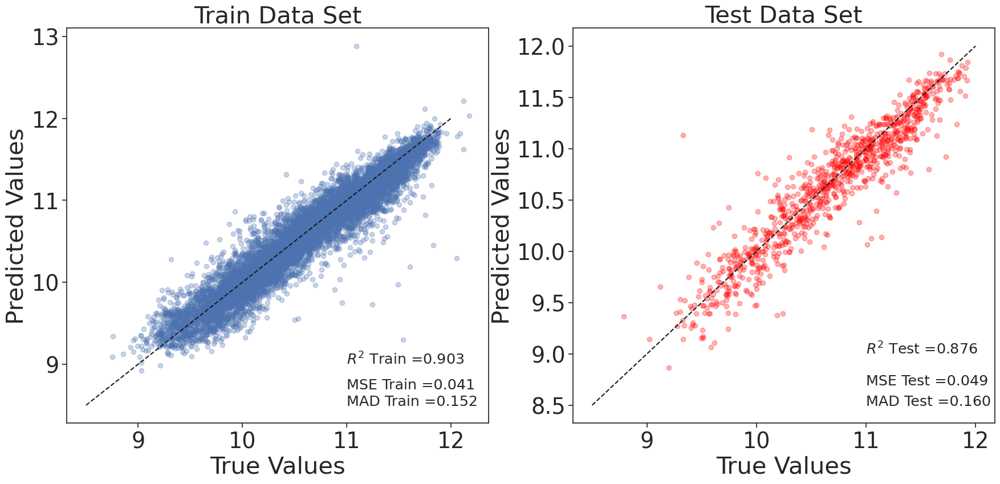

In [28]:
outlier = np.where((np.array(train_mass_list)<13) & (np.array(train_mass_list)>8))[0]
outlier_test = np.where((np.array(test_mass_list)<13))[0]

plt.figure(figsize=(21,9))
plt.subplot(1,2,1)
plt.title('Train Data Set')
plt.scatter(np.array(train_mass_list)[outlier],np.array(predictions_train)[outlier],alpha=0.3)
plt.plot([8.5,12],[8.5,12],'k--')
plt.text(11,9,'$R^2$ Train ='+str((r2_score(np.array(train_mass_list)[outlier],np.array(predictions_train)[outlier])))[0:5],fontsize='small')
plt.text(11,8.7,'MSE Train =' +str(mean_squared_error(np.array(train_mass_list)[outlier],np.array(predictions_train)[outlier]))[0:5], fontsize='small')
plt.text(11,8.5,'MAD Train ='+ str(mean_absolute_error(np.array(train_mass_list)[outlier],np.array(predictions_train)[outlier]))[0:5], fontsize='small')
plt.xlabel('True Values')
plt.ylabel('Predicted Values')
plt.subplot(1,2,2)
plt.title('Test Data Set')
plt.scatter(np.array(test_mass_list)[outlier_test],np.array(predictions_test)[outlier_test],alpha=0.3,c='red')
plt.plot([8.5,12],[8.5,12],'k--')
plt.text(11,9,'$R^2$ Test ='+str((r2_score(np.array(test_mass_list)[outlier_test],np.array(predictions_test)[outlier_test])))[0:5],fontsize='small')
plt.text(11,8.7,'MSE Test =' +str(mean_squared_error(np.array(test_mass_list)[outlier_test],np.array(predictions_test)[outlier_test]))[0:5], fontsize='small')
plt.text(11,8.5,'MAD Test ='+str(mean_absolute_error(np.array(test_mass_list)[outlier_test],np.array(predictions_test)[outlier_test]))[0:5], fontsize='small')
plt.xlabel('True Values')
plt.ylabel('Predicted Values')
# plt.savefig('Mass_Accuracy.pdf')

In [29]:
device = 'cuda'
model_used = 'ResNet50_log_t50_chain_90_10'

model_mass = models.resnet50(weights=None)
model_mass.fc = nn.Linear(2048, 1)
model_mass = nn.DataParallel(model_mass,device_ids=(0,1))
model_mass.load_state_dict(torch.load(work_dir+'models/Mass_'+model_used+'.pytorch'),strict=True)#strict is set to false since it was trained on multiple GPUs it causes an error when loaded on the model that is not on multiple GPUs yet
                                                                                                # DO NOT DO THIS!! MESSES WITH THE MODEL PREDECTIONS HEAVILY
model_mass.eval()

model_sfr = models.resnet50(weights='ResNet50_Weights.IMAGENET1K_V1')
model_sfr.conv1 = nn.Conv2d(4, 64, kernel_size=7, stride=2, padding=3,bias=False)
model_sfr.fc = nn.Linear(2048, 1)
model_sfr = nn.DataParallel(model_sfr,device_ids=(0,1))
model_sfr.load_state_dict(torch.load(work_dir+'models/SFR_'+model_used+'.pytorch'),strict=True)
model_sfr.eval()

model_used = 'd4000_chain'

model_t50 = models.resnet50(weights='ResNet50_Weights.IMAGENET1K_V1')
model_t50.conv1 = nn.Conv2d(5, 64, kernel_size=7, stride=2, padding=3,bias=False)
model_t50.fc = nn.Linear(2048, 1)
model_t50 = nn.DataParallel(model_t50,device_ids=(0,1))
model_t50.load_state_dict(torch.load(work_dir+'models/d4000_'+model_used+'.pytorch'),strict=True)
model_t50.eval()

model_mass, model_sfr, model_t50 = model_mass.to(device), model_sfr.to(device), model_t50.to(device)



In [30]:
#Run images through the model and extract the predicitions

predictions_train_sfr =[]
predictions_train_t50 =[]

predictions_test_sfr =[]
predictions_test_t50 =[]

incomplete_batch_id_test=len(val_ids)-1

remainder_test=len(val_ids[incomplete_batch_id_test])

total_values_test=(len(val_ids)*batch_size)-(batch_size-remainder_test)

incomplete_batch_id_train=len(train_ids)-1

remainder_train=len(train_ids[incomplete_batch_id_train])

total_values_train=(len(train_ids)*batch_size)-(batch_size-remainder_train)

#Getting predictions for the train set 
for batch_idx, temp in enumerate(train_loader):

    if batch_idx<incomplete_batch_id_train:
        image_batch = temp['image'].to('cuda')
        pred_mass_batch = model_mass(image_batch)
        # print(pred_mass_batch)
        mass_batch = np.zeros((batch_size,1,256,256))

      
        for i in range(batch_size):
            mass_batch[i,:,:,:]=np.ones((1,1,256,256))*pred_mass_batch.detach().cpu().numpy().flatten()[i]
        image_mass_batch = torch.concat((image_batch,torch.tensor(mass_batch).float().to('cuda')),1)

        pred_sfr_batch= model_sfr(image_mass_batch)
        sfr_batch = np.zeros((batch_size,1,256,256))
        for i in range(batch_size):
            sfr_batch[i,:,:,:]=np.ones((1,1,256,256))*pred_sfr_batch.detach().cpu().numpy().flatten()[i]
        

        image_mass_sfr_batch = torch.concat((image_mass_batch,torch.tensor(sfr_batch).float().to('cuda')),1)

        pred_t50_batch = model_t50(image_mass_sfr_batch)

        pred_sfr_batch, pred_t50_batch = pred_sfr_batch.detach().cpu().numpy(), pred_t50_batch.detach().cpu().numpy()
    
        for j in range(batch_size):     
            predictions_train_sfr.append(pred_sfr_batch[j])
            predictions_train_t50.append(pred_t50_batch[j])


    else:
        image_batch = temp['image'].to('cuda')
        pred_mass_batch = model_mass(image_batch)
        mass_batch = np.zeros((remainder_train,1,256,256))
        for i in range(remainder_train):
            mass_batch[i,:,:,:]=np.ones((1,1,256,256))*pred_mass_batch.detach().cpu().numpy().flatten()[i]
        image_mass_batch = torch.concat((image_batch,torch.tensor(mass_batch).float().to('cuda')),1)

        pred_sfr_batch= model_sfr(image_mass_batch)
        sfr_batch = np.zeros((remainder_train,1,256,256))
        for i in range(remainder_train):
            sfr_batch[i,:,:,:]=np.ones((1,1,256,256))*pred_sfr_batch.detach().cpu().numpy().flatten()[i]
        

        image_mass_sfr_batch = torch.concat((image_mass_batch,torch.tensor(sfr_batch).float().to('cuda')),1)

        pred_t50_batch = model_t50(image_mass_sfr_batch)

        pred_sfr_batch, pred_t50_batch = pred_sfr_batch.detach().cpu().numpy(), pred_t50_batch.detach().cpu().numpy()
    
        for k in range(remainder_train):
            predictions_train_sfr.append(pred_sfr_batch[k])
            predictions_train_t50.append(pred_t50_batch[k])




#Getting Predicitions for the Test set 
for batch_idx, temp in enumerate(val_loader):

    if batch_idx<incomplete_batch_id_test:
        image_batch = temp['image'].to('cuda')
        pred_mass_batch = model_mass(image_batch)
        mass_batch = np.zeros((batch_size,1,256,256))
        for i in range(batch_size):
            mass_batch[i,:,:,:]=np.ones((1,1,256,256))*pred_mass_batch.detach().cpu().numpy().flatten()[i]
        image_mass_batch = torch.concat((image_batch,torch.tensor(mass_batch).float().to('cuda')),1)

        pred_sfr_batch= model_sfr(image_mass_batch)
        sfr_batch = np.zeros((batch_size,1,256,256))
        for i in range(batch_size):
            sfr_batch[i,:,:,:]=np.ones((1,1,256,256))*pred_sfr_batch.detach().cpu().numpy().flatten()[i]
        
        
        image_mass_sfr_batch = torch.concat((image_mass_batch,torch.tensor(sfr_batch).float().to('cuda')),1)

        pred_t50_batch = model_t50(image_mass_sfr_batch)

        pred_sfr_batch, pred_t50_batch = pred_sfr_batch.detach().cpu().numpy(), pred_t50_batch.detach().cpu().numpy()

        for j in range(batch_size):     
            predictions_test_sfr.append(pred_sfr_batch[j])
            predictions_test_t50.append(pred_t50_batch[j])


    else:
        image_batch = temp['image'].to('cuda')
        pred_mass_batch = model_mass(image_batch)
        mass_batch = np.zeros((remainder_test,1,256,256))
        for i in range(remainder_test):
            mass_batch[i,:,:,:]=np.ones((1,1,256,256))*pred_mass_batch.detach().cpu().numpy().flatten()[i]
        image_mass_batch = torch.concat((image_batch,torch.tensor(mass_batch).float().to('cuda')),1)

        pred_sfr_batch= model_sfr(image_mass_batch)
        sfr_batch = np.zeros((remainder_test,1,256,256))
        for i in range(remainder_test):
            sfr_batch[i,:,:,:]=np.ones((1,1,256,256))*pred_sfr_batch.detach().cpu().numpy().flatten()[i]
        
        
        image_mass_sfr_batch = torch.concat((image_mass_batch,torch.tensor(sfr_batch).float().to('cuda')),1)
        pred_t50_batch = model_t50(image_mass_sfr_batch)

        pred_sfr_batch, pred_t50_batch = pred_sfr_batch.detach().cpu().numpy(), pred_t50_batch.detach().cpu().numpy()
        
        for k in range(remainder_test):
            predictions_test_sfr.append(pred_sfr_batch[k])
            predictions_test_t50.append(pred_t50_batch[k])



In [22]:
from sklearn.metrics import mean_squared_error, mean_absolute_error
plt.rcParams.update({'font.size': 22})

In [51]:
outlier_index_test = np.where(np.array(predictions_test_sfr)>-2)[0]
ssfr = (np.array(test_sfr_list)[outlier_index_test]-np.array(test_mass_list)[outlier_index_test])

test_sfr_list_f = np.array(test_sfr_list)[outlier_index_test]
predictions_test_sfr_f = np.array(predictions_test_sfr)[outlier_index_test]

index_of_interest = np.where(ssfr>-10.8)[0]
print(np.sqrt(mean_squared_error(np.array(test_sfr_list_f)[index_of_interest],np.array(predictions_test_sfr_f)[index_of_interest])))

0.306524655594962


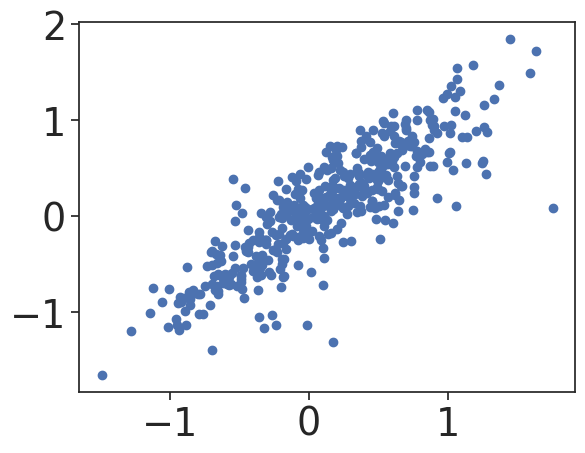

In [52]:
plt.scatter(np.array(test_sfr_list_f)[index_of_interest],np.array(predictions_test_sfr_f)[index_of_interest])

Text(0, 0.5, 'Predicted Values')

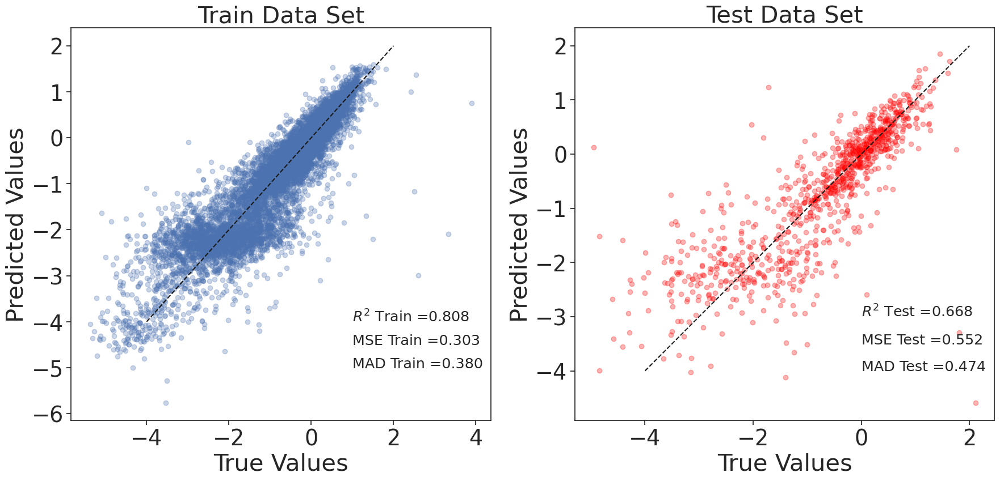

In [32]:
outlier_index_train = np.where((np.array(predictions_train_sfr)>-6) & (np.array(predictions_train_sfr)<3))[0]
outlier_index_test = np.where(np.array(predictions_test_sfr)>-6)[0]

plt.figure(figsize=(21,9))
plt.subplot(1,2,1)
plt.title('Train Data Set')
plt.scatter(np.array(train_sfr_list)[outlier_index_train],np.array(predictions_train_sfr)[outlier_index_train],alpha=0.3)
plt.plot([-4,2],[-4,2],'k--')
plt.text(1,-4,'$R^2$ Train ='+str((r2_score(np.array(train_sfr_list)[outlier_index_train],np.array(predictions_train_sfr)[outlier_index_train])))[0:5],fontsize='small')
plt.text(1,-4.5,'MSE Train ='+str((mean_squared_error(np.array(train_sfr_list)[outlier_index_train],np.array(predictions_train_sfr)[outlier_index_train])))[0:5],fontsize='small')
plt.text(1,-5,'MAD Train ='+str((mean_absolute_error(np.array(train_sfr_list)[outlier_index_train],np.array(predictions_train_sfr)[outlier_index_train])))[0:5],fontsize='small')
plt.xlabel('True Values')
plt.ylabel('Predicted Values')
plt.subplot(1,2,2)
plt.title('Test Data Set')
plt.scatter(np.array(test_sfr_list)[outlier_index_test],np.array(predictions_test_sfr)[outlier_index_test],alpha=0.3,c='red')
plt.plot([-4,2],[-4,2],'k--')
plt.text(0,-3,'$R^2$ Test ='+str((r2_score(np.array(test_sfr_list)[outlier_index_test],np.array(predictions_test_sfr)[outlier_index_test])))[0:5],fontsize='small')
plt.text(0,-3.5,'MSE Test ='+str((mean_squared_error(np.array(test_sfr_list)[outlier_index_test],np.array(predictions_test_sfr)[outlier_index_test])))[0:5],fontsize='small')
plt.text(0,-4,'MAD Test ='+str((mean_absolute_error(np.array(test_sfr_list)[outlier_index_test],np.array(predictions_test_sfr)[outlier_index_test])))[0:5],fontsize='small')
plt.xlabel('True Values')
plt.ylabel('Predicted Values')
# plt.savefig('SFR_Accuracy.pdf')

Text(0, 0.5, 'Predicted Values')

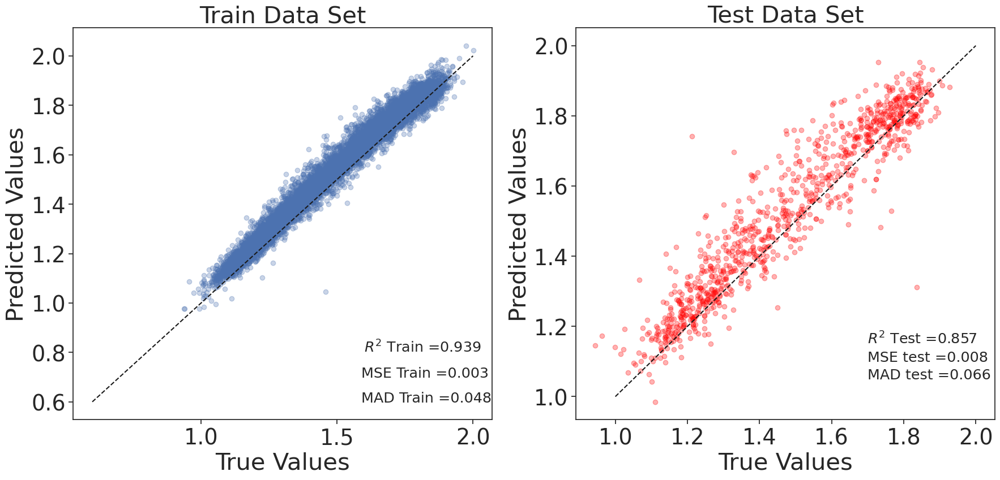

In [33]:
outlier_index_train = np.where((np.array(predictions_train_t50)<10))[0]

plt.figure(figsize=(21,9))
plt.subplot(1,2,1)
plt.title('Train Data Set')
plt.scatter(np.array(train_t50_list)[outlier_index_train],np.array(predictions_train_t50)[outlier_index_train],alpha=0.3)
plt.plot([0.6,2],[0.6,2],'k--')
# plt.ylim(top=2)
plt.text(1.6,0.8,'$R^2$ Train ='+str((r2_score(np.array(train_t50_list)[outlier_index_train],np.array(predictions_train_t50)[outlier_index_train])))[0:5],fontsize='small')
plt.text(1.59,0.7,'MSE Train ='+str((mean_squared_error(np.array(train_t50_list)[outlier_index_train],np.array(predictions_train_t50)[outlier_index_train])))[0:5],fontsize='small')
plt.text(1.59,0.6,'MAD Train ='+str((mean_absolute_error(np.array(train_t50_list)[outlier_index_train],np.array(predictions_train_t50)[outlier_index_train])))[0:5],fontsize='small')
plt.xlabel('True Values')
plt.ylabel('Predicted Values')
plt.subplot(1,2,2)
plt.title('Test Data Set')
plt.scatter(np.array(test_t50_list),predictions_test_t50,alpha=0.3,c='red')
plt.plot([1,2],[1,2],'k--')
plt.text(1.7,1.15,'$R^2$ Test ='+str((r2_score(np.array(test_t50_list),predictions_test_t50)))[0:5],fontsize='small')
plt.text(1.7,1.1,'MSE test ='+str((mean_squared_error(np.array(test_t50_list)[outlier_index_test],np.array(predictions_test_t50)[outlier_index_test])))[0:5],fontsize='small')
plt.text(1.7,1.05,'MAD test ='+str((mean_absolute_error(np.array(test_t50_list)[outlier_index_test],np.array(predictions_test_t50)[outlier_index_test])))[0:5],fontsize='small')
plt.xlabel('True Values')
plt.ylabel('Predicted Values')
# plt.savefig('D4000_Accuracy.pdf')

# Figure 4

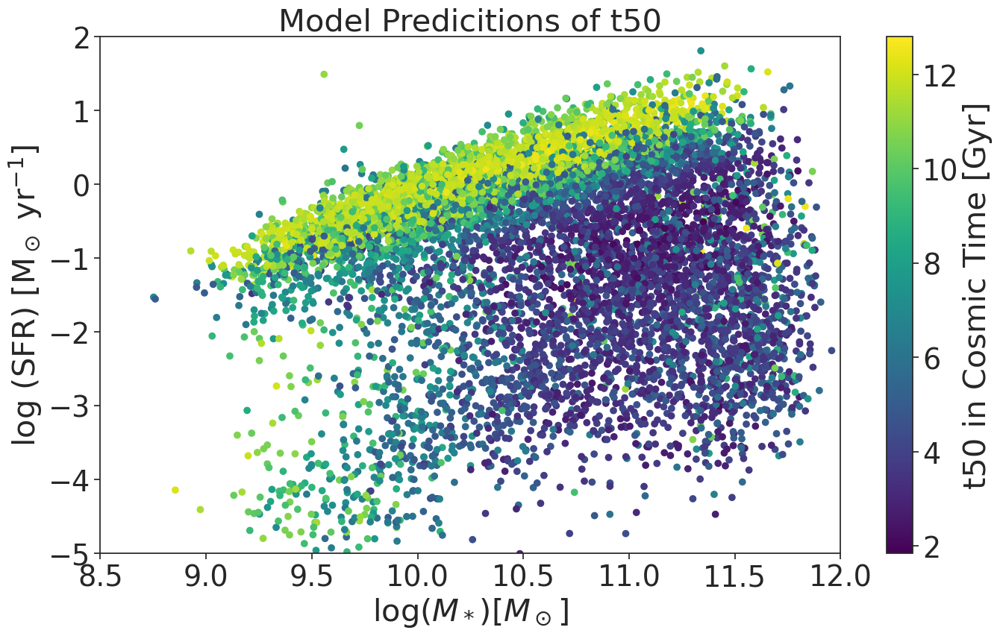

In [11]:
physical_index = np.where(10**np.array(train_t50_model_list) < 13.6)[0]

plt.figure(figsize=(16,9))
plt.scatter(np.array(train_mass_list)[physical_index],np.array(train_sfr_list)[physical_index],c=10**np.array(train_t50_model_list)[physical_index],cmap='viridis')
plt.title('Model Predicitions of t50')
plt.xlabel(r'log$(M_*)[M_\odot]$')
plt.ylabel(r'log (SFR) [M$_\odot$ yr$^{-1}$]')
plt.xlim(8.5,12)
plt.ylim(-5,2)
plt.colorbar(label='t50 in Cosmic Time [Gyr]')
plt.savefig('MaNGA_t50_new.pdf')

# Figure 5

In [51]:
def plot_images_maps(xim = 5, yim = 5, imsize = 4, key='images', ids = [], sigma = 2,random_mode = False):
    
    if len(ids) == 0:
        if random_mode == True:
            ids = np.random.randint(len(d_im['images']),size=xim*yim)
        if random_mode == False:
            ids = np.arange(xim*yim)
    plt.subplots(figsize=(imsize*xim,imsize*yim))
    plt.subplots_adjust(hspace=0.01,wspace=0.01)
    
    shapmaps = []
    for i in range(xim*yim):
        plt.subplot(yim,xim,i+1)
        try:
            if key == 'images':

                plt.imshow(d_im['images'][ids[i]], origin='lower')
                tempx, tempy = plt.xlim(), plt.ylim()
                plt.text(tempx[1]*0.042, tempy[1]*0.9, 'Manga-id: '+manga_scalars['mangaid'][ids[i]], color='white', fontsize=14)
                plt.text(tempx[1]*0.042, tempy[1]*0.81, manga_scalars['split'][ids[i]], color='white', fontsize=12)
                plt.text(tempx[1]*0.04, tempy[1]*0.09, ' n: %.1f \n A$_V$: %.1f \n z: %.3f' %(manga_scalars['sersic_n'][ids[i]], manga_scalars['Av'][ids[i]], manga_scalars['redshift'][ids[i]]) , color='white', fontsize=14)
            elif key == 'shap_mass':            

                temp = d_shapmass['shap_map_mass'][ids[i]].copy()
                temp = ndimage.gaussian_filter(temp, sigma, mode='nearest')
                temp[np.abs(temp)<np.amax(np.nanpercentile(temp,[2,98]))] = np.nan
                # clim = np.amax(np.abs(np.nanpercentile(temp,[2,98])))
                clim = np.amax(np.abs(temp))
                plt.imshow(d_im['images'][ids[i]],alpha=0.4, origin='lower')
                plt.pcolor(np.sum(temp,2), cmap='bwr',alpha=0.9)
                tempx, tempy = plt.xlim(), plt.ylim()
                plt.text(tempx[1]*0.042, tempy[1]*0.9, 'log M$_*$ [M$_\odot$]: %.2f' %manga_scalars['log_mstar'][ids[i]], color='k', fontsize=14)
                plt.text(tempx[1]*0.042, tempy[1]*0.81, '$\Delta$M$_{*}^{\mathrm{pred}}$ [M$_\odot$]: %.1f' %(manga_scalars['log_mstar'][ids[i]] - manga_scalars['pred_mstar'][ids[i]]), color='k', fontsize=12)
                shapmaps.append(d_shapmass['shap_map_mass'][ids[i]].copy())
            elif key == 'shap_sfr':

                temp = d_shapsfr['shap_map_mass'][ids[i]].copy()
                temp = ndimage.gaussian_filter(temp, sigma, mode='nearest')
                temp[np.abs(temp)<np.amax(np.nanpercentile(temp,[2,98]))] = np.nan
                clim = np.amax(np.abs(np.nanpercentile(temp,[2,98])))
                plt.imshow(d_im['images'][ids[i]],alpha=0.4, origin='lower')
                plt.pcolor(np.sum(temp,2), cmap='bwr',alpha=0.9)
                tempx, tempy = plt.xlim(), plt.ylim()
                plt.text(tempx[1]*0.042, tempy[1]*0.9, 'log SFR [M$_\odot$ yr$^{-1}$]:  %.2f' %manga_scalars['log_sfr'][ids[i]], color='k', fontsize=14)
                plt.text(tempx[1]*0.042, tempy[1]*0.81, '$\Delta$SFR$^{\mathrm{pred}}$ [M$_\odot$ yr$^{-1}$]: %.1f' %(manga_scalars['log_sfr'][ids[i]] - manga_scalars['pred_sfr'][ids[i]]), color='k', fontsize=12)
                shapmaps.append(d_shapmass['shap_map_mass'][ids[i]].copy())
            elif key == 'shap_age':

                temp = d_shapage['shap_map_mass'][ids[i]].copy()
                temp = ndimage.gaussian_filter(temp, sigma, mode='nearest')
                temp[np.abs(temp)<np.amax(np.nanpercentile(temp,[2,98]))] = np.nan
                clim = np.amax(np.abs(np.nanpercentile(temp,[2,98])))
                plt.imshow(d_im['images'][ids[i]],alpha=0.4, origin='lower')
                plt.pcolor(np.sum(temp,2), cmap='bwr',alpha=0.9)
                tempx, tempy = plt.xlim(), plt.ylim()
                plt.text(tempx[1]*0.042, tempy[1]*0.9, 'd4000: %.2f' %manga_scalars['d4000'][ids[i]], color='k', fontsize=14)
                plt.text(tempx[1]*0.042, tempy[1]*0.81, '$\Delta$d4000$^{\mathrm{pred}}$: %.1f' %(manga_scalars['d4000'][ids[i]] - manga_scalars['pred_d4000'][ids[i]]), color='k', fontsize=12)
                shapmaps.append(d_shapmass['shap_map_mass'][ids[i]].copy())
            plt.axis('off')

        except:

            plt.axis('off')
            print('no shap for id = ',ids[i])
    return shapmaps

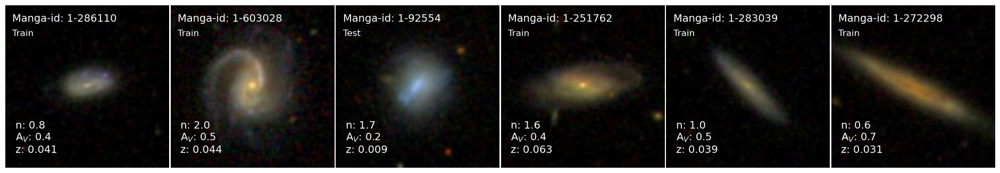

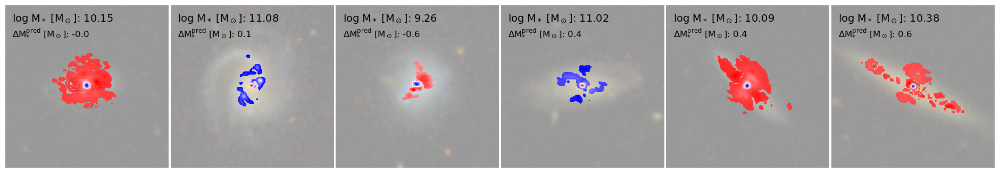

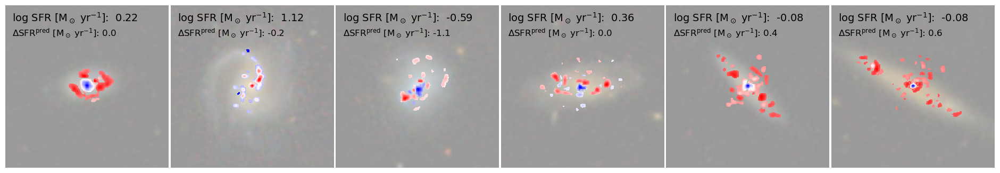

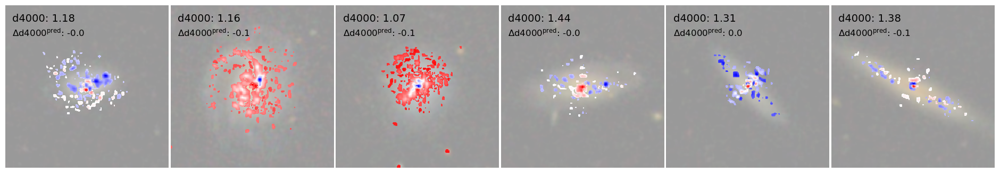

In [54]:
# ids = np.array([10066,  997, 4140, 8800, 9831, 3256, 4068, 3795, 2946, 2773])
ids = np.array([4140, 8800, 9831, 3256, 4068, 3795])
sigmaval = 2.0
xim = 6
yim = 1


plot_images_maps(xim,yim, ids=ids, key='images', sigma=sigmaval)
plt.savefig('gal_images_selected.pdf')
plot_images_maps(xim,yim, ids=ids, key='shap_mass', sigma=sigmaval)
plt.savefig('gal_shap_mass_selected.pdf')
plot_images_maps(xim,yim, ids=ids, key='shap_sfr', sigma=sigmaval)
plt.savefig('gal_shap_sfr_selected.pdf')
plot_images_maps(xim,yim, ids=ids, key='shap_age', sigma=sigmaval);
plt.savefig('gal_shap_age_selected.pdf')
plt.show()

# Figure 6 

[ 9.   9.3  9.6  9.9 10.2 10.5 10.8 11.1 11.4 11.7 12. ]
(518, 179)
(1326, 179)
(2511, 179)
(3491, 179)
(4233, 179)
(4633, 179)
(4861, 179)
(4731, 179)
(3749, 179)
(2224, 179)
(856, 179)
[-15.  -14.7 -14.4 -14.1 -13.8 -13.5 -13.2 -12.9 -12.6 -12.3 -12.  -11.7
 -11.4 -11.1 -10.8 -10.5 -10.2  -9.9  -9.6  -9.3  -9.   -8.7  -8.4  -8.1]
(214, 179)
(380, 179)
(600, 179)
(854, 179)
(1057, 179)
(1256, 179)
(1336, 179)
(1425, 179)
(1425, 179)
(1427, 179)
(1440, 179)
(1462, 179)
(1628, 179)
(2140, 179)
(3257, 179)
(4327, 179)
(4207, 179)
(2950, 179)
(1181, 179)
(169, 179)
(10, 179)
(5, 179)
(9, 179)
(10, 179)
[0.9 1.  1.1 1.2 1.3 1.4 1.5 1.6 1.7 1.8 1.9]
(4271, 179)
(5306, 179)
(6295, 179)
(7439, 179)
(9074, 179)
(9934, 179)
(9957, 179)
(9730, 179)
(8433, 179)
(6887, 179)
(5701, 179)


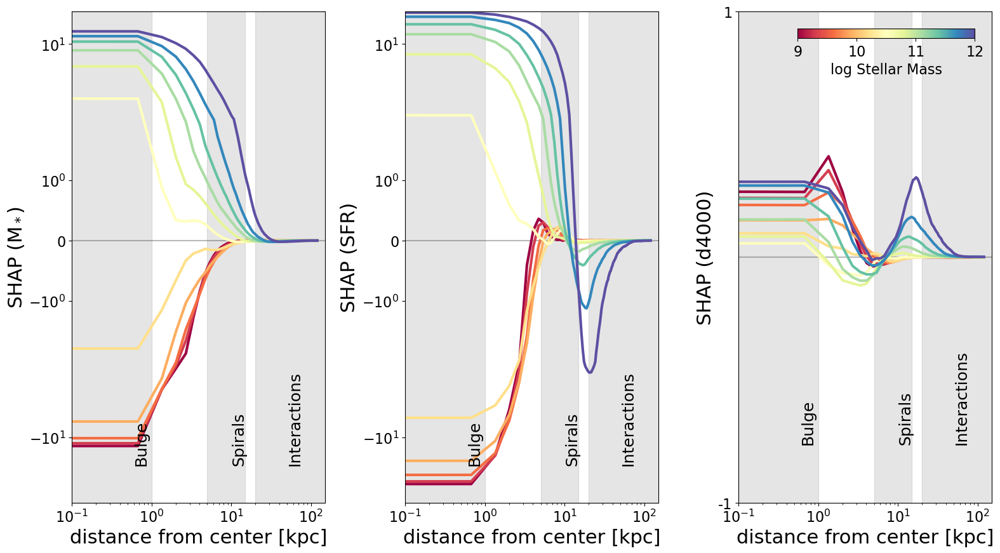

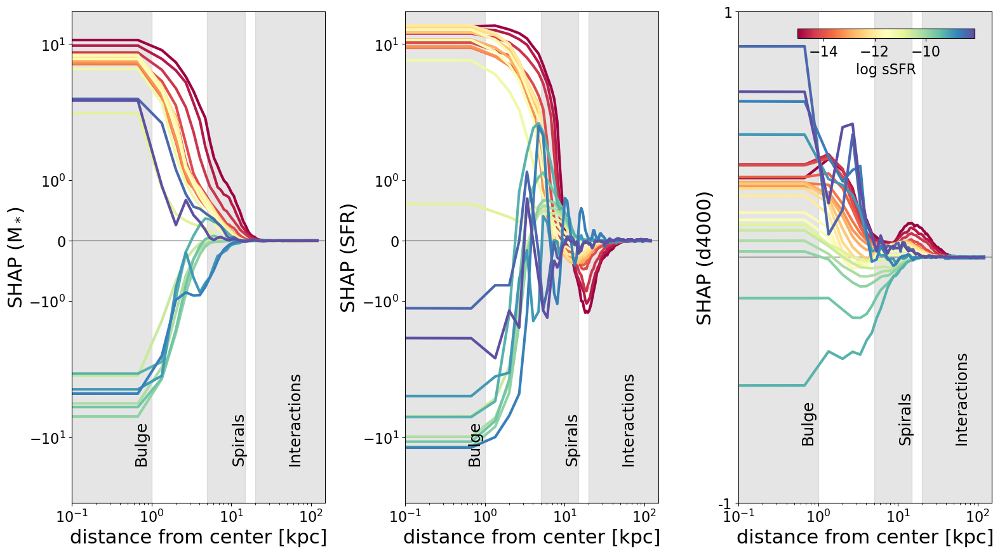

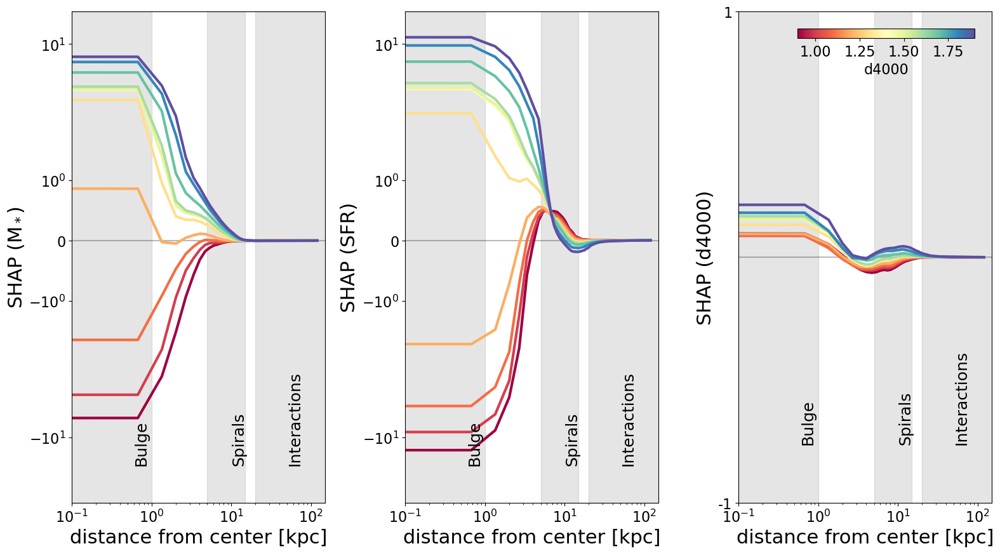

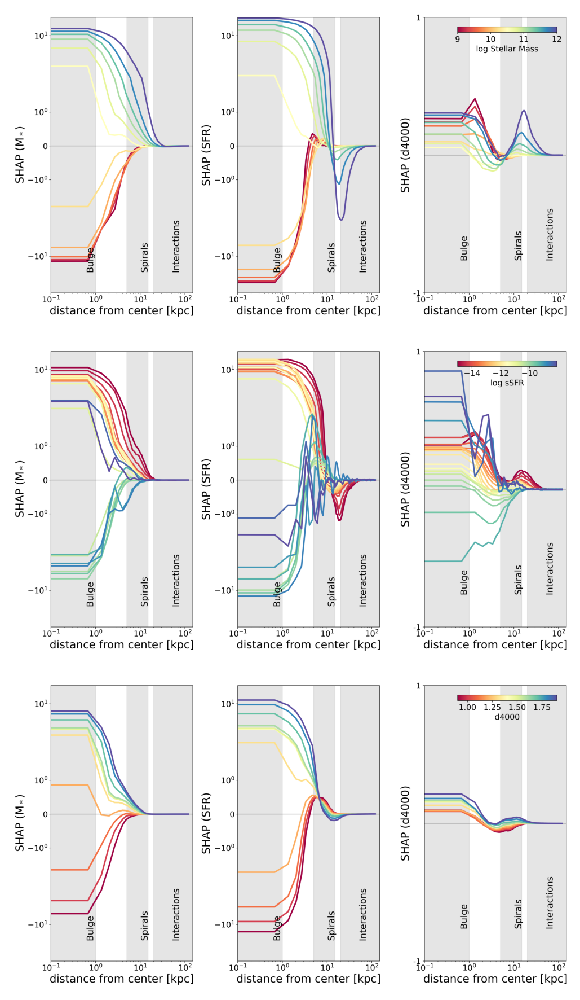

In [47]:
plt.rcParams.update({'font.size': 16})
# plt.rcParams.update(plt.rcParamsDefault)
# fig, ax = plt.subplots(3,3, figsize=(16,9))


make_radial_shapplot_merger(mv=manga_scalars['log_mstar'], 
                                      massbins=np.arange(9, 12.1, 0.3),
                                      clabel='log Stellar Mass')

plt.savefig('mass_radial_plot_new.png',dpi=500)

make_radial_shapplot_merger(mv=manga_scalars['log_sfr'] - manga_scalars['log_mstar'], 
                                massbins=np.arange(-15, -8, 0.3),
                                clabel='log sSFR',
                                zbin=0.1, zbw=0.1)

plt.savefig('sfr_radial_plot_new.png',dpi=500)

make_radial_shapplot_merger(mv=manga_scalars['d4000'], 
                                massbins=np.arange(0.9, 2.0, 0.1),
                                clabel='d4000')

plt.savefig('d4000_radial_plot_new.png',dpi=500)


import matplotlib.image as mpimg

# Define the file paths for your PNG images (replace these with your actual file paths)
image_path_a = 'mass_radial_plot_new.png'
image_path_b = 'sfr_radial_plot_new.png'
image_path_c = 'd4000_radial_plot_new.png'

# Create subplots
fig, axs = plt.subplots(3, 1, figsize=(4*4, 3*6))

# Load and display the PNG images in subplots
image_a = mpimg.imread(image_path_a)
axs[0].imshow(image_a)
# axs[0].set_title('Image a')
axs[0].axis('off')

image_b = mpimg.imread(image_path_b)
axs[1].imshow(image_b)
# axs[1].set_title('Image b')
axs[1].axis('off')

image_c = mpimg.imread(image_path_c)
axs[2].imshow(image_c)
# axs[2].set_title('Image c')
axs[2].axis('off')

# Adjust spacing between subplots
plt.tight_layout()

# Show the figure
plt.savefig('primary_radial_plots_new.pdf')
plt.show()


# Figure 7

In [17]:
mass_avgs = []
sfr_avgs = []
d4000_avgs = []
sigma = 2.0
for i in tqdm(range(len(d_shapmass['shap_map_mass']))):
    try:
        temp = np.mean(ndimage.gaussian_filter(d_shapmass['shap_map_mass'][i]*1e4, sigma, mode='nearest'),2)
        mass_avgs.append(azimuthalAverage(temp))
        temp = np.mean(ndimage.gaussian_filter(d_shapsfr['shap_map_mass'][i]*1e4, sigma, mode='nearest'),2)
        sfr_avgs.append(azimuthalAverage(temp))
        temp = np.mean(ndimage.gaussian_filter(d_shapage['shap_map_mass'][i]*1e4, sigma, mode='nearest'),2)
        d4000_avgs.append(azimuthalAverage(temp))
    except:
        mass_avgs.append(np.ones((179,))*np.nan)
        sfr_avgs.append(np.ones((179,))*np.nan)
        d4000_avgs.append(np.ones((179,))*np.nan)
mass_avgs = np.array(mass_avgs)
sfr_avgs = np.array(sfr_avgs)
d4000_avgs = np.array(d4000_avgs)

100%|██████████| 10081/10081 [07:18<00:00, 22.99it/s]


In [ ]:
common_x_axis = []
for i in range(len(mass_avgs)):
   common_x_axis.append(get_xax(manga_scalars['redshift'][i]))

def find_largest_array(arrays):
    largest_size = 0
    largest_array = []

    for array in arrays:
        if len(array) > largest_size:
            largest_size = len(array)
            largest_array = array

    return largest_array

ref_array = find_largest_array(common_x_axis)

mass_avgs_interp = []
for i in range(len(common_x_axis)):
    mass_avgs_interp.append(np.interp(ref_array, common_x_axis[i], mass_avgs[i]))

sfr_avgs_interp = []
for i in range(len(common_x_axis)):
    sfr_avgs_interp.append(np.interp(ref_array, common_x_axis[i], sfr_avgs[i]))

d4000_avgs_interp = []
for i in range(len(common_x_axis)):
    d4000_avgs_interp.append(np.interp(ref_array, common_x_axis[i], d4000_avgs[i]))

mass_avgs_interp = np.array(mass_avgs_interp)
sfr_avgs_interp = np.array(sfr_avgs_interp)
d4000_avgs_interp = np.array(d4000_avgs_interp)

625
0.0 20.18961038838942


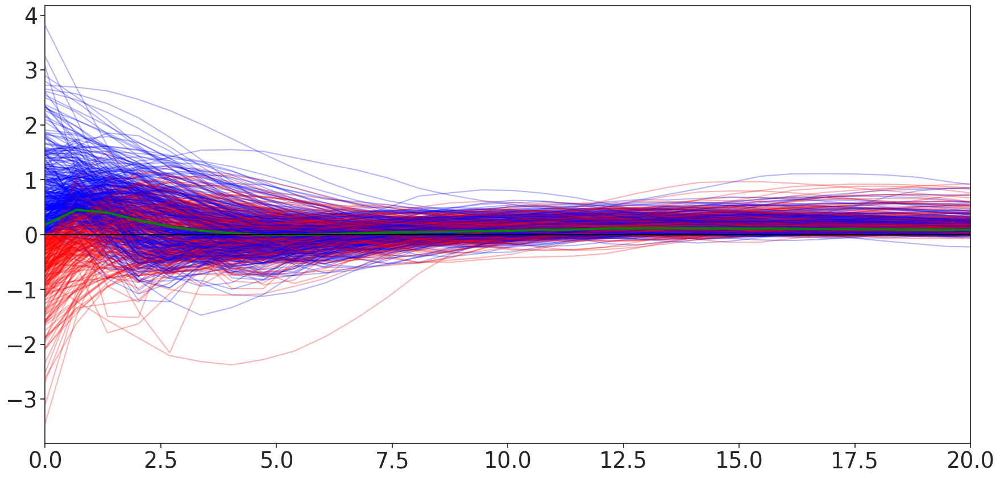

In [61]:
interest =  np.where((np.array(manga_scalars['log_mstar'])>11) & (np.array(manga_scalars['log_mstar'])<13) & (np.array(manga_scalars['d4000'])> 1.8) & (np.array(manga_scalars['d4000'])<2))[0]
print(len(interest))
plt.figure(figsize=(21,10))
for i in interest:
    if d4000_avgs_interp[i,0] > 0:
        plt.plot(ref_array, d4000_avgs_interp[i,:], color='blue', alpha=0.3)
    else:
        plt.plot(ref_array, d4000_avgs_interp[i,:], color='red', alpha=0.3)

plt.plot(ref_array, np.nanmedian(d4000_avgs_interp[interest,:],0), color='green', lw=3)
plt.hlines(0,0,2e2, color='black', alpha=1)
plt.xlim(0,20)

start_point = find_nearest_index(0, ref_array)
end_point = find_nearest_index(20, ref_array)

print(ref_array[start_point],ref_array[end_point])


mass_gradients = []
for i in range(len(mass_avgs_interp)):
    mass_gradients.append(mass_avgs_interp[i][end_point]-mass_avgs_interp[i][start_point])

sfr_gradients = []
for i in range(len(sfr_avgs_interp)):
    sfr_gradients.append(sfr_avgs_interp[i][end_point]-sfr_avgs_interp[i][start_point])

d4000_gradients = []
for i in range(len(d4000_avgs_interp)):
    d4000_gradients.append(d4000_avgs_interp[i][end_point]- d4000_avgs_interp[i][start_point])

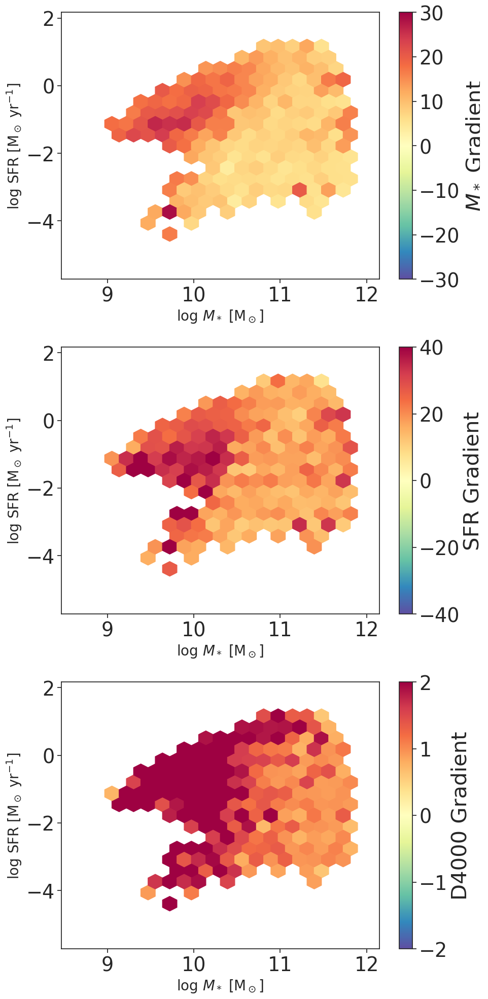

In [65]:
mask = np.where((np.array(manga_scalars['log_mstar'])<12) & (np.array(manga_scalars['d4000'])<3) & (np.array(manga_scalars['log_mstar'])>8.5) & (np.array(manga_scalars['log_sfr'])<2))[0]
# Create a figure and subplots
fig, axs = plt.subplots(nrows=3, ncols=1, figsize=(10, 20))
# fig.suptitle('Galaxies on the $M_*$-SFR Plane Colored by Gradients', fontsize=18)
font_size=20
plt.rcParams.update({'font.size': font_size})

log_mstar = np.array(manga_scalars['log_mstar'])
log_sfr = np.array(manga_scalars['log_sfr'])
mass_gradients = np.array(mass_gradients)
sfr_gradients = np.array(sfr_gradients)
d4000_gradients = np.array(d4000_gradients)

subplot_titles = ['$M_*$ Gradient', 'SFR Gradient', 'D4000 Gradient']

# Plot the hexbin plots on each subplot
def plot_hexbin(ax, x, y, c, cmap, vmin, vmax, label):
    hb = ax.hexbin(x[mask], y[mask], C=c[mask], cmap=cmap, vmin=vmin, vmax=vmax, gridsize=20,mincnt=10,reduce_C_function=np.nanstd)
    ax.set_xlabel('log $M_*$ [M$_\odot$]',fontsize=font_size)
    ax.set_ylabel('log SFR [M$_\odot$ yr$^{-1}$]',fontsize=font_size)
    return hb

hb1 = plot_hexbin(axs[0], log_mstar, log_sfr, mass_gradients, 'Spectral_r', -30, 30, 'Dispersion in Mass Gradient')
hb2 = plot_hexbin(axs[1], log_mstar, log_sfr, sfr_gradients, 'Spectral_r', -40, 40, 'Dispersion in SFR Gradient')
hb3 = plot_hexbin(axs[2], log_mstar, log_sfr, d4000_gradients, 'Spectral_r', -2, 2, 'Dispersion in D4000 Gradient')


# Create a colorbar for each subplot
cbar1 = fig.colorbar(hb1, ax=axs[0], label='$M_*$ Gradient')
cbar2 = fig.colorbar(hb2, ax=axs[1], label='SFR Gradient')
cbar3 = fig.colorbar(hb3, ax=axs[2], label='D4000 Gradient')

# Set titles for each subplot
# for i, title in enumerate(subplot_titles):
#     axs[i].set_title(title)

plt.tight_layout()
# plt.savefig('hexbin_gradients.pdf')


# Figure 8

# Figure 9

In [ ]:
kis = ['Mass','SFR','d4000']

for i,keyv in enumerate([d_shapmass, d_shapsfr, d_shapage]):

    gshaprads, rshaprads, ishaprads, meanshaprads, color_infos, rad_infos, rel_infos, massval, sfrval = [], [], [], [], [], [], [], [], []

    for gal_id in tqdm(range(len(manga_scalars))):

        sigma = 4.0
        
        try:
            mapval = keyv['shap_map_mass'][gal_id] #* 1e4

            gshaprad = azimuthalAverage(ndimage.gaussian_filter(mapval[:,:,0], sigma, mode='nearest'))
            rshaprad = azimuthalAverage(ndimage.gaussian_filter(mapval[:,:,1], sigma, mode='nearest'))
            ishaprad = azimuthalAverage(ndimage.gaussian_filter(mapval[:,:,2], sigma, mode='nearest'))
            meanshaprad = azimuthalAverage(ndimage.gaussian_filter(np.mean(mapval,2), sigma, mode='nearest'))

            color_info = gshaprad[0] - ishaprad[0]
            rad_info = meanshaprad[0]

            rel_info = rad_info/color_info
            gshaprads.append(gshaprad)
            rshaprads.append(rshaprad)
            ishaprads.append(ishaprad)
            meanshaprads.append(meanshaprad)
            color_infos.append(color_info)
            rad_infos.append(rad_info)
            rel_infos.append(rel_info)
            massval.append(manga_scalars['log_mstar'][gal_id])
            sfrval.append(manga_scalars['log_sfr'][gal_id])
        except:
            continue

    rel_infos = np.array(rel_infos)
    plt.hist(rel_infos[(np.abs(rel_infos)<1)]); plt.show()

     # plt.scatter(massval, sfrval,c=rel_infos,vmin=-1,vmax=1)
    plt.figure(figsize=(12,8.1))
    rel_infos_temp = rel_infos.copy()
    rel_infos_temp[np.abs(rel_infos_temp) > 1] = 1
    plt.hexbin(massval, sfrval,C=np.abs(rel_infos_temp),gridsize=(70,15),cmap='Spectral',vmin=0,vmax=1)
    clbr = plt.colorbar()
    plt.xlim(9,12.2); plt.ylim(-5,2)
    clbr.set_label('relative information in morphology vs g-i color',fontsize=18)
    plt.xlabel('log Stellar Mass [M$_\odot$]', fontsize=18)
    plt.ylabel('log SFR [M$_\odot$yr$^{-1}$]',fontsize=18)
    plt.title(kis[i]+' SHAP maps')
    plt.show()

# Figure 10 

In [ ]:
# does d4k trace mass? sfr? or neither? in diff parts of param space

massdiffs = np.zeros_like(mass_shap_interp)
sfrdiffs = np.zeros_like(sfr_shap_interp)

for galid in range(len(manga_scalars)):

    f1 = mass_shap_interp[galid,1] / sfr_shap_interp[galid,1]
    f2 = mass_shap_interp[galid,1] / d4000_shap_interp[galid,1]
    f3 = sfr_shap_interp[galid,1] / d4000_shap_interp[galid,1]
#     print(np.nansum(np.abs(mass_shap_interp[galid,0:])),np.nansum(np.abs(sfr_shap_interp[galid,0:])),np.nansum(np.abs(d4000_shap_interp[galid,0:])))
    massdiff = (mass_shap_interp[galid,0:] - d4000_shap_interp[galid,0:] * (f2))
    sfrdiff = (sfr_shap_interp[galid,0:] - d4000_shap_interp[galid,0:] * (f3)) 
    massdiffs[galid,0:] = massdiff
    sfrdiffs[galid,0:] = sfrdiff    
    
lm1 = (common_xax >= 0.1) & (common_xax <= 0.3)
massdiff0p1 = np.nansum(np.abs(massdiffs[0:,lm1]),1) / np.sum(lm1)
sfrdiff0p1 = np.nansum(np.abs(sfrdiffs[0:,lm1]),1) / np.sum(lm1)

lm2 = (common_xax >= 0.3) & (common_xax <= 3.0)
massdiff1p0 = np.nansum(np.abs(massdiffs[0:,lm2]),1) / np.sum(lm2)
sfrdiff1p0 = np.nansum(np.abs(sfrdiffs[0:,lm2]),1) / np.sum(lm2)

lm3 = (common_xax >= 3.0) & (common_xax <= 30.0)
massdiff10p0 = np.nansum(np.abs(massdiffs[0:,lm3]),1) / np.sum(lm3)
sfrdiff10p0 = np.nansum(np.abs(sfrdiffs[0:,lm3]),1) / np.sum(lm3)

t1 = np.nanmedian(np.log10(sfrdiff0p1) - np.log10(massdiff0p1))
t2 = np.nanmedian(np.log10(sfrdiff1p0) - np.log10(massdiff1p0))
t3 = np.nanmedian(np.log10(sfrdiff10p0) - np.log10(massdiff10p0))
print(t1,t2,t3)

massdiffs = np.zeros_like(mass_shap_interp)
sfrdiffs = np.zeros_like(sfr_shap_interp)


for galid in range(len(manga_scalars)):

    f1 = mass_shap_interp[galid,1] / sfr_shap_interp[galid,1]
    f2 = mass_shap_interp[galid,1] / d4000_shap_interp[galid,1]
    f3 = sfr_shap_interp[galid,1] / d4000_shap_interp[galid,1]
#     print(np.nansum(np.abs(mass_shap_interp[galid,0:])),np.nansum(np.abs(sfr_shap_interp[galid,0:])),np.nansum(np.abs(d4000_shap_interp[galid,0:])))
    massdiff = (mass_shap_interp[galid,0:] - d4000_shap_interp[galid,0:] * (f2))
    sfrdiff = (sfr_shap_interp[galid,0:] - d4000_shap_interp[galid,0:] * (f3)) 
    massdiffs[galid,0:] = massdiff
    sfrdiffs[galid,0:] = sfrdiff    
    
lm1 = (common_xax >= 0.1) & (common_xax <= 0.3)
massdiff0p1 = np.nansum(np.abs(massdiffs[0:,lm1]),1)
sfrdiff0p1 = np.nansum(np.abs(sfrdiffs[0:,lm1]),1)

lm2 = (common_xax >= 0.3) & (common_xax <= 3.0)
massdiff1p0 = np.nansum(np.abs(massdiffs[0:,lm2]),1)
sfrdiff1p0 = np.nansum(np.abs(sfrdiffs[0:,lm2]),1)

lm3 = (common_xax >= 3.0) & (common_xax <= 30.0)
massdiff10p0 = np.nansum(np.abs(massdiffs[0:,lm3]),1)
sfrdiff10p0 = np.nansum(np.abs(sfrdiffs[0:,lm3]),1)




# Figure 11

In [ ]:
mask = np.where((np.array(manga_scalars['log_mstar'])<12) & (np.array(manga_scalars['d4000'])<3))[0]
# Create a figure and subplots
fig, axs = plt.subplots(nrows=1, ncols=1, figsize=(5, 10))
# fig.suptitle('Galaxies on the $M_*$-SFR Plane Colored by Gradients', fontsize=18)
font_size=20
plt.rcParams.update({'font.size': font_size})

log_mstar = np.array(manga_scalars['log_mstar'])
log_sfr = np.array(manga_scalars['log_sfr'])
mass_gradients = np.array(mass_gradients)
sfr_gradients = np.array(sfr_gradients)
d4000_gradients = np.array(d4000_gradients)

subplot_titles = ['$M_*$ Gradient', 'SFR Gradient', 'D4000 Gradient']

# Plot the hexbin plots on each subplot
def plot_hexbin(ax, x, y, c, cmap, vmin, vmax, label):
    hb = ax.hexbin(x[mask], y[mask], C=c[mask], cmap=cmap, vmin=vmin, vmax=vmax, gridsize=20)
    ax.set_xlabel('log $M_*$ [M$_\odot$]',fontsize=font_size)
    ax.set_ylabel('log SFR [M$_\odot$ yr$^{-1}$]',fontsize=font_size)
    return hb

hb3 = plot_hexbin(axs[0], log_mstar, log_sfr, d4000_gradients, 'Spectral_r', -2, 2, 'D4000 Gradient')


# Create a colorbar for each subplot
cbar3 = fig.colorbar(hb3, ax=axs[0], label='D4000 Gradient')



plt.tight_layout()


# Figure 12

In [ ]:
import scipy.integrate as integrate

manga_scalars_clean_sfh = manga_scalars[manga_scalars['sfh'].notna()]
sfh = np.array(manga_scalars_clean_sfh['sfh'])
mass_avgs_interp_clean = mass_avgs_interp[manga_scalars['sfh'].notna()]
sfr_avgs_interp_clean = sfr_avgs_interp[manga_scalars['sfh'].notna()]
d4000_avgs_interp_clean = d4000_avgs_interp[manga_scalars['sfh'].notna()]

start_point = find_nearest_index(0, ref_array)
end_point = find_nearest_index(20, ref_array)

mass_center_shap = []
sfr_center_shap = []
d4000_center_shap = []

mass_gradients_sfh_clean = []
for i in range(len(mass_avgs_interp_clean)):
    mass_gradients_sfh_clean.append(mass_avgs_interp_clean[i][end_point]-mass_avgs_interp_clean[i][start_point])
    mass_center_shap.append(mass_avgs_interp_clean[i][start_point])

sfr_gradients_sfh_clean = []
for i in range(len(sfr_avgs_interp_clean)):
    sfr_gradients_sfh_clean.append(sfr_avgs_interp_clean[i][end_point]-sfr_avgs_interp_clean[i][start_point])
    sfr_center_shap.append(sfr_avgs_interp_clean[i][start_point])

d4000_gradients_sfh_clean = []
for i in range(len(d4000_avgs_interp_clean)):
    d4000_gradients_sfh_clean.append(d4000_avgs_interp_clean[i][end_point]- d4000_avgs_interp_clean[i][start_point])
    d4000_center_shap.append(d4000_avgs_interp_clean[i][start_point])

sfh_time = sfh[0][0,:] 

current_time = np.max(sfh_time)

dx = (sfh_time[-1]-sfh_time[0])/len(sfh_time)

#100 million years ago
index_01 = find_nearest_index(current_time-0.1, sfh_time)
sfr_01 = []
mass_01 = [] #Mass at the given time (calculated by taking current stellar mass and substracting the integral of the SFH from the current time to the given time)
for i in range(len(sfh)):
    sfr_01.append(sfh[i][1][index_01])
    mass_01.append(10**np.array(manga_scalars_clean_sfh['log_mstar'])[i]- np.trapz(sfh[i][1][index_01:], sfh[i][0][index_01:], dx=dx)) 

#300 million years ago
index_03 = find_nearest_index(current_time-0.3, sfh_time)
sfr_03 = []
mass_03 = []
for i in range(len(sfh)):
    sfr_03.append(sfh[i][1][index_03])
    mass_03.append(10**np.array(manga_scalars_clean_sfh['log_mstar'])[i]- np.trapz(sfh[i][1][index_03:], sfh[i][0][index_03:], dx=dx))

#500 million years ago
index_05 = find_nearest_index(current_time-0.5, sfh_time)
sfr_05 = []
mass_05 =[]
for i in range(len(sfh)):
    sfr_05.append(sfh[i][1][index_05])
    mass_05.append(10**np.array(manga_scalars_clean_sfh['log_mstar'])[i]- np.trapz(sfh[i][1][index_05:], sfh[i][0][index_05:], dx=dx))

#1 billion years ago
index_1 = find_nearest_index(current_time-1, sfh_time)
sfr_1 = []
mass_1 =[]
for i in range(len(sfh)):
    sfr_1.append(sfh[i][1][index_1])
    mass_1.append(10**np.array(manga_scalars_clean_sfh['log_mstar'])[i]- np.trapz(sfh[i][1][index_1:], sfh[i][0][index_1:], dx=dx))

#3 billion years ago
index_3 = find_nearest_index(current_time-3, sfh_time)
sfr_3 = []
mass_3 = []
for i in range(len(sfh)):
    sfr_3.append(sfh[i][1][index_3])
    mass_3.append(10**np.array(manga_scalars_clean_sfh['log_mstar'])[i]- np.trapz(sfh[i][1][index_3:], sfh[i][0][index_3:], dx=dx))

#5 billion years ago
index_5 = find_nearest_index(current_time-5, sfh_time)
sfr_5 = []
mass_5= []
for i in range(len(sfh)):
    sfr_5.append(sfh[i][1][index_5])
    mass_5.append(10**np.array(manga_scalars_clean_sfh['log_mstar'])[i]- np.trapz(sfh[i][1][index_5:], sfh[i][0][index_5:], dx=dx))

#10 billion years ago
index_10 = find_nearest_index(current_time-10, sfh_time)
sfr_10 = []
mass_10=[]
for i in range(len(sfh)):
    sfr_10.append(sfh[i][1][index_10])
    mass_10.append(10**np.array(manga_scalars_clean_sfh['log_mstar'])[i]- np.trapz(sfh[i][1][index_10:], sfh[i][0][index_10:], dx=dx))

#12 billion years ago
index_12 = find_nearest_index(current_time-12, sfh_time)
sfr_12 = []
mass_12 = []
for i in range(len(sfh)):
    sfr_12.append(sfh[i][1][index_12])
    mass_12.append(10**np.array(manga_scalars_clean_sfh['log_mstar'])[i]- np.trapz(sfh[i][1][index_12:], sfh[i][0][index_12:], dx=dx))

sfr_01 = np.array(sfr_01) 
sfr_03 = np.array(sfr_03)
sfr_05 = np.array(sfr_05)
sfr_1 = np.array(sfr_1)
sfr_3 = np.array(sfr_3)
sfr_5 = np.array(sfr_5)
sfr_10 = np.array(sfr_10)
sfr_12 = np.array(sfr_12)

sfr_01 = np.log10(sfr_01+1e-10) #taking log of SFR and adding dampening factor for values equal to 0
sfr_03 = np.log10(sfr_03+1e-10)
sfr_05 = np.log10(sfr_05+1e-10)
sfr_1 = np.log10(sfr_1+1e-10)
sfr_3 = np.log10(sfr_3+1e-10)
sfr_5 = np.log10(sfr_5+1e-10)
sfr_10 = np.log10(sfr_10+1e-10)
sfr_12 = np.log10(sfr_12+1e-10)

mass_01 = np.array(mass_01) 
mass_03 = np.array(mass_03)
mass_05 = np.array(mass_05)
mass_1 = np.array(mass_1)
mass_3 = np.array(mass_3)
mass_5 = np.array(mass_5)
mass_10 = np.array(mass_10)
mass_12 = np.array(mass_12)

mass_01 = np.log10(mass_01)
mass_03 = np.log10(mass_03)
mass_05 = np.log10(mass_05)
mass_1 = np.log10(mass_1)
mass_3 = np.log10(mass_3)
mass_5 = np.log10(mass_5)
mass_10 = np.log10(mass_10)
mass_12 = np.log10(mass_12)


In [ ]:
sfr_interest= [sfr_01, sfr_03, sfr_05, sfr_1, sfr_3, sfr_5, sfr_10, sfr_12]
mass_interest = [mass_01, mass_03, mass_05, mass_1, mass_3, mass_5, mass_10, mass_12]
label_interest = ['100 Myr ago', '300 Myr ago', '500 Myr ago', '1 Gyr ago', '3 Gyr ago', '5 Gyr ago', '10 Gyr ago', '12 Gyr ago']


for i in range(len(sfr_interest)):
    mask = np.where((np.array(manga_scalars_clean_sfh['log_mstar'])<13) & (np.array(manga_scalars_clean_sfh['d4000'])<3) & (sfr_interest[i]>-4) & (sfr_interest[i]<4))[0]
    plt.figure(figsize=(12,9))
    plt.hexbin(mass_interest[i][mask], sfr_interest[i][mask],C=np.array(d4000_gradients_sfh_clean)[mask],cmap= 'Spectral_r', vmin = -2, vmax=2,gridsize=20)
    plt.xlabel('log mass')
    plt.ylabel('log SFR')
    plt.title(label_interest[i])
    plt.colorbar(label='D4000 Gradient')
    # plt.savefig('/home/juanpabloalfonzo/Documents/Manga CNNs/SFH Gradient/d4000_gradient_'+label_interest[i]+'.png')

In [ ]:
sfr_interest= [sfr_01, sfr_03, sfr_05, sfr_5, sfr_12]
mass_interest = [mass_01, mass_03, mass_05, mass_5, mass_12]
label_interest = ['0.1 Gyr Ago','0.3 Gyr Ago', '0.5 Gyr Ago', '5 Gyr Ago', '12 Gyr Ago']

j=0
k=0
plt.rcParams['font.size'] = 40
plt.subplots(3,5, figsize=(100,50))
for i in range(len(sfr_interest)*3):
    if i <5:
        mask = np.where((np.array(manga_scalars_clean_sfh['log_mstar'])<13) & (np.array(manga_scalars_clean_sfh['d4000'])<3) & (sfr_interest[i]>-4) & (sfr_interest[i]<4))[0]
        plt.subplot(3,5,i+1)
        plt.hexbin(mass_interest[i][mask], sfr_interest[i][mask],C=np.array(mass_gradients_sfh_clean)[mask],cmap= 'Spectral_r', vmin = -30, vmax=30,gridsize=20)
        plt.xlabel('log $M_*$ [M$_\odot$]')
        plt.ylabel('log SFR [M$_\odot$ yr$^{-1}$]')
        plt.title(label_interest[i])
        plt.colorbar(label='$M_*$ Gradient')

    elif i<10:
        mask = np.where((np.array(manga_scalars_clean_sfh['log_mstar'])<13) & (np.array(manga_scalars_clean_sfh['d4000'])<3) & (sfr_interest[j]>-4) & (sfr_interest[j]<4))[0]
        plt.subplot(3,5,i+1)
        plt.hexbin(mass_interest[j][mask], sfr_interest[j][mask],C=np.array(sfr_gradients_sfh_clean)[mask],cmap= 'Spectral_r', vmin = -40, vmax=40,gridsize=20)
        plt.xlabel('log $M_*$ [M$_\odot$]')
        plt.ylabel('log SFR [M$_\odot$ yr$^{-1}$]')
        # plt.title(label_interest[j])
        plt.colorbar(label='SFR Gradient')
        j=j+1
    
    elif i < 15:
        mask = np.where((np.array(manga_scalars_clean_sfh['log_mstar'])<13) & (np.array(manga_scalars_clean_sfh['d4000'])<3) & (sfr_interest[k]>-4) & (sfr_interest[k]<4))[0]
        plt.subplot(3,5,i+1)
        plt.hexbin(mass_interest[k][mask], sfr_interest[k][mask],C=np.array(d4000_gradients_sfh_clean)[mask],cmap= 'Spectral_r', vmin = -2, vmax=2,gridsize=20)
        plt.xlabel('log $M_*$ [M$_\odot$]')
        plt.ylabel('log SFR [M$_\odot$ yr$^{-1}$]')
        # plt.title(label_interest[k])
        plt.colorbar(label='D4000 Gradient')
        k=k+1
    

    plt.tight_layout()
    # plt.savefig('morph-sfh-extended.pdf')


In [ ]:
sfr_interest= [sfr_01, sfr_1, sfr_10]
mass_interest = [mass_01, mass_1, mass_10]
label_interest = ['0.1 Gyr Ago','1 Gyr Ago', '10 Gyr Ago']

j=0
k=0
plt.rcParams['font.size'] = 40
plt.subplots(3,3, figsize=(42,36))
for i in range(len(sfr_interest)*3):
    if i <3:
        mask = np.where((np.array(manga_scalars_clean_sfh['log_mstar'])<13) & (np.array(manga_scalars_clean_sfh['d4000'])<3) & (sfr_interest[i]>-4) & (sfr_interest[i]<4))[0]
        plt.subplot(3,3,i+1)
        plt.hexbin(mass_interest[i][mask], sfr_interest[i][mask],C=np.array(mass_gradients_sfh_clean)[mask],cmap= 'Spectral_r', vmin = -30, vmax=30,gridsize=20)
        plt.xlabel('log $M_*$ [M$_\odot$]')
        plt.ylabel('log SFR [M$_\odot$ yr$^{-1}$]')
        plt.title(label_interest[i])
        plt.colorbar(label='$M_*$ Gradient')

    elif i<6:
        mask = np.where((np.array(manga_scalars_clean_sfh['log_mstar'])<13) & (np.array(manga_scalars_clean_sfh['d4000'])<3) & (sfr_interest[j]>-4) & (sfr_interest[j]<4))[0]
        plt.subplot(3,3,i+1)
        plt.hexbin(mass_interest[j][mask], sfr_interest[j][mask],C=np.array(sfr_gradients_sfh_clean)[mask],cmap= 'Spectral_r', vmin = -40, vmax=40,gridsize=20)
        plt.xlabel('log $M_*$ [M$_\odot$]')
        plt.ylabel('log SFR [M$_\odot$ yr$^{-1}$]')
        # plt.title(label_interest[j])
        plt.colorbar(label='SFR Gradient')
        j=j+1
    
    elif i < 9:
        mask = np.where((np.array(manga_scalars_clean_sfh['log_mstar'])<13) & (np.array(manga_scalars_clean_sfh['d4000'])<3) & (sfr_interest[k]>-4) & (sfr_interest[k]<4))[0]
        plt.subplot(3,3,i+1)
        plt.hexbin(mass_interest[k][mask], sfr_interest[k][mask],C=np.array(d4000_gradients_sfh_clean)[mask],cmap= 'Spectral_r', vmin = -2, vmax=2,gridsize=20)
        plt.xlabel('log $M_*$ [M$_\odot$]')
        plt.ylabel('log SFR [M$_\odot$ yr$^{-1}$]')
        # plt.title(label_interest[k])
        plt.colorbar(label='D4000 Gradient')
        k=k+1
    

    plt.tight_layout()
    # plt.savefig('morph-sfh_2.pdf')


# Figure 13

In [ ]:
mask = np.where((np.array(manga_scalars['log_mstar'])<12) & (np.array(manga_scalars['d4000'])<3))[0]
# Create a figure and subplots
fig, axs = plt.subplots(nrows=3, ncols=1, figsize=(10, 16))
# fig.suptitle('Galaxies on the $M_*$-SFR Plane Colored by Gradients', fontsize=18)
font_size=20
plt.rcParams.update({'font.size': font_size})

log_mstar = np.array(manga_scalars['log_mstar'])
log_sfr = np.array(manga_scalars['log_sfr'])
d4000 = np.array(manga_scalars['d4000'])
mass_gradients = np.array(mass_gradients)
sfr_gradients = np.array(sfr_gradients)
d4000_gradients = np.array(d4000_gradients)

subplot_titles = ['$M_*$ Gradient', 'SFR Gradient', 'D4000 Gradient']

# Plot the hexbin plots on each subplot
def plot_hexbin(ax, x, y, c, cmap, vmin, vmax, label):
    hb = ax.hexbin(x[mask], y[mask], C=c[mask], cmap=cmap, vmin=vmin, vmax=vmax, gridsize=20)
    ax.set_xlabel('log $M_*$ [M$_\odot$]',fontsize=font_size)
    ax.set_ylabel('D4000',fontsize=font_size)
    return hb

hb1 = plot_hexbin(axs[0], log_mstar, d4000, mass_gradients, 'Spectral_r', -30, 30, 'Mass Gradient')
hb2 = plot_hexbin(axs[1], log_mstar, d4000, sfr_gradients, 'Spectral_r', -40, 40, 'SFR Gradient')
hb3 = plot_hexbin(axs[2], log_mstar, d4000, d4000_gradients, 'Spectral_r', -2, 2, 'D4000 Gradient')


# Create a colorbar for each subplot
cbar1 = fig.colorbar(hb1, ax=axs[0], label='$M_*$ Gradient')
cbar2 = fig.colorbar(hb2, ax=axs[1], label='SFR Gradient')
cbar3 = fig.colorbar(hb3, ax=axs[2], label='D4000 Gradient')

# Set titles for each subplot
# for i, title in enumerate(subplot_titles):
#     axs[i].set_title(title)

plt.tight_layout()
# plt.savefig('hexbin_gradients_d4000_ext.pdf')


# Figure 14 

In [ ]:
mask = np.where((np.array(manga_scalars['log_mstar'])<12) & (np.array(manga_scalars['d4000'])<3) & (np.array(manga_scalars['spirals'])>0))[0]
# Create a figure and subplots
fig, axs = plt.subplots(nrows=3, ncols=1, figsize=(8, 16))
# fig.suptitle('Galaxies on the $M_*$-SFR Plane Colored by Gradients', fontsize=18)
font_size=20
plt.rcParams.update({'font.size': font_size})

log_mstar = np.array(manga_scalars['log_mstar'])
log_sfr = np.array(manga_scalars['log_sfr'])
d4000 = np.array(manga_scalars['d4000'])
sersic = np.array(manga_scalars['sersic_n'])
p_spirals = np.array(manga_scalars['spirals'])
mass_gradients = np.array(mass_gradients)
sfr_gradients = np.array(sfr_gradients)
d4000_gradients = np.array(d4000_gradients)

subplot_titles = ['$M_*$ Gradient', 'SFR Gradient', 'D4000 Gradient']

# Plot the hexbin plots on each subplot
def plot_hexbin(ax, x, y, c, cmap, vmin, vmax, label):
    hb = ax.hexbin(x[mask], y[mask], C=c[mask], cmap=cmap, vmin=vmin, vmax=vmax, gridsize=20)
    ax.set_xlabel('sSFR [yr$^{-1}$]',fontsize=font_size)
    ax.set_ylabel('P(spiral)',fontsize=font_size)
    return hb

hb1 = plot_hexbin(axs[0], log_sfr-log_mstar, p_spirals, mass_gradients, 'Spectral_r', -50, 50, 'Mass Gradient')
hb2 = plot_hexbin(axs[1], log_sfr-log_mstar, p_spirals, sfr_gradients, 'Spectral_r', -60, 60, 'SFR Gradient')
hb3 = plot_hexbin(axs[2], log_sfr-log_mstar, p_spirals, d4000_gradients,'Spectral_r', -2, 2, 'D4000 Gradient')


# Create a colorbar for each subplot
cbar1 = fig.colorbar(hb1, ax=axs[0], label='$M_*$ Gradient')
cbar2 = fig.colorbar(hb2, ax=axs[1], label='SFR Gradient')
cbar3 = fig.colorbar(hb3, ax=axs[2], label='D4000 Gradient')

# Set titles for each subplot
# for i, title in enumerate(subplot_titles):
#     axs[i].set_title(title)

plt.tight_layout()
# plt.savefig('morph-sfr-mass_ext.pdf')


# Figure 15

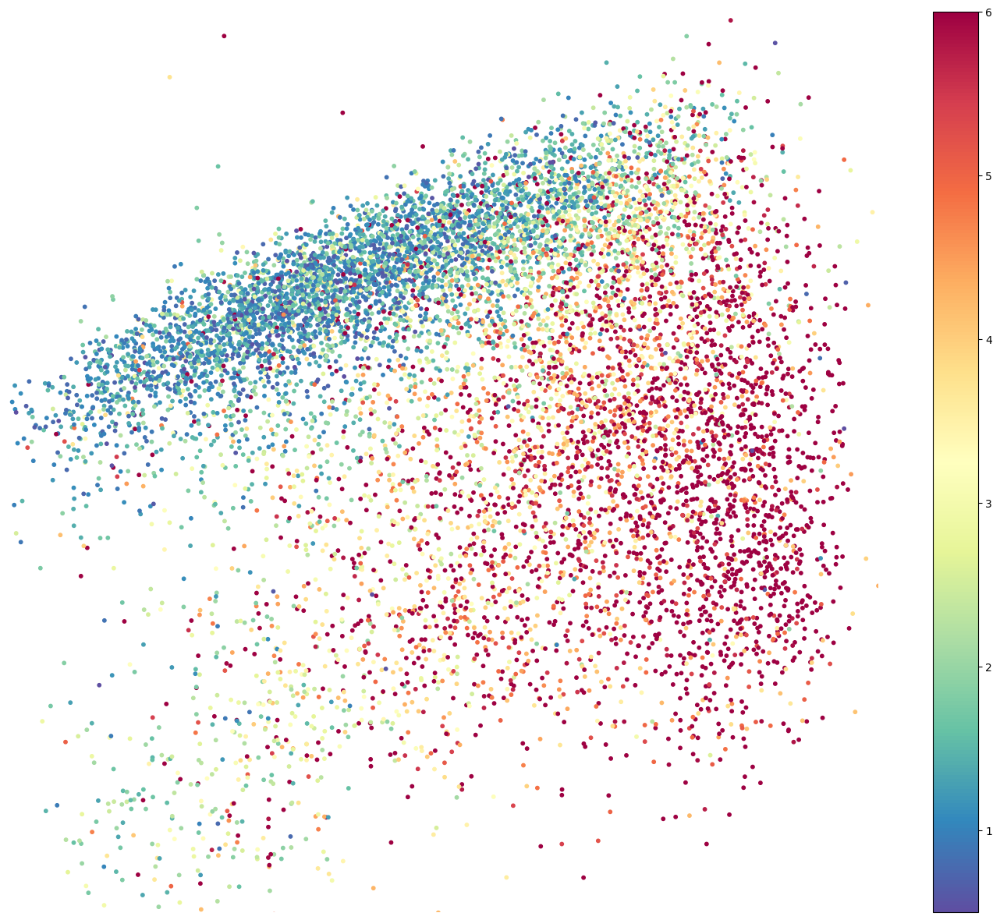

In [70]:
masses = np.array(manga_scalars['log_mstar'])
sfrs = np.array(manga_scalars['log_sfr'])
t50s = np.array(manga_scalars['t50_model'])
plt.figure(figsize=(18,15))
plt.scatter(masses, sfrs, c=manga_scalars['sersic_n'], cmap='Spectral_r',s=10)
plt.axis([9,12,-5,2])
plt.axis('off')
clbr = plt.colorbar(); #clbr.set_label('sersic n',fontsize=34);
plt.show()

In [103]:
mass_avgs = []
sfr_avgs = []
d4000_avgs = []
all_xax = []
sigma = 4.0
for i in tqdm(range(len(d_shapmass['shap_map_mass']))):
    try:
        temp = np.mean(ndimage.gaussian_filter(d_shapmass['shap_map_mass'][i]*1e4, sigma, mode='nearest'),2)
        mass_avgs.append(azimuthalAverage(temp))
        temp = np.mean(ndimage.gaussian_filter(d_shapsfr['shap_map_mass'][i]*1e4, sigma, mode='nearest'),2)
        sfr_avgs.append(azimuthalAverage(temp))
        temp = np.mean(ndimage.gaussian_filter(d_shapage['shap_map_mass'][i]*1e4, sigma, mode='nearest'),2)
        d4000_avgs.append(azimuthalAverage(temp))
        all_xax.append(get_xax(manga_scalars['redshift'][i]))
    except:
        mass_avgs.append(np.ones((179,))*np.nan)
        sfr_avgs.append(np.ones((179,))*np.nan)
        d4000_avgs.append(np.ones((179,))*np.nan)
        all_xax.append(np.ones((179,))*np.nan)
mass_avgs = np.array(mass_avgs)
sfr_avgs = np.array(sfr_avgs)
d4000_avgs = np.array(d4000_avgs)
all_xax = np.array(all_xax)

100%|██████████| 10081/10081 [09:26<00:00, 17.80it/s]


In [104]:
common_xax = np.arange(0,300,0.1)
mass_shap_interp = np.zeros((len(manga_scalars),len(common_xax)))
sfr_shap_interp = np.zeros((len(manga_scalars),len(common_xax)))
d4000_shap_interp = np.zeros((len(manga_scalars),len(common_xax)))
for i in tqdm(range(len(manga_scalars))):
    mass_shap_interp[i,0:] = np.interp(common_xax, all_xax[i],mass_avgs[i])
    sfr_shap_interp[i,0:] = np.interp(common_xax, all_xax[i],sfr_avgs[i])
    d4000_shap_interp[i,0:] = np.interp(common_xax, all_xax[i],d4000_avgs[i])

  0%|          | 0/10081 [00:00<?, ?it/s]

100%|██████████| 10081/10081 [00:00<00:00, 17165.46it/s]


In [ ]:
all_sfhs = []
all_times = []
for galid in tqdm(range(len(manga_scalars))):
    scaled_t50 = manga_scalars['t50_model'][galid] / 13.7
    if scaled_t50 > 1:
        scaled_t50 = 0.99
    sfh_tuple = [manga_scalars['log_mstar'][galid],manga_scalars['log_sfr'][galid],1,scaled_t50]
    sfh, timeax = db.tuple_to_sfh(sfh_tuple, manga_scalars['redshift'][galid])
    if (np.amax(timeax) != db.cosmo.age(manga_scalars['redshift'][galid]).value):
        print(np.amax(timeax), db.cosmo.age(manga_scalars['redshift'][galid]).value, sfh_tuple)
    all_sfhs.append(sfh)
    all_times.append(timeax)
    
all_sfhs = np.array(all_sfhs)
all_times = np.array(all_times)

In [ ]:
common_time = np.linspace(0,np.nanmax(all_times.ravel()), 100)
common_sfhs = np.zeros((len(common_time), len(manga_scalars)))
for galid in tqdm(range(len(manga_scalars))):
    common_sfhs[0:,galid] = np.interp(common_time, all_times[galid,0:], np.flip(all_sfhs[galid,0:],0))

In [138]:
plt.rcParams['font.size'] = 28

31


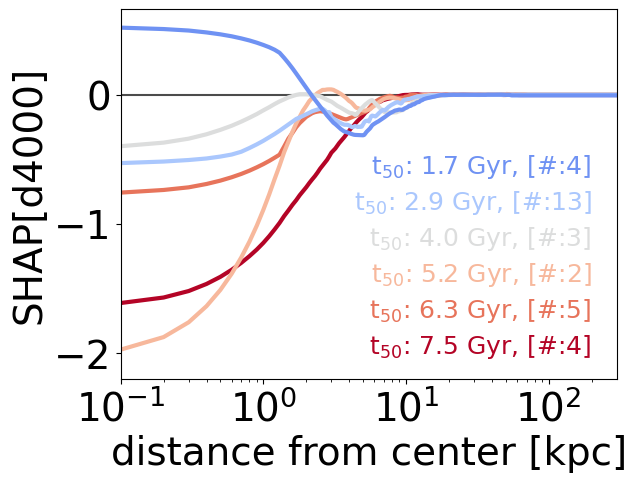

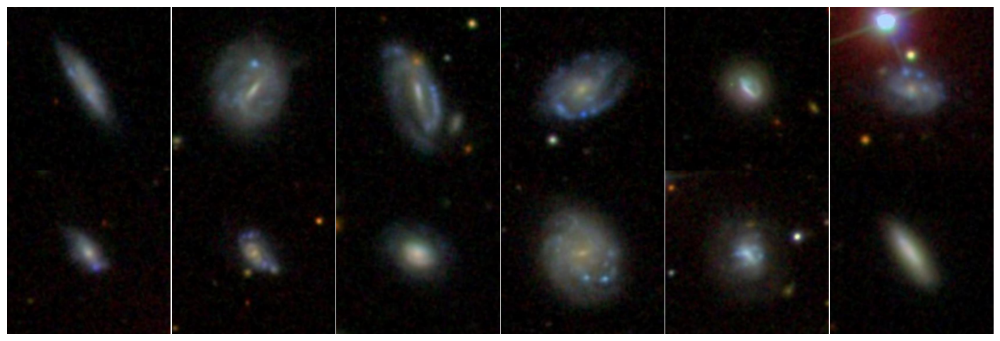

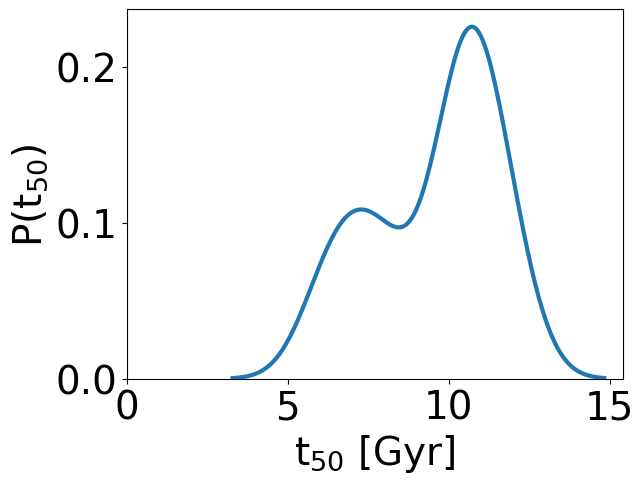

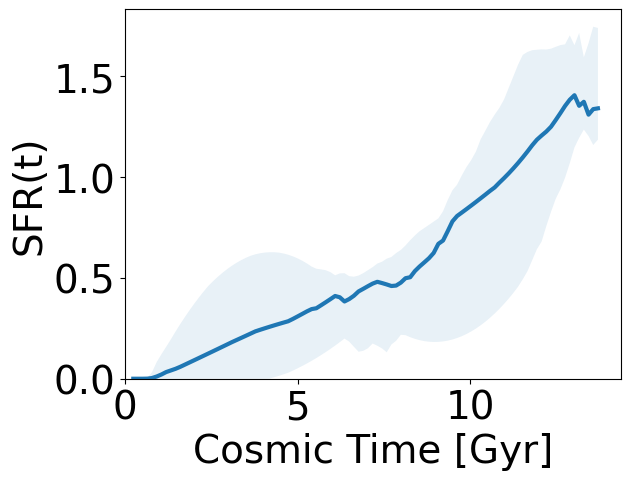

In [139]:
mbin = 9.7
mbw = 0.5
sbin = 0.3
sbw = 0.5

galmask = (np.abs(masses - mbin) < mbw/2) & (np.abs(sfrs - sbin) < sbw/2)
print(np.sum(galmask))
txbins = np.linspace(np.nanpercentile(t50s[galmask],2.5), np.nanpercentile(t50s[galmask],97.5),6)

plt.axhline(0,color='k',alpha=0.7)
for i in range(6):
    cval = cm.coolwarm_r(i/6)
    txmask = (galmask) & (np.abs(t50s - txbins[i]) < np.mean(np.diff(txbins))/2)
    plt.plot(common_xax, np.nanmedian(d4000_shap_interp[txmask,0:],0), 
             color=cval, lw=3)
    plt.text(2e2,i/3.6 - 2,'t$_{50}$: %.1f Gyr, [#:%.0f]' %(13.7-txbins[i], np.sum(txmask)), color=cval, ha='right',fontsize=18)
# plt.yscale('symlog'); 
plt.xscale('log'); plt.xlim(1e-1,np.amax(common_xax))
plt.xlabel('distance from center [kpc]')
plt.ylabel('SHAP[d4000]')
plt.show()


# plt.axhline(0,color='k',alpha=0.7)
# for i in range(6):
#     cval = cm.coolwarm_r(i/6)
#     txmask = (galmask) & (np.abs(t50s - txbins[i]) < np.mean(np.diff(txbins))/2)
#     plt.plot(common_xax, np.nanmedian(mass_shap_interp[txmask,0:],0), 
#              color=cval, lw=3)
#     plt.text(2e2,i/6 + 0.55,'t$_{50}$: %.1f Gyr, [#:%.0f]' %(13.7-txbins[i], np.sum(txmask)), color=cval, ha='right',fontsize=18)
# # plt.yscale('symlog'); 
# plt.xscale('log'); plt.xlim(1e-1,np.amax(common_xax))
# plt.xlabel('distance from center [kpc]',fontsize=18)
# plt.ylabel('SHAP[d4000]',fontsize=18)
# plt.show()


# plt.axhline(0,color='k',alpha=0.7)
# for i in range(6):
#     cval = cm.coolwarm_r(i/6)
#     txmask = (galmask) & (np.abs(t50s - txbins[i]) < np.mean(np.diff(txbins))/2)
#     plt.plot(common_xax, np.nanmedian(sfr_shap_interp[txmask,0:],0), 
#              color=cval, lw=3)
#     plt.text(2e2,i/2 + 0.55,'t$_{50}$: %.1f Gyr, [#:%.0f]' %(13.7-txbins[i], np.sum(txmask)), color=cval, ha='right',fontsize=18)
# # plt.yscale('symlog'); 
# plt.xscale('log'); plt.xlim(1e-1,np.amax(common_xax))
# plt.xlabel('distance from center [kpc]',fontsize=18)
# plt.ylabel('SHAP[d4000]',fontsize=18)
# plt.show()


plt.subplots(2,6,figsize=(18,6))
plt.subplots_adjust(hspace=0,wspace=0)
for i in range(12):
    plt.subplot(2,6,i+1)
    plt.imshow(d_im['images'][np.arange(len(galmask))[galmask][i]])
    plt.axis('off')
plt.show()
    
db.sns.kdeplot(t50s[galmask],lw=3)
plt.xlabel('t$_{50}$ [Gyr]')
plt.ylabel('P(t$_{50}$)')
plt.xlim(0,)
plt.show()

plt.plot(np.abs(13.7-common_time), np.nanmedian(common_sfhs[0:,galmask],1),lw=3)
plt.fill_between(np.abs(13.7-common_time), np.nanpercentile(common_sfhs[0:,galmask],16,1),
                 np.nanpercentile(common_sfhs[0:,galmask],84,1),lw=3,alpha=0.1)
plt.xlabel('Cosmic Time [Gyr]'); plt.xlim(0,); plt.ylim(0,)
plt.ylabel('SFR(t)')
plt.show()


353


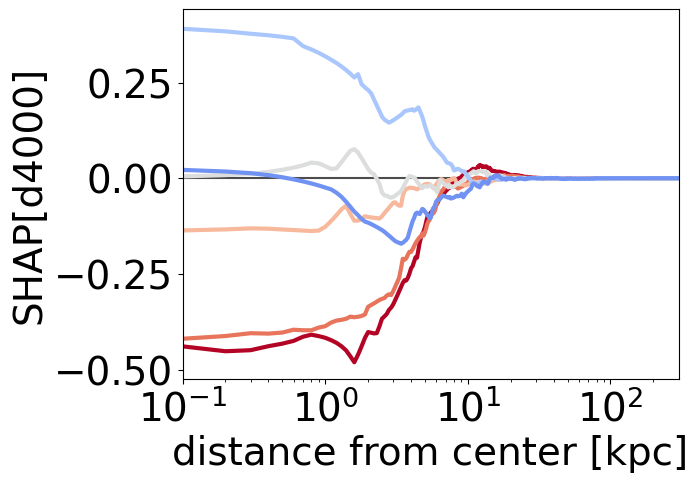

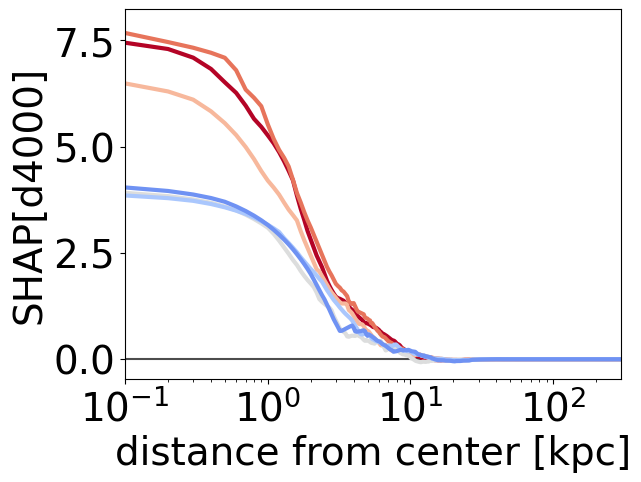

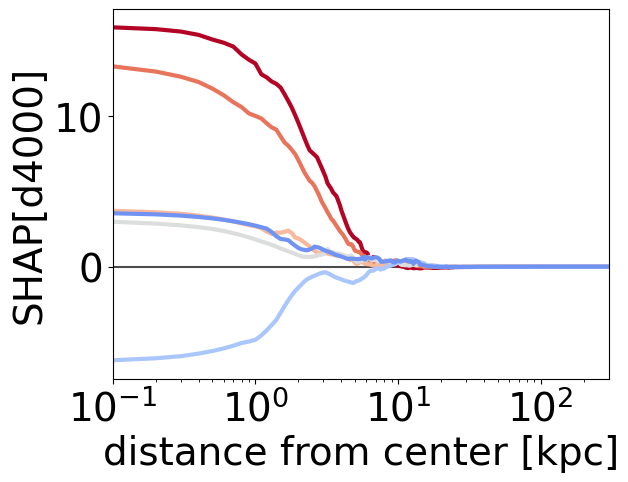

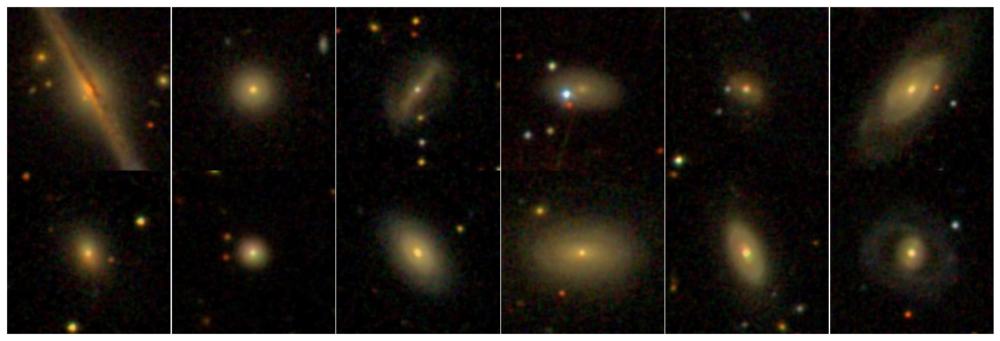

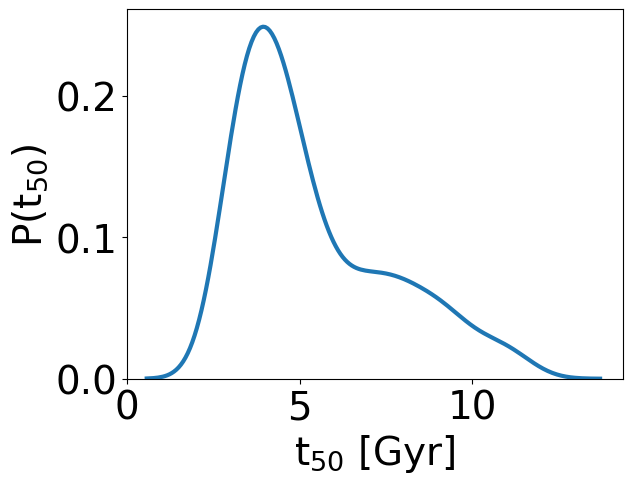

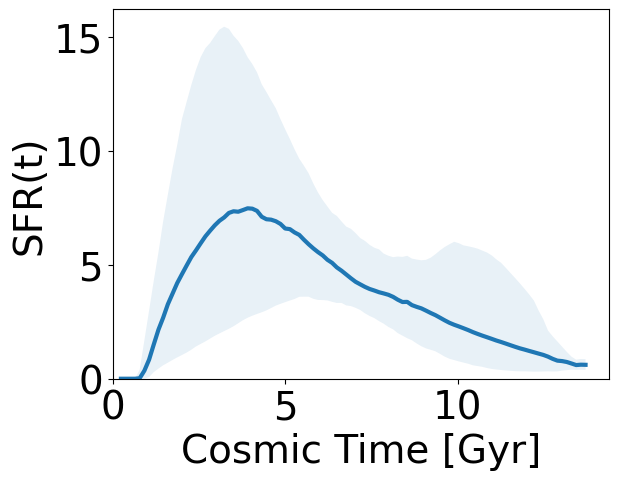

In [140]:
mbin = 10.75
mbw = 0.5
sbin = -0.25
sbw = 0.5

galmask = (np.abs(masses - mbin) < mbw/2) & (np.abs(sfrs - sbin) < sbw/2)
print(np.sum(galmask))
txbins = np.linspace(np.nanpercentile(t50s[galmask],2.5), np.nanpercentile(t50s[galmask],97.5),6)

plt.axhline(0,color='k',alpha=0.7)
for i in range(6):
    cval = cm.coolwarm_r(i/6)
    txmask = (galmask) & (np.abs(t50s - txbins[i]) < np.mean(np.diff(txbins))/2)
    plt.plot(common_xax, np.nanmedian(d4000_shap_interp[txmask,0:],0), 
             color=cval, lw=3)
#     plt.text(2e2,i/10 - 0.2,'t$_{50}$: %.1f Gyr, [#:%.0f]' %(13.7-txbins[i], np.sum(txmask)), color=cval, ha='right',fontsize=18)
# plt.yscale('symlog'); 
plt.xscale('log'); plt.xlim(1e-1,np.amax(common_xax))
plt.xlabel('distance from center [kpc]')
plt.ylabel('SHAP[d4000]')
plt.show()


plt.axhline(0,color='k',alpha=0.7)
for i in range(6):
    cval = cm.coolwarm_r(i/6)
    txmask = (galmask) & (np.abs(t50s - txbins[i]) < np.mean(np.diff(txbins))/2)
    plt.plot(common_xax, np.nanmedian(mass_shap_interp[txmask,0:],0), 
             color=cval, lw=3)
#     plt.text(2e2,i/6 + 0.55,'t$_{50}$: %.1f Gyr, [#:%.0f]' %(13.7-txbins[i], np.sum(txmask)), color=cval, ha='right',fontsize=18)
# plt.yscale('symlog'); 
plt.xscale('log'); plt.xlim(1e-1,np.amax(common_xax))
plt.xlabel('distance from center [kpc]')
plt.ylabel('SHAP[d4000]')
plt.show()


plt.axhline(0,color='k',alpha=0.7)
for i in range(6):
    cval = cm.coolwarm_r(i/6)
    txmask = (galmask) & (np.abs(t50s - txbins[i]) < np.mean(np.diff(txbins))/2)
    plt.plot(common_xax, np.nanmedian(sfr_shap_interp[txmask,0:],0), 
             color=cval, lw=3)
#     plt.text(2e2,i/6 + 0.55,'t$_{50}$: %.1f Gyr, [#:%.0f]' %(13.7-txbins[i], np.sum(txmask)), color=cval, ha='right',fontsize=18)
# plt.yscale('symlog'); 
plt.xscale('log'); plt.xlim(1e-1,np.amax(common_xax))
plt.xlabel('distance from center [kpc]')
plt.ylabel('SHAP[d4000]')
plt.show()


plt.subplots(2,6,figsize=(18,6))
plt.subplots_adjust(hspace=0,wspace=0)
for i in range(12):
    plt.subplot(2,6,i+1)
    plt.imshow(d_im['images'][np.arange(len(galmask))[galmask][i]])
    plt.axis('off')
plt.show()
    
db.sns.kdeplot(t50s[galmask],lw=3)
plt.xlabel('t$_{50}$ [Gyr]')
plt.ylabel('P(t$_{50}$)')
plt.xlim(0,)
plt.show()

plt.plot(np.abs(13.7-common_time), np.nanmedian(common_sfhs[0:,galmask],1),lw=3)
plt.fill_between(np.abs(13.7-common_time), np.nanpercentile(common_sfhs[0:,galmask],16,1),
                 np.nanpercentile(common_sfhs[0:,galmask],84,1),lw=3,alpha=0.1)
plt.xlabel('Cosmic Time [Gyr]'); plt.xlim(0,); plt.ylim(0,)
plt.ylabel('SFR(t)')
plt.show()



433


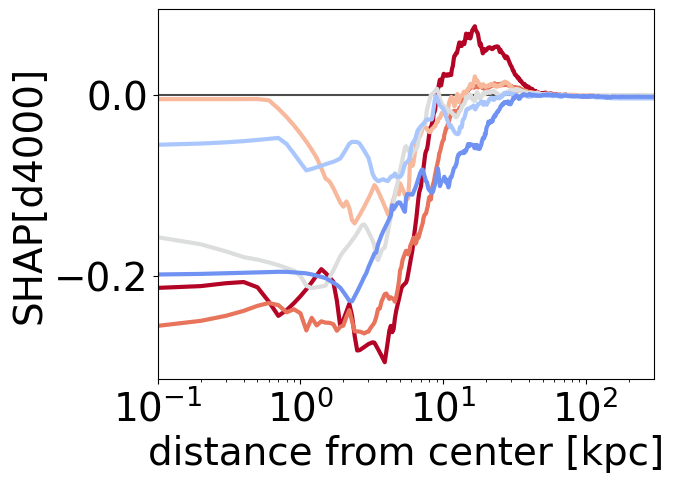

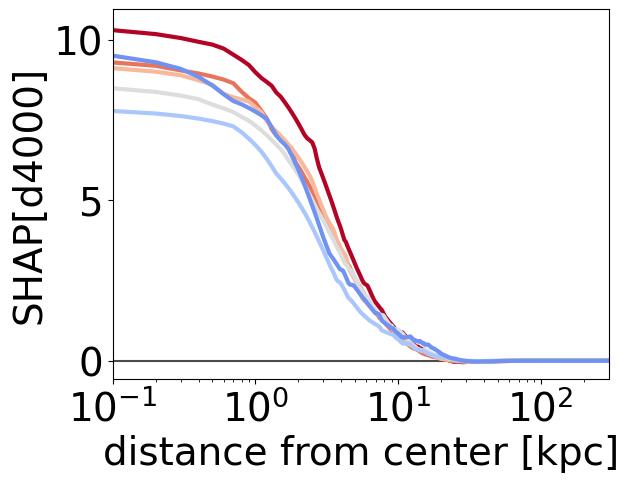

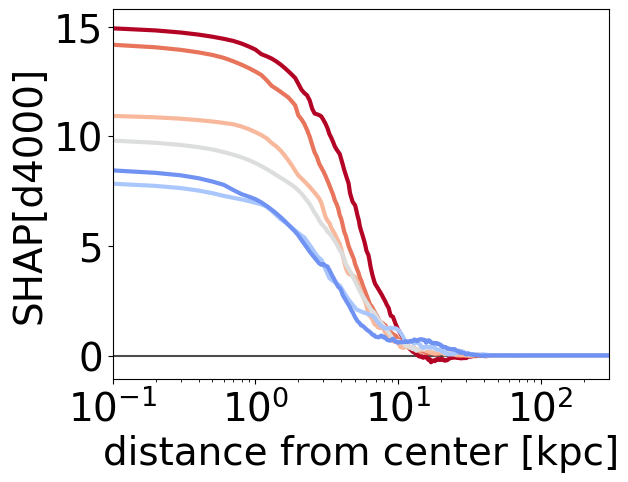

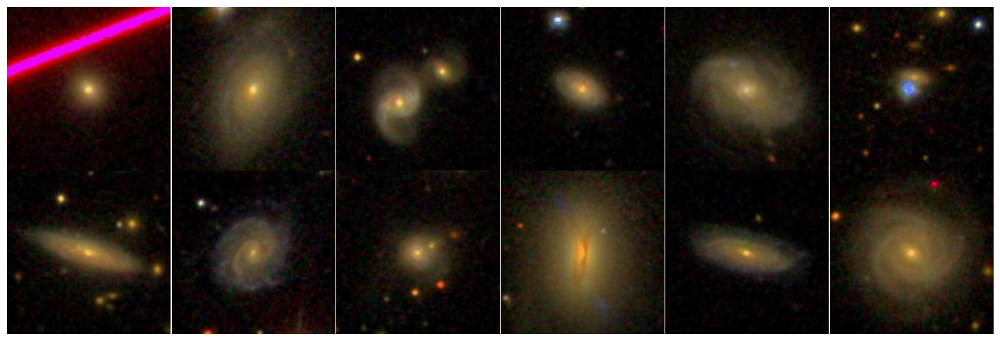

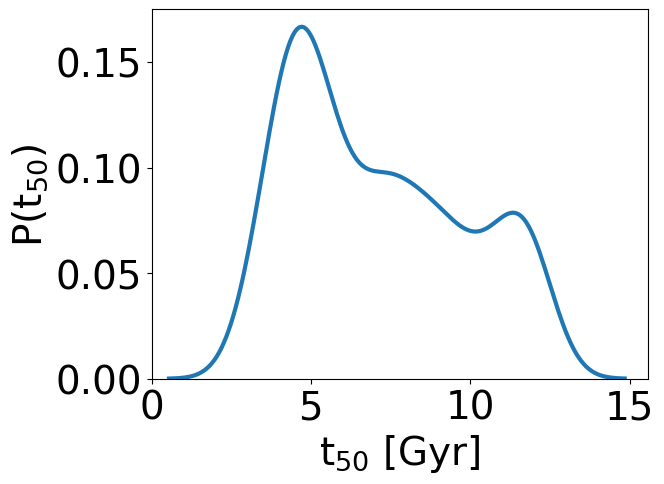

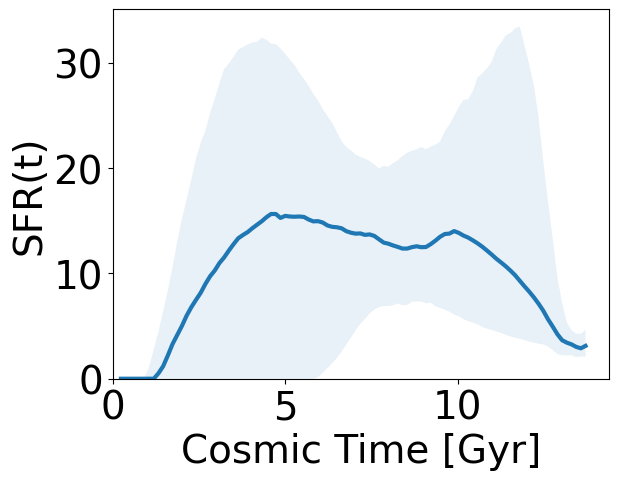

In [142]:
mbin = 11.25
mbw = 0.5
sbin = 0.5
sbw = 0.5

galmask = (np.abs(masses - mbin) < mbw/2) & (np.abs(sfrs - sbin) < sbw/2)
print(np.sum(galmask))
txbins = np.linspace(np.nanpercentile(t50s[galmask],2.5), np.nanpercentile(t50s[galmask],97.5),6)

plt.axhline(0,color='k',alpha=0.7)
for i in range(6):
    cval = cm.coolwarm_r(i/6)
    txmask = (galmask) & (np.abs(t50s - txbins[i]) < np.mean(np.diff(txbins))/2)
    plt.plot(common_xax, np.nanmedian(d4000_shap_interp[txmask,0:],0), 
             color=cval, lw=3)
#     plt.text(2e2,i/10 - 0.2,'t$_{50}$: %.1f Gyr, [#:%.0f]' %(13.7-txbins[i], np.sum(txmask)), color=cval, ha='right',fontsize=18)
# plt.yscale('symlog'); 
plt.xscale('log'); plt.xlim(1e-1,np.amax(common_xax))
plt.xlabel('distance from center [kpc]')
plt.ylabel('SHAP[d4000]')
plt.show()


plt.axhline(0,color='k',alpha=0.7)
for i in range(6):
    cval = cm.coolwarm_r(i/6)
    txmask = (galmask) & (np.abs(t50s - txbins[i]) < np.mean(np.diff(txbins))/2)
    plt.plot(common_xax, np.nanmedian(mass_shap_interp[txmask,0:],0), 
             color=cval, lw=3)
#     plt.text(2e2,i/6 + 0.55,'t$_{50}$: %.1f Gyr, [#:%.0f]' %(13.7-txbins[i], np.sum(txmask)), color=cval, ha='right',fontsize=18)
# plt.yscale('symlog'); 
plt.xscale('log'); plt.xlim(1e-1,np.amax(common_xax))
plt.xlabel('distance from center [kpc]')
plt.ylabel('SHAP[d4000]')
plt.show()


plt.axhline(0,color='k',alpha=0.7)
for i in range(6):
    cval = cm.coolwarm_r(i/6)
    txmask = (galmask) & (np.abs(t50s - txbins[i]) < np.mean(np.diff(txbins))/2)
    plt.plot(common_xax, np.nanmedian(sfr_shap_interp[txmask,0:],0), 
             color=cval, lw=3)
#     plt.text(2e2,i/6 + 0.55,'t$_{50}$: %.1f Gyr, [#:%.0f]' %(13.7-txbins[i], np.sum(txmask)), color=cval, ha='right',fontsize=18)
# plt.yscale('symlog'); 
plt.xscale('log'); plt.xlim(1e-1,np.amax(common_xax))
plt.xlabel('distance from center [kpc]')
plt.ylabel('SHAP[d4000]')
plt.show()


plt.subplots(2,6,figsize=(18,6))
plt.subplots_adjust(hspace=0,wspace=0)
for i in range(12):
    plt.subplot(2,6,i+1)
    plt.imshow(d_im['images'][np.arange(len(galmask))[galmask][i]])
    plt.axis('off')
plt.show()
    
db.sns.kdeplot(t50s[galmask],lw=3)
plt.xlabel('t$_{50}$ [Gyr]')
plt.ylabel('P(t$_{50}$)')
plt.xlim(0,)
plt.show()

plt.plot(np.abs(13.7-common_time), np.nanmedian(common_sfhs[0:,galmask],1),lw=3)
plt.fill_between(np.abs(13.7-common_time), np.nanpercentile(common_sfhs[0:,galmask],16,1),
                 np.nanpercentile(common_sfhs[0:,galmask],84,1),lw=3,alpha=0.1)
plt.xlabel('Cosmic Time [Gyr]'); plt.xlim(0,); plt.ylim(0,)
plt.ylabel('SFR(t)')
plt.show()



120


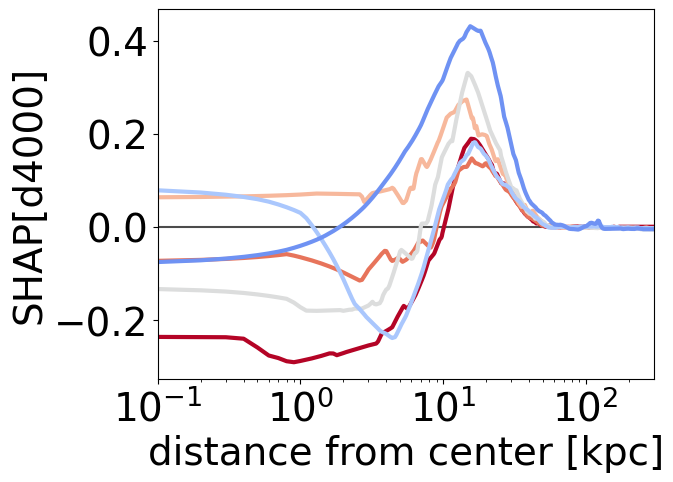

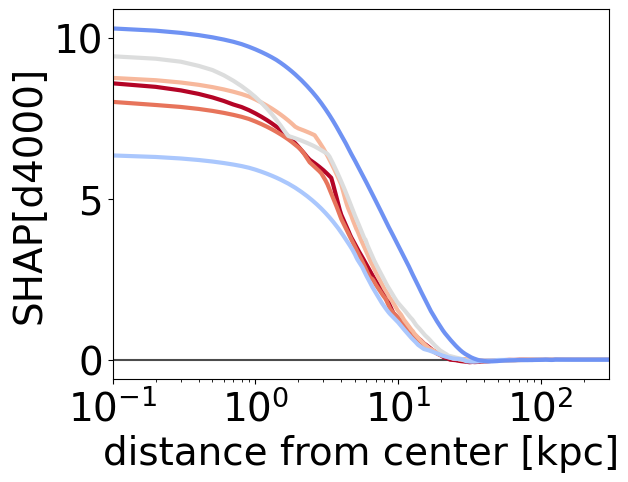

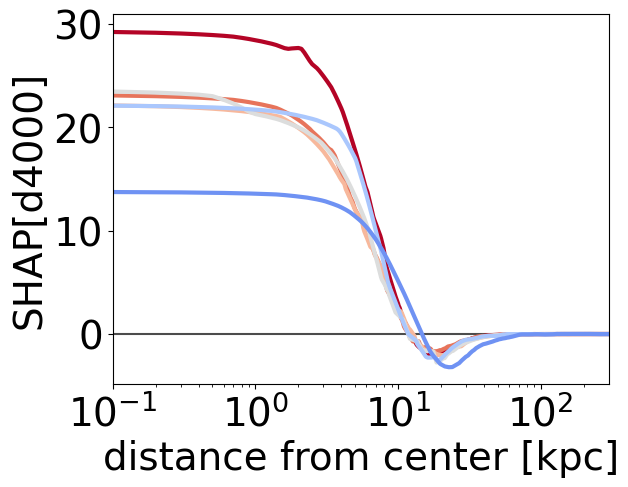

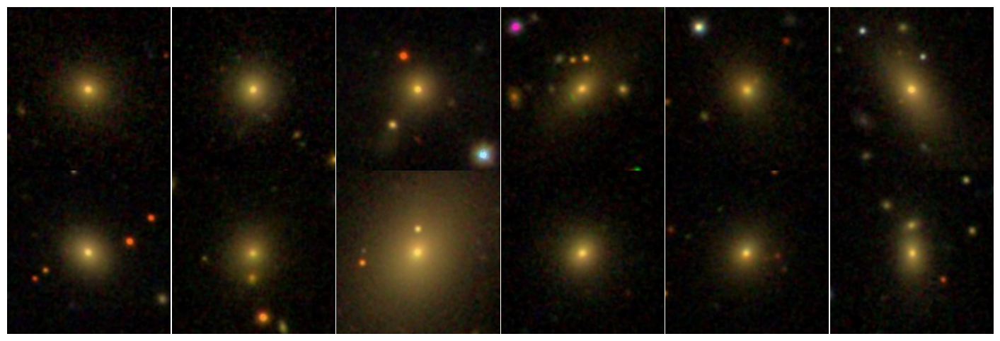

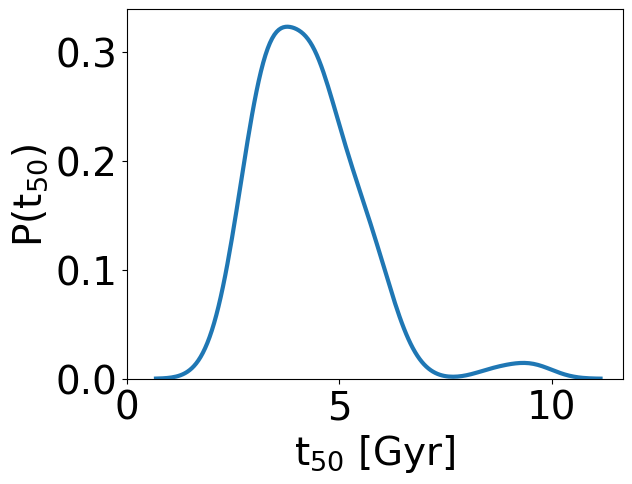

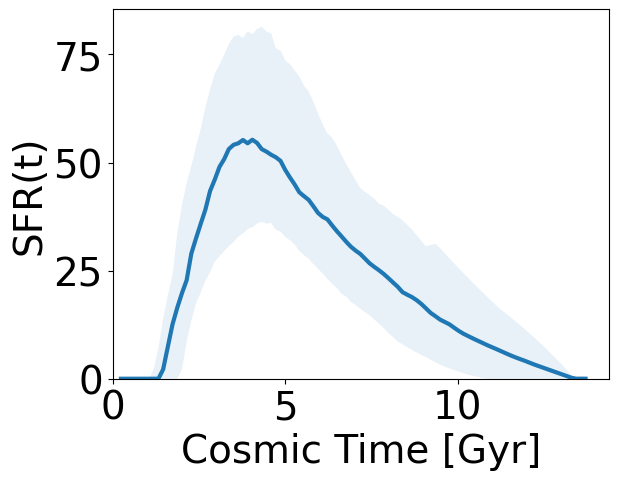

In [143]:
mbin = 11.5
mbw = 0.5
sbin = -3
sbw = 0.5

galmask = (np.abs(masses - mbin) < mbw/2) & (np.abs(sfrs - sbin) < sbw/2)
print(np.sum(galmask))
txbins = np.linspace(np.nanpercentile(t50s[galmask],2.5), np.nanpercentile(t50s[galmask],97.5),6)

plt.axhline(0,color='k',alpha=0.7)
for i in range(6):
    cval = cm.coolwarm_r(i/6)
    txmask = (galmask) & (np.abs(t50s - txbins[i]) < np.mean(np.diff(txbins))/2)
    plt.plot(common_xax, np.nanmedian(d4000_shap_interp[txmask,0:],0), 
             color=cval, lw=3)
#     plt.text(2e2,i/10 - 0.2,'t$_{50}$: %.1f Gyr, [#:%.0f]' %(13.7-txbins[i], np.sum(txmask)), color=cval, ha='right',fontsize=18)
# plt.yscale('symlog'); 
plt.xscale('log'); plt.xlim(1e-1,np.amax(common_xax))
plt.xlabel('distance from center [kpc]')
plt.ylabel('SHAP[d4000]')
plt.show()


plt.axhline(0,color='k',alpha=0.7)
for i in range(6):
    cval = cm.coolwarm_r(i/6)
    txmask = (galmask) & (np.abs(t50s - txbins[i]) < np.mean(np.diff(txbins))/2)
    plt.plot(common_xax, np.nanmedian(mass_shap_interp[txmask,0:],0), 
             color=cval, lw=3)
#     plt.text(2e2,i/6 + 0.55,'t$_{50}$: %.1f Gyr, [#:%.0f]' %(13.7-txbins[i], np.sum(txmask)), color=cval, ha='right',fontsize=18)
# plt.yscale('symlog'); 
plt.xscale('log'); plt.xlim(1e-1,np.amax(common_xax))
plt.xlabel('distance from center [kpc]')
plt.ylabel('SHAP[d4000]')
plt.show()


plt.axhline(0,color='k',alpha=0.7)
for i in range(6):
    cval = cm.coolwarm_r(i/6)
    txmask = (galmask) & (np.abs(t50s - txbins[i]) < np.mean(np.diff(txbins))/2)
    plt.plot(common_xax, np.nanmedian(sfr_shap_interp[txmask,0:],0), 
             color=cval, lw=3)
#     plt.text(2e2,i/6 + 0.55,'t$_{50}$: %.1f Gyr, [#:%.0f]' %(13.7-txbins[i], np.sum(txmask)), color=cval, ha='right',fontsize=18)
# plt.yscale('symlog'); 
plt.xscale('log'); plt.xlim(1e-1,np.amax(common_xax))
plt.xlabel('distance from center [kpc]')
plt.ylabel('SHAP[d4000]')
plt.show()


plt.subplots(2,6,figsize=(18,6))
plt.subplots_adjust(hspace=0,wspace=0)
for i in range(12):
    plt.subplot(2,6,i+1)
    plt.imshow(d_im['images'][np.arange(len(galmask))[galmask][i]])
    plt.axis('off')
plt.show()
    
db.sns.kdeplot(t50s[galmask],lw=3)
plt.xlabel('t$_{50}$ [Gyr]')
plt.ylabel('P(t$_{50}$)')
plt.xlim(0,)
plt.show()

plt.plot(np.abs(13.7-common_time), np.nanmedian(common_sfhs[0:,galmask],1),lw=3)
plt.fill_between(np.abs(13.7-common_time), np.nanpercentile(common_sfhs[0:,galmask],16,1),
                 np.nanpercentile(common_sfhs[0:,galmask],84,1),lw=3,alpha=0.1)
plt.xlabel('Cosmic Time [Gyr]'); plt.xlim(0,); plt.ylim(0,)
plt.ylabel('SFR(t)')
plt.show()



# Figure 16

[ 0.   0.3  0.6  0.9  1.2  1.5  1.8  2.1  2.4  2.7  3.   3.3  3.6  3.9
  4.2  4.5  4.8  5.1  5.4  5.7  6.   6.3  6.6  6.9  7.2  7.5  7.8  8.1
  8.4  8.7  9.   9.3  9.6  9.9 10.2 10.5 10.8 11.1 11.4 11.7]
(0, 179)
(0, 179)
(0, 179)
(0, 179)
(0, 179)
(4, 179)
(69, 179)
(304, 179)
(738, 179)
(1135, 179)
(1444, 179)
(1579, 179)
(1591, 179)
(1527, 179)
(1328, 179)
(1133, 179)
(918, 179)
(719, 179)
(581, 179)
(476, 179)
(446, 179)
(429, 179)
(405, 179)
(370, 179)
(329, 179)
(296, 179)
(263, 179)
(223, 179)
(185, 179)
(153, 179)
(137, 179)
(123, 179)
(112, 179)
(99, 179)
(107, 179)
(111, 179)
(106, 179)
(76, 179)
(31, 179)
(16, 179)


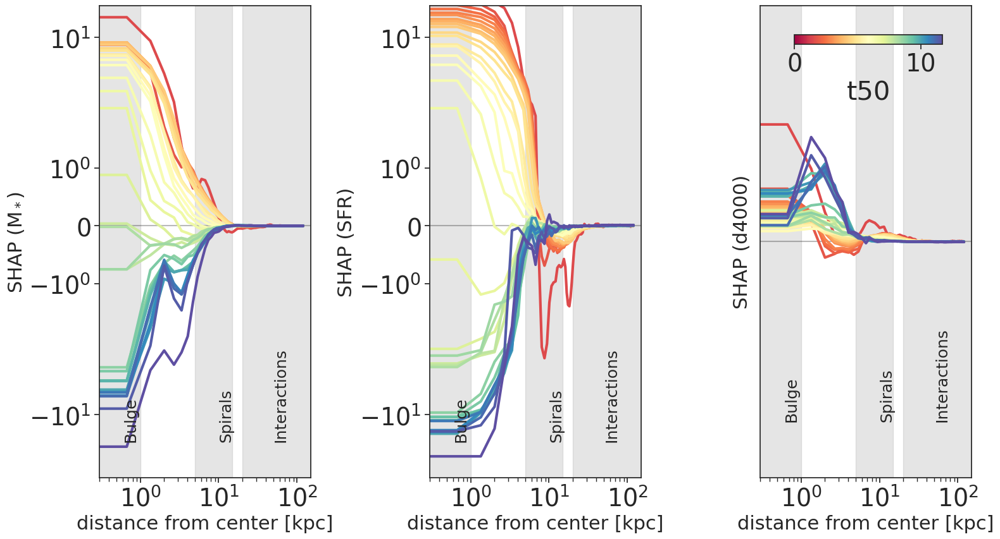

In [130]:
def make_radial_shapplot_quiescent(mv, massbins, clabel, 
                         zbin = 0.1, zbw = 0.1, mbw = 0.5,):
    print(massbins)
    zv = manga_scalars['redshift']
    colors = cm.Spectral(np.linspace(0,1,len(massbins)))

    fig, ax = plt.subplots(1,3, figsize=(16,9))
    plt.subplot(1,3,1)
    plt.axhline(0,color='k',alpha=0.3)
    plt.fill_between([0,1],-40,20,color='grey',alpha=0.2) #bulge 
    plt.text(0.6, -17, 'Bulge', rotation=90, fontsize=18)
    plt.fill_between([5,15],-40,20,color='grey',alpha=0.2) #spirals
    plt.text(10, -17, 'Spirals', rotation=90, fontsize=18)
    plt.fill_between([20,200],-40,20,color='grey',alpha=0.2) #interactions
    plt.text(50, -17, 'Interactions', rotation=90, fontsize=18)
    for i, mb in enumerate(massbins):
        mask = (np.abs(zv-zbin) < zbw) & (np.abs(mv-mb) < mbw) & (np.array(manga_scalars['log_sfr']-manga_scalars['log_mstar']) < -10.8)
        plt.plot(ref_array, np.nanmedian(mass_avgs_interp[mask,0:],0),lw=3, color=colors[i])
        print(np.shape(mass_avgs_interp[mask,0:]))
    plt.xscale('log')
    plt.yscale('symlog')
    plt.xlabel('distance from center [kpc]',fontsize=22); 
    plt.ylabel('SHAP (M$_*$)',fontsize=22)
    # plt.xlim(1e-1,0.4e2)
    plt.xlim(0.3,150)
    plt.ylim(-40,20)

    plt.subplot(1,3,2)
    plt.axhline(0,color='k',alpha=0.3)
    plt.fill_between([0,1],-40,20,color='grey',alpha=0.2) #bulge 
    plt.text(0.6, -17, 'Bulge', rotation=90, fontsize=18)
    plt.fill_between([5,15],-40,20,color='grey',alpha=0.2) #spirals
    plt.text(10, -17, 'Spirals', rotation=90, fontsize=18)
    plt.fill_between([20,200],-40,20,color='grey',alpha=0.2) #interactions
    plt.text(50, -17, 'Interactions', rotation=90, fontsize=18)
    for i, mb in enumerate(massbins):
        mask = (np.abs(zv-zbin) < zbw) & (np.abs(mv-mb) < mbw) & (np.array(manga_scalars['log_sfr']-manga_scalars['log_mstar']) < -10.8)
        plt.plot(ref_array, np.nanmedian(sfr_avgs_interp[mask,0:],0),lw=3, color=colors[i])
    plt.xscale('log')
    plt.yscale('symlog')
    plt.xlabel('distance from center [kpc]',fontsize=22); 
    plt.ylabel('SHAP (SFR)',fontsize=22)
    # plt.xlim(1e-1,0.4e2)
    plt.xlim(0.3,150)
    plt.ylim(-40,20)

    plt.subplot(1,3,3)
    plt.axhline(0,color='k',alpha=0.3)
    plt.fill_between([0,1],-2,2,color='grey',alpha=0.2) #bulge 
    plt.text(0.6, -1.5, 'Bulge', rotation=90, fontsize=18)
    plt.fill_between([5,15],-2,2,color='grey',alpha=0.2) #spirals
    plt.text(10, -1.5, 'Spirals', rotation=90, fontsize=18)
    plt.fill_between([20,200],-2,2,color='grey',alpha=0.2) #interactions
    plt.text(50, -1.5, 'Interactions', rotation=90, fontsize=18)
    for i, mb in enumerate(massbins):
        mask = (np.abs(zv-zbin) < zbw) & (np.abs(mv-mb) < mbw) & (np.array(manga_scalars['log_sfr']-manga_scalars['log_mstar']) < -10.8)
        plt.plot(ref_array, np.nanmedian(d4000_avgs_interp[mask,0:],0),lw=3, color=colors[i])
    plt.xscale('log')
    plt.yscale('symlog')
    plt.xlabel('distance from center [kpc]',fontsize=22); 
    plt.ylabel('SHAP (d4000)',fontsize=22)
    plt.xlim(0.3,150)
    plt.ylim(-2,2)
    ax[2].yaxis.set_major_formatter(FormatStrFormatter('%.2g'))

    # ----------------------------------------------------------
    im1 = plt.scatter(massbins*1000, np.zeros_like(massbins), c=massbins, cmap='Spectral')
    axins1 = inset_axes(
        ax[2],
        width="70%",  # width: 50% of parent_bbox width
        height="2%",  # height: 5%
        loc="upper right", borderpad=1.2
    )
    axins1.xaxis.set_ticks_position("both")
    clbr = fig.colorbar(im1, cax=axins1, orientation="horizontal")
    clbr.set_label(clabel)
    plt.tight_layout()
    plt.savefig('quiescent_radial_shap.pdf',dpi=300)
    plt.show()
    
make_radial_shapplot_quiescent(mv = np.array(manga_scalars['t50_model']), 
                     massbins = np.arange(0,12,0.3),
                     clabel = 't50')


In [ ]:
mask = (manga_scalars['log_sfr'] - manga_scalars['log_mstar']) < -10.8
t50mask = manga_scalars['t50_model'][mask]
idvals = np.arange(len(mask))[mask]

t50_vals = np.linspace(0,11,11)
t50args = []
for i in range(len(t50_vals)):
    tmp = idvals[np.argmin(np.abs(t50mask - t50_vals[i]))]
    t50args.append(tmp)

In [ ]:
plt.subplots(1,10,figsize=(16,9))
for i in range(len(t50args[1:])):
    plt.subplot(1,10,i+1)
    plt.imshow(d_im['images'][t50args[1:][i]])
    plt.text(5,25,'t50: '+ str(np.array(manga_scalars['t50_model'])[t50args[1:][i]])[:4]+' Gyrs',color='white',fontsize=10)
    plt.axis('off')
plt.tight_layout()
plt.savefig('quiescent_t50.pdf')    

# Figure 17

[0.  0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9 1. ]
(607, 179)
(21, 179)
(6, 179)
(8, 179)
(2, 179)
(3, 179)
(1, 179)
(2, 179)
(3, 179)
(1, 179)
(0, 179)


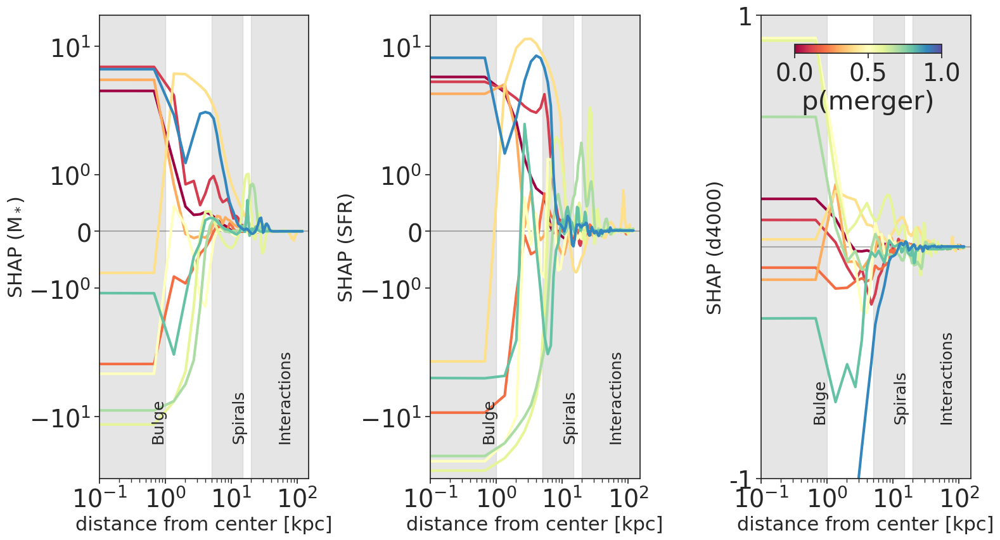

In [22]:
merger_clean = np.array(manga_scalars['p_merger'])
merger_clean = np.nan_to_num(merger_clean, nan=-1)
mask3 = np.where((merger_clean > 0.5))[0]

mask = merger_clean > 0
merger_mask = (manga_scalars['log_sfr'] - manga_scalars['log_mstar'])[mask]
idvals = np.arange(len(mask))[mask]

merger_vals = np.linspace(-17,-9.5,11)
mergerargs = []
for i in range(len(merger_vals)):
    tmp = idvals[np.argmin(np.abs(merger_mask - merger_vals[i]))]
    mergerargs.append(tmp)

plt.rcParams['font.size'] = 22
make_radial_shapplot_merger(mv = merger_clean, 
                     massbins = np.arange(0,1.1,0.1),
                     clabel = 'p(merger)',mbw = 0.01)


plt.savefig('merger_radial_shap.pdf')    

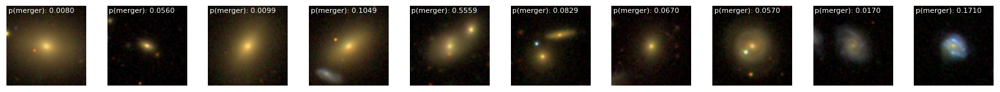

In [21]:
plt.subplots(1,10,figsize=(16,9))
for i in range(len(mergerargs[1:])):
    plt.subplot(1,10,i+1)
    plt.imshow(d_im['images'][mergerargs[1:][i]])
    # plt.text(5,20,'sSFR: '+ str(np.array(manga_scalars['log_sfr'] - manga_scalars['log_mstar'])[mergerargs[1:][i]])[:6],color='white',fontsize=8)
    plt.text(5,20,'p(merger): '+ str(np.array(manga_scalars['p_merger'])[mergerargs[1:][i]])[:6],color='white',fontsize=8)
    plt.axis('off')
plt.tight_layout()
# plt.savefig('merger_prob.pdf')

# Figure 18

In [ ]:
from scipy.signal import find_peaks
allmtimeax, allmsfh = np.zeros((len(manga_scalars),1000)), np.zeros((len(manga_scalars),1000))

for galid in db.tqdm(range(len(manga_scalars))):
    scaled_t50 = manga_scalars['t50_model'][galid] / 13.7
    sfh_tuple = [manga_scalars['log_mstar'][galid],manga_scalars['log_sfr'][galid],1,scaled_t50]
    sfh, timeax = db.tuple_to_sfh(sfh_tuple, manga_scalars['redshift'][galid])
    allmtimeax[galid,0:] = timeax
    allmsfh[galid,0:] = sfh

allpeaks = []
npeaks = np.zeros((len(manga_scalars),))
for galid in db.tqdm(range(len(manga_scalars))):
    temp = find_peaks(allmsfh[galid,0:]/np.amax(allmsfh[galid,0:]), height=0.6, distance=100)
    allpeaks.append(temp[0])
    npeaks[galid] = len(temp[0])

db.set_plot_style()

plt.figure(figsize=(9,7))
peakmask = (npeaks>1) & (manga_scalars['t50_model'] < 7)
plt.scatter(manga_scalars['log_mstar'],manga_scalars['log_sfr'],s=10,color='k',alpha=0.3)
plt.scatter(manga_scalars['log_mstar'][peakmask],manga_scalars['log_sfr'][peakmask],s=100,color='dodgerblue',alpha=0.7)
plt.axis([9,12,-4,2])
plt.xlabel(r'log$(M_*)[M_\odot]$'); plt.ylabel(r'log (SFR) [M$_\odot$ yr$^{-1}$]')
plt.show()


# Figure 19 

In [ ]:
model = models.resnet50()
model.fc= nn.Linear(2048, 1)
model = nn.DataParallel(model,device_ids=(0,1))
model_used = 'Manga_(DR17)_ResNet50_SFR'
# model_used = 'd4000'
model.load_state_dict(torch.load(work_dir+'models/'+model_used+'.pytorch'),strict=True)
model.to('cuda')
model.eval()

#Run images through the model and extract the predicitions

predictions_train =[]
predictions_test =[]

incomplete_batch_id_test=len(val_ids)-1

remainder_test=len(val_ids[incomplete_batch_id_test])

total_values_test=(len(val_ids)*batch_size)-(batch_size-remainder_test)

incomplete_batch_id_train=len(train_ids)-1

remainder_train=len(train_ids[incomplete_batch_id_train])

total_values_train=(len(train_ids)*batch_size)-(batch_size-remainder_train)


for batch_idx, temp in enumerate(train_loader):
    image = temp['image'].to('cuda')
    outputs = model(image).detach().cpu().numpy()
    if batch_idx<incomplete_batch_id_train:
        for j in range(batch_size):     
            predictions_train.append(outputs[j])
    else:
        for k in range(remainder_train):
            predictions_train.append(outputs[k])

for batch_idx, temp in enumerate(val_loader):
    image = temp['image'].to('cuda')
    outputs = model(image).detach().cpu().numpy()
    if batch_idx<incomplete_batch_id_test:
        for j in range(batch_size):     
            predictions_test.append(outputs[j])
    else:
        for k in range(remainder_test):
            predictions_test.append(outputs[k])

In [ ]:

predictions_train_sfr = predictions_train
predictions_test_sfr = predictions_test

outlier_index_train = np.where((np.array(predictions_train_sfr)>-6) & (np.array(predictions_train_sfr)<3))[0]
outlier_index_test = np.where(np.array(predictions_test_sfr)>-6)[0]

# outlier_index_train = np.arange(0,len(predictions_train_sfr))
# outlier_index_test = np.arange(0,len(predictions_test_sfr))

plt.figure(figsize=(21,9))
plt.subplot(1,2,1)
plt.title('Train Data Set')
plt.scatter(np.array(train_sfr_list)[outlier_index_train],np.array(predictions_train_sfr)[outlier_index_train],alpha=0.3)
plt.plot([-4,2],[-4,2],'k--')
plt.text(1,-4,'$R^2$ Train ='+str((r2_score(np.array(train_sfr_list)[outlier_index_train],np.array(predictions_train_sfr)[outlier_index_train])))[0:5],fontsize='small')
plt.text(1,-4.5,'MSE Train ='+str((mean_squared_error(np.array(train_sfr_list)[outlier_index_train],np.array(predictions_train_sfr)[outlier_index_train])))[0:5],fontsize='small')
plt.text(1,-5,'MAD Train ='+str((mean_absolute_error(np.array(train_sfr_list)[outlier_index_train],np.array(predictions_train_sfr)[outlier_index_train])))[0:5],fontsize='small')
plt.xlabel('True Values')
plt.ylabel('Predicted Values')
plt.subplot(1,2,2)
plt.title('Test Data Set')
plt.scatter(np.array(test_sfr_list)[outlier_index_test],np.array(predictions_test_sfr)[outlier_index_test],alpha=0.3,c='red')
plt.plot([-4,2],[-4,2],'k--')
plt.text(0,-3,'$R^2$ Test ='+str((r2_score(np.array(test_sfr_list)[outlier_index_test],np.array(predictions_test_sfr)[outlier_index_test])))[0:5],fontsize='small')
plt.text(0,-3.5,'MSE Test ='+str((mean_squared_error(np.array(test_sfr_list)[outlier_index_test],np.array(predictions_test_sfr)[outlier_index_test])))[0:5],fontsize='small')
plt.text(0,-4,'MAD Test ='+str((mean_absolute_error(np.array(test_sfr_list)[outlier_index_test],np.array(predictions_test_sfr)[outlier_index_test])))[0:5],fontsize='small')
plt.xlabel('True Values')
plt.ylabel('Predicted Values')

In [ ]:
model = models.resnet50()
model.fc= nn.Linear(2048, 1)
model = nn.DataParallel(model,device_ids=(0,1))
model_used = 'Manga_(DR17)_ResNet50_t50'
# model_used = 'd4000'
model.load_state_dict(torch.load(work_dir+'models/'+model_used+'.pytorch'),strict=True)
model.to('cuda')
model.eval()

#Run images through the model and extract the predicitions

predictions_train =[]
predictions_test =[]

incomplete_batch_id_test=len(val_ids)-1

remainder_test=len(val_ids[incomplete_batch_id_test])

total_values_test=(len(val_ids)*batch_size)-(batch_size-remainder_test)

incomplete_batch_id_train=len(train_ids)-1

remainder_train=len(train_ids[incomplete_batch_id_train])

total_values_train=(len(train_ids)*batch_size)-(batch_size-remainder_train)


for batch_idx, temp in enumerate(train_loader):
    image = temp['image'].to('cuda')
    outputs = model(image).detach().cpu().numpy()
    if batch_idx<incomplete_batch_id_train:
        for j in range(batch_size):     
            predictions_train.append(outputs[j])
    else:
        for k in range(remainder_train):
            predictions_train.append(outputs[k])

for batch_idx, temp in enumerate(val_loader):
    image = temp['image'].to('cuda')
    outputs = model(image).detach().cpu().numpy()
    if batch_idx<incomplete_batch_id_test:
        for j in range(batch_size):     
            predictions_test.append(outputs[j])
    else:
        for k in range(remainder_test):
            predictions_test.append(outputs[k])

In [ ]:
#Please note that due to old naming conventions the "t50 predictions" are actually the d4000 predictions

predictions_train_t50 = predictions_train
predictions_test_t50 = predictions_test


outlier_index_train = np.where(np.array(train_t50_list)<4)[0]

plt.figure(figsize=(21,9))
plt.subplot(1,2,1)
plt.title('Train Data Set')
plt.scatter(np.array(train_t50_list)[outlier_index_train],np.array(predictions_train_t50)[outlier_index_train],alpha=0.3)
plt.plot([0.6,2],[0.6,2],'k--')
# plt.ylim(top=2)
plt.text(1.6,0.8,'$R^2$ Train ='+str((r2_score(np.array(train_t50_list)[outlier_index_train],np.array(predictions_train_t50)[outlier_index_train])))[0:5],fontsize='small')
plt.text(1.59,0.7,'MSE Train ='+str((mean_squared_error(np.array(train_t50_list)[outlier_index_train],np.array(predictions_train_t50)[outlier_index_train])))[0:5],fontsize='small')
plt.text(1.59,0.6,'MAD Train ='+str((mean_absolute_error(np.array(train_t50_list)[outlier_index_train],np.array(predictions_train_t50)[outlier_index_train])))[0:5],fontsize='small')
plt.xlabel('True Values')
plt.ylabel('Predicted Values')
plt.subplot(1,2,2)
plt.title('Test Data Set')
plt.scatter(np.array(test_t50_list),predictions_test_t50,alpha=0.3,c='red')
plt.plot([1,2],[1,2],'k--')
plt.text(1.7,1.15,'$R^2$ Test ='+str((r2_score(np.array(test_t50_list),predictions_test_t50)))[0:5],fontsize='small')
plt.text(1.7,1.1,'MSE test ='+str((mean_squared_error(np.array(test_t50_list)[outlier_index_test],np.array(predictions_test_t50)[outlier_index_test])))[0:5],fontsize='small')
plt.text(1.7,1.05,'MAD test ='+str((mean_absolute_error(np.array(test_t50_list)[outlier_index_test],np.array(predictions_test_t50)[outlier_index_test])))[0:5],fontsize='small')
plt.xlabel('True Values')
plt.ylabel('Predicted Values')

# Figure 20

In [ ]:
mask = np.where((np.array(manga_scalars['log_mstar'])>8) & (np.array(manga_scalars['log_mstar'])<13) & (np.array(manga_scalars['t50_model'])<13))[0]
plt.rcParams.update({'font.size': 18})
plt.figure(figsize=(21,9))
plt.subplot(1,2,1)
plt.title('Model Predicitions of t50')
# plt.figure(figsize=(12,9))
plt.xlabel('log $M_*$ [$M_\odot$]')
plt.ylabel('log SFR $[M_\odot yr^{-1}]$')
plt.scatter(np.array(manga_scalars['log_mstar'])[mask],np.array(manga_scalars['log_sfr'])[mask],c=np.array(manga_scalars['t50_model'])[mask],cmap= 'viridis')
plt.colorbar(label='t50 in Cosmic Time [Gyr]')
# plt.savefig('/home/juanpabloalfonzo/Documents/Manga CNNs/manga_t50.pdf', bbox_inches='tight')
plt.subplot(1,2,2)
plt.title('PIPE3D t50 Values')
plt.xlabel('log $M_*$ [$M_\odot$]')
plt.ylabel('log SFR $[M_\odot yr^{-1}]$')
# plt.figure(figsize=(12,9))
plt.scatter(np.array(manga_scalars['log_mstar'])[mask],np.array(manga_scalars['log_sfr'])[mask],c=np.abs(np.array(manga_scalars['t50_Pipe3D'])[mask]-13.6),cmap= 'viridis')
plt.colorbar(label='t50 in Cosmic Time [Gyr]')
# plt.savefig('t50_comparison_ras.pdf', bbox_inches='tight',rasterized=True)

# Figure 21

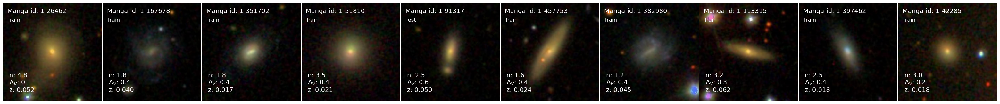

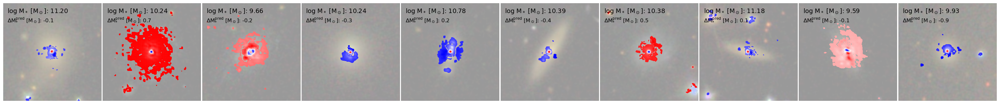

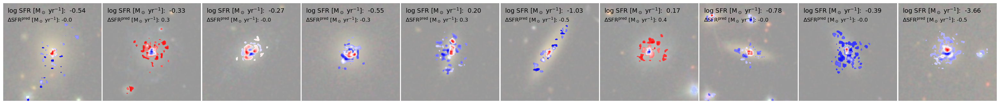

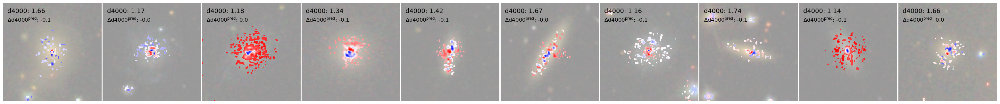

In [66]:
np.random.seed(123)
ids = np.array(np.random.randint(0,len(manga_scalars)+1,10))
sigmaval = 2.0
xim = 10
yim = 1


plot_images_maps(xim,yim, ids=ids, key='images', sigma=sigmaval)
plt.savefig('gal_images_random.pdf')
plot_images_maps(xim,yim, ids=ids, key='shap_mass', sigma=sigmaval)
plt.savefig('gal_shap_mass_random.pdf')
plot_images_maps(xim,yim, ids=ids, key='shap_sfr', sigma=sigmaval)
plt.savefig('gal_shap_sfr_random.pdf')
plot_images_maps(xim,yim, ids=ids, key='shap_age', sigma=sigmaval);
plt.savefig('gal_shap_age_random.pdf')

# Figure 22

In [ ]:
sfr_interest= [sfr_01, sfr_03, sfr_05, sfr_5, sfr_12]
mass_interest = [mass_01, mass_03, mass_05, mass_5, mass_12]
label_interest = ['0.1 Gyr Ago','0.3 Gyr Ago', '0.5 Gyr Ago', '5 Gyr Ago', '12 Gyr Ago']

j=0
k=0
plt.rcParams['font.size'] = 40
plt.subplots(3,5, figsize=(100,50))
for i in range(len(sfr_interest)*3):
    if i <5:
        mask = np.where((np.array(manga_scalars_clean_sfh['log_mstar'])<13) & (np.array(manga_scalars_clean_sfh['d4000'])<3) & (sfr_interest[i]>-4) & (sfr_interest[i]<4))[0]
        plt.subplot(3,5,i+1)
        plt.hexbin(mass_interest[i][mask], sfr_interest[i][mask],C=np.array(mass_gradients_sfh_clean)[mask],cmap= 'Spectral_r', vmin = -30, vmax=30,gridsize=20)
        plt.xlabel('log $M_*$ [M$_\odot$]')
        plt.ylabel('log SFR [M$_\odot$ yr$^{-1}$]')
        plt.title(label_interest[i])
        plt.colorbar(label='$M_*$ Gradient')

    elif i<10:
        mask = np.where((np.array(manga_scalars_clean_sfh['log_mstar'])<13) & (np.array(manga_scalars_clean_sfh['d4000'])<3) & (sfr_interest[j]>-4) & (sfr_interest[j]<4))[0]
        plt.subplot(3,5,i+1)
        plt.hexbin(mass_interest[j][mask], sfr_interest[j][mask],C=np.array(sfr_gradients_sfh_clean)[mask],cmap= 'Spectral_r', vmin = -40, vmax=40,gridsize=20)
        plt.xlabel('log $M_*$ [M$_\odot$]')
        plt.ylabel('log SFR [M$_\odot$ yr$^{-1}$]')
        # plt.title(label_interest[j])
        plt.colorbar(label='SFR Gradient')
        j=j+1
    
    elif i < 15:
        mask = np.where((np.array(manga_scalars_clean_sfh['log_mstar'])<13) & (np.array(manga_scalars_clean_sfh['d4000'])<3) & (sfr_interest[k]>-4) & (sfr_interest[k]<4))[0]
        plt.subplot(3,5,i+1)
        plt.hexbin(mass_interest[k][mask], sfr_interest[k][mask],C=np.array(d4000_gradients_sfh_clean)[mask],cmap= 'Spectral_r', vmin = -2, vmax=2,gridsize=20)
        plt.xlabel('log $M_*$ [M$_\odot$]')
        plt.ylabel('log SFR [M$_\odot$ yr$^{-1}$]')
        # plt.title(label_interest[k])
        plt.colorbar(label='D4000 Gradient')
        k=k+1
    

    plt.tight_layout()
    # plt.savefig('morph-sfh-extended.pdf')


# Figure 23

In [ ]:

mbins = np.arange(9,12.1,0.5)
sbins = np.flip(np.arange(-4,2.1,0.5),0) - 0.3
mbw = 0.5
sbw = 0.5
ctr = 0
ntxbins = 4
txbins = np.linspace(np.nanpercentile(t50s,2.5), np.nanpercentile(t50s,97.5),ntxbins)

plt.figure(figsize=(18,23))

for sbin in (sbins):
    for mbin in (mbins):
        ctr = ctr+1
        galmask = (np.abs(masses - mbin) < mbw/2) & (np.abs(sfrs - sbin) < sbw/2)
#         print(np.sum(galmask))
        if np.sum(galmask) > 10:
            plt.subplot((len(sbins)),(len(mbins)), ctr)
            plt.axhline(0,color='k',alpha=0.7)
            for i in range(ntxbins):
                cval = cm.coolwarm_r(i/(ntxbins-1))
                txmask = (galmask) & (np.abs(t50s - txbins[i]) < np.mean(np.diff(txbins))/2)
                if np.sum(txmask) > 5:
                    plt.plot(common_xax, np.nanmedian(d4000_shap_interp[txmask,:],0), 
                             color=cval, lw=np.log(np.sum(txmask)))
#                 plt.text(2e2,i/10 + 0.2,'t50: %.1f Gyr, [#:%.0f]' %(13.7-txbins[i], np.sum(txmask)), color=cval, ha='right')
            # plt.yscale('symlog'); 
            plt.xscale('log'); plt.xlim(1e-1,np.amax(common_xax))
            plt.title(r'log M$_*$: %.1f, log SFR:%.1f' %(mbin, sbin), fontsize=9)
#             plt.show()
            if ctr not in [57,86,87,88,82,90,77]:
                plt.xticks([])
            else:
                plt.xlabel('distance from center [kpc]')
            if ctr not in [12,18,24,30,37,43,50,57,65,72,79,86]:
                plt.yticks([])
            else:
                plt.ylabel('SHAP [d4000]')
                
plt.show()

# Figure 24

In [174]:
av_clean = np.array(manga_scalars['Av'])
av_clean = np.nan_to_num(av_clean, nan=-1)


mask = av_clean > 0
av_mask = av_clean[mask]
idvals = np.arange(len(mask))[mask]

av_vals = np.linspace(0,1.8,11)
avargs = []
for i in range(len(av_vals)):
    tmp = idvals[np.argmin(np.abs(av_mask - av_vals[i]))]
    avargs.append(tmp)

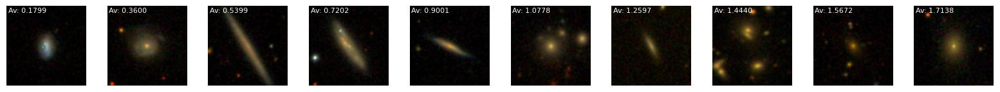

In [196]:
plt.subplots(1,10,figsize=(16,9))
for i in range(len(avargs[1:])):
    plt.subplot(1,10,i+1)
    plt.imshow(d_im['images'][avargs[1:][i]])
    plt.text(5,20,'Av: '+ str(np.array(manga_scalars['Av'])[avargs[1:][i]])[:6],color='white',fontsize=8)
    plt.axis('off')
plt.tight_layout()
# plt.savefig('av_galaxies.pdf')

[0.  0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9 1.  1.1 1.2 1.3 1.4 1.5 1.6 1.7
 1.8 1.9]
(7953, 179)
(8579, 179)
(8995, 179)
(9266, 179)
(9428, 179)
(9510, 179)
(8606, 179)
(6038, 179)
(4138, 179)
(2679, 179)
(1696, 179)
(1074, 179)
(658, 179)
(388, 179)
(226, 179)
(144, 179)
(83, 179)
(57, 179)
(26, 179)
(14, 179)


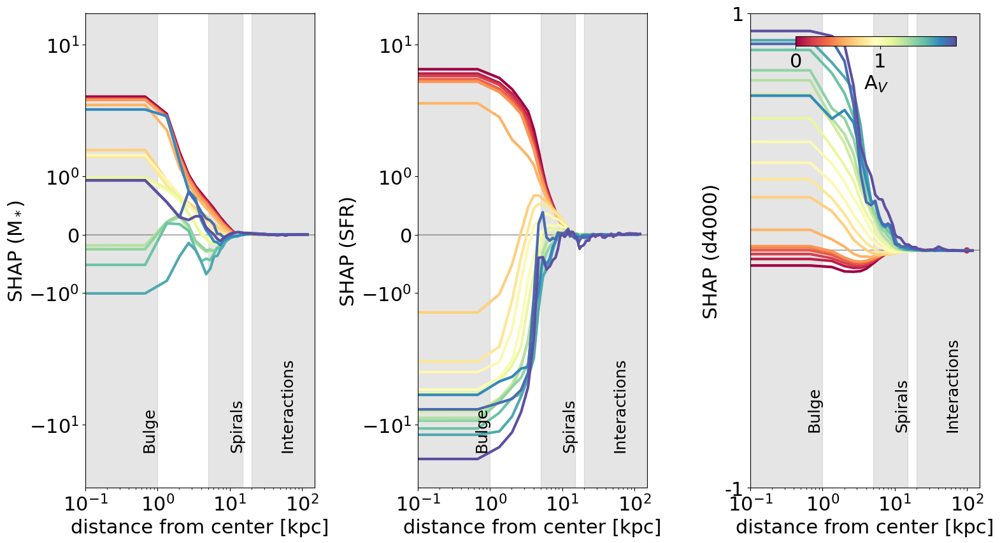

In [197]:
plt.rcParams['font.size'] = 22
make_radial_shapplot_merger(mv = manga_scalars['Av'], 
                     massbins = np.arange(0., 2.0,0.1),
                     clabel = 'A$_V$')

# plt.savefig('av_radial_shap.pdf')

# Figure 25

In [194]:
z_clean = np.array(manga_scalars['Z'])
z_clean = np.nan_to_num(z_clean, nan=-15)


mask = z_clean > -10
z_mask = z_clean[mask]
idvals = np.arange(len(mask))[mask]

z_vals = np.linspace(-2,0.5,11)
zargs = []
for i in range(len(z_vals)):
    tmp = idvals[np.argmin(np.abs(z_mask - z_vals[i]))]
    zargs.append(tmp)

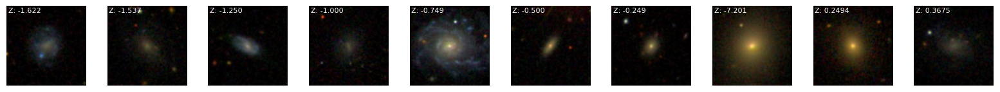

In [198]:
plt.subplots(1,10,figsize=(16,9))
for i in range(len(zargs[1:])):
    plt.subplot(1,10,i+1)
    plt.imshow(d_im['images'][zargs[1:][i]])
    plt.text(5,20,'Z: '+ str(np.array(manga_scalars['Z'])[zargs[1:][i]])[:6],color='white',fontsize=8)
    plt.axis('off')
plt.tight_layout()
# plt.savefig('z_galaxies.pdf')

[-1.5 -1.3 -1.1 -0.9 -0.7 -0.5 -0.3 -0.1  0.1]
(327, 179)
(766, 179)
(1462, 179)
(2397, 179)
(3960, 179)
(7226, 179)
(9168, 179)
(8488, 179)
(7541, 179)


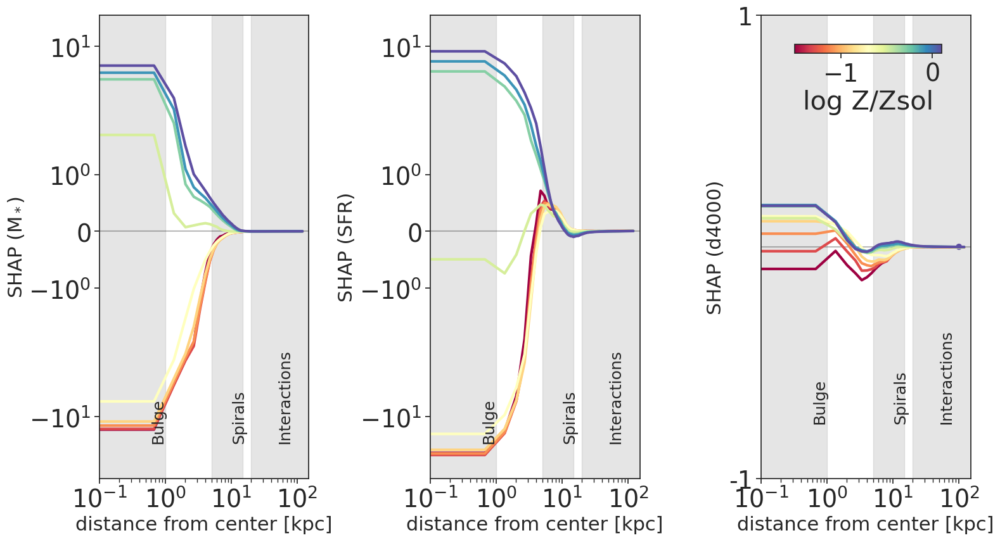

In [61]:
plt.rcParams['font.size'] = 22
make_radial_shapplot_merger(mv = manga_scalars['Z'], 
                     massbins = np.arange(-1.5,0.3,0.2),
                     clabel = 'log Z/Zsol')

# plt.savefig('z_radial_shap.pdf')

# EXTRA

Face on vs Edge on and Effective Radius

In [59]:
from astropy.io import fits
data = fits.open('/home/juanpabloalfonzo/Documents/Manga CNNs/SDSS17Pipe3D_v3_1_1.fits')
table = data[1]

manga_id = []
er= []

for i in range(len(table.data)):
    manga_id.append(table.data[i][4])
    er.append(table.data[i][9])

#Cleaning out repeat IDs 
manga_id_unique, unique_index = np.unique(manga_id, return_index=True)

manga_id = np.array(manga_id,dtype=str)[unique_index]

er = np.array(er)[unique_index]
# np.save('er.npy',er)

In [116]:
def make_radial_shapplot_edge_on(mv, massbins, clabel, 
                         zbin = 0.1, zbw = 0.1, mbw = 0.5,):
    print(massbins)
    zv = manga_scalars['redshift']
    colors = cm.Spectral(np.linspace(0,1,len(massbins)))
    fig, ax = plt.subplots(1,3, figsize=(16,9))
    fig.suptitle("Edge-on Galaxies")
    plt.subplot(1,3,1)
    plt.axhline(0,color='k',alpha=0.3)
    plt.fill_between([0,1],-40,20,color='grey',alpha=0.2) #bulge 
    plt.text(0.6, -17, 'Bulge', rotation=90, fontsize=18)
    plt.fill_between([5,15],-40,20,color='grey',alpha=0.2) #spirals
    plt.text(10, -17, 'Spirals', rotation=90, fontsize=18)
    plt.fill_between([20,200],-40,20,color='grey',alpha=0.2) #interactions
    plt.text(50, -17, 'Interactions', rotation=90, fontsize=18)
    for i, mb in enumerate(massbins):
        mask = ((np.abs(zv-zbin) < zbw) & (np.abs(mv-mb) < mbw) & (er>0) & (er<30) & (np.array(manga_scalars['edge_on'])<0.8))
        plt.plot(ref_array, np.nanmedian(mass_avgs_interp[mask,0:],0),lw=3, color=colors[i])
        print(np.shape(mass_avgs_interp[mask,0:]))
    plt.xscale('log')
    plt.yscale('symlog')
    plt.xlabel('distance from center [kpc]',fontsize=22); 
    plt.ylabel('SHAP (M$_*$)',fontsize=22)
    # plt.xlim(1e-1,0.4e2)
    plt.xlim(0.3,150)
    plt.ylim(-40,20)

    plt.subplot(1,3,2)
    plt.axhline(0,color='k',alpha=0.3)
    plt.fill_between([0,1],-40,20,color='grey',alpha=0.2) #bulge 
    plt.text(0.6, -17, 'Bulge', rotation=90, fontsize=18)
    plt.fill_between([5,15],-40,20,color='grey',alpha=0.2) #spirals
    plt.text(10, -17, 'Spirals', rotation=90, fontsize=18)
    plt.fill_between([20,200],-40,20,color='grey',alpha=0.2) #interactions
    plt.text(50, -17, 'Interactions', rotation=90, fontsize=18)
    for i, mb in enumerate(massbins):
        mask = ((np.abs(zv-zbin) < zbw) & (np.abs(mv-mb) < mbw) & (er>0) & (er<30) & (np.array(manga_scalars['edge_on'])<0.8))
        plt.plot(ref_array, np.nanmedian(sfr_avgs_interp[mask,0:],0),lw=3, color=colors[i])
    plt.xscale('log')
    plt.yscale('symlog')
    plt.xlabel('distance from center [kpc]',fontsize=22); 
    plt.ylabel('SHAP (SFR)',fontsize=22)
    # plt.xlim(1e-1,0.4e2)
    plt.xlim(0.3,150)
    plt.ylim(-40,20)

    plt.subplot(1,3,3)
    plt.axhline(0,color='k',alpha=0.3)
    plt.fill_between([0,1],-2,2,color='grey',alpha=0.2) #bulge 
    plt.text(0.6, -1.5, 'Bulge', rotation=90, fontsize=18)
    plt.fill_between([5,15],-2,2,color='grey',alpha=0.2) #spirals
    plt.text(10, -1.5, 'Spirals', rotation=90, fontsize=18)
    plt.fill_between([20,200],-2,2,color='grey',alpha=0.2) #interactions
    plt.text(50, -1.5, 'Interactions', rotation=90, fontsize=18)
    for i, mb in enumerate(massbins):
        mask = ((np.abs(zv-zbin) < zbw) & (np.abs(mv-mb) < mbw) & (er>0) & (er<30) & (np.array(manga_scalars['edge_on'])<0.8))
        plt.plot(ref_array, np.nanmedian(d4000_avgs_interp[mask,0:],0),lw=3, color=colors[i])
    plt.xscale('log')
    # plt.yscale('symlog')
    plt.xlabel('distance from center [kpc]',fontsize=22); 
    plt.ylabel('SHAP (d4000)',fontsize=22)
    plt.xlim(0.3,150)
    plt.ylim(-2,2)
    ax[2].yaxis.set_major_formatter(FormatStrFormatter('%.2g'))

    # ----------------------------------------------------------
    im1 = plt.scatter(massbins*1000, np.zeros_like(massbins), c=massbins, cmap='Spectral')
    axins1 = inset_axes(
        ax[2],
        width="70%",  # width: 50% of parent_bbox width
        height="2%",  # height: 5%
        loc="upper right", borderpad=1.2
    )
    axins1.xaxis.set_ticks_position("both")
    clbr = fig.colorbar(im1, cax=axins1, orientation="horizontal")
    clbr.set_label(clabel)
    plt.tight_layout()
    plt.show()
    

In [114]:
def make_radial_shapplot_face_on(mv, massbins, clabel, 
                         zbin = 0.1, zbw = 0.1, mbw = 0.5,):
    print(massbins)
    zv = manga_scalars['redshift']
    colors = cm.Spectral(np.linspace(0,1,len(massbins)))

    fig, ax = plt.subplots(1,3, figsize=(16,9))
    fig.suptitle("Face-on Galaxies")
    plt.subplot(1,3,1)
    plt.axhline(0,color='k',alpha=0.3)
    plt.fill_between([0,1],-40,20,color='grey',alpha=0.2) #bulge 
    plt.text(0.6, -17, 'Bulge', rotation=90, fontsize=18)
    plt.fill_between([5,15],-40,20,color='grey',alpha=0.2) #spirals
    plt.text(10, -17, 'Spirals', rotation=90, fontsize=18)
    plt.fill_between([20,200],-40,20,color='grey',alpha=0.2) #interactions
    plt.text(50, -17, 'Interactions', rotation=90, fontsize=18)
    for i, mb in enumerate(massbins):
        mask = ((np.abs(zv-zbin) < zbw) & (np.abs(mv-mb) < mbw) & (er>0) & (er<30) & (np.array(manga_scalars['edge_on'])>0.8))
        plt.plot(ref_array, np.nanmedian(mass_avgs_interp[mask,0:],0),lw=3, color=colors[i])
        print(np.shape(mass_avgs_interp[mask,0:]))
    plt.xscale('log')
    plt.yscale('symlog')
    plt.xlabel('distance from center [kpc]',fontsize=22); 
    plt.ylabel('SHAP (M$_*$)',fontsize=22)
    # plt.xlim(1e-1,0.4e2)
    plt.xlim(0.3,150)
    plt.ylim(-40,20)

    plt.subplot(1,3,2)
    plt.axhline(0,color='k',alpha=0.3)
    plt.fill_between([0,1],-40,20,color='grey',alpha=0.2) #bulge 
    plt.text(0.6, -17, 'Bulge', rotation=90, fontsize=18)
    plt.fill_between([5,15],-40,20,color='grey',alpha=0.2) #spirals
    plt.text(10, -17, 'Spirals', rotation=90, fontsize=18)
    plt.fill_between([20,200],-40,20,color='grey',alpha=0.2) #interactions
    plt.text(50, -17, 'Interactions', rotation=90, fontsize=18)
    for i, mb in enumerate(massbins):
        mask = ((np.abs(zv-zbin) < zbw) & (np.abs(mv-mb) < mbw) & (er>0) & (er<30) & (np.array(manga_scalars['edge_on'])>0.8))
        plt.plot(ref_array, np.nanmedian(sfr_avgs_interp[mask,0:],0),lw=3, color=colors[i])
    plt.xscale('log')
    plt.yscale('symlog')
    plt.xlabel('distance from center [kpc]',fontsize=22); 
    plt.ylabel('SHAP (SFR)',fontsize=22)
    # plt.xlim(1e-1,0.4e2)
    plt.xlim(0.3,150)
    plt.ylim(-40,20)

    plt.subplot(1,3,3)
    plt.axhline(0,color='k',alpha=0.3)
    plt.fill_between([0,1],-2,2,color='grey',alpha=0.2) #bulge 
    plt.text(0.6, -1.5, 'Bulge', rotation=90, fontsize=18)
    plt.fill_between([5,15],-2,2,color='grey',alpha=0.2) #spirals
    plt.text(10, -1.5, 'Spirals', rotation=90, fontsize=18)
    plt.fill_between([20,200],-2,2,color='grey',alpha=0.2) #interactions
    plt.text(50, -1.5, 'Interactions', rotation=90, fontsize=18)
    for i, mb in enumerate(massbins):
        mask = ((np.abs(zv-zbin) < zbw) & (np.abs(mv-mb) < mbw) & (er>0) & (er<30) & (np.array(manga_scalars['edge_on'])>0.8))
        plt.plot(ref_array, np.nanmedian(d4000_avgs_interp[mask,0:],0),lw=3, color=colors[i])
    plt.xscale('log')
    # plt.yscale('symlog')
    plt.xlabel('distance from center [kpc]',fontsize=22); 
    plt.ylabel('SHAP (d4000)',fontsize=22)
    plt.xlim(0.3,150)
    plt.ylim(-2,2)
    ax[2].yaxis.set_major_formatter(FormatStrFormatter('%.2g'))

    # ----------------------------------------------------------
    im1 = plt.scatter(massbins*1000, np.zeros_like(massbins), c=massbins, cmap='Spectral')
    axins1 = inset_axes(
        ax[2],
        width="70%",  # width: 50% of parent_bbox width
        height="2%",  # height: 5%
        loc="upper right", borderpad=1.2
    )
    axins1.xaxis.set_ticks_position("both")
    clbr = fig.colorbar(im1, cax=axins1, orientation="horizontal")
    clbr.set_label(clabel)
    plt.tight_layout()
    plt.show()
    

In [53]:
edge_on = np.array(manga_scalars['edge_on'])
high_edge_on_index = np.where(edge_on < 0.8)[0] ##This is because edge on is flipped, 0 is edge on, 1 is face on
high_edge_on = edge_on[high_edge_on_index]

In [58]:
len(edge_on[edge_on==1])

3773

In [54]:
len(high_edge_on)

2629

In [55]:
2629/len(edge_on)

0.2607876202757663

[ 0  2  4  6  8 10 12 14 16 18]
(0, 179)
(582, 179)
(405, 179)
(177, 179)
(95, 179)
(40, 179)
(24, 179)
(12, 179)
(8, 179)
(5, 179)


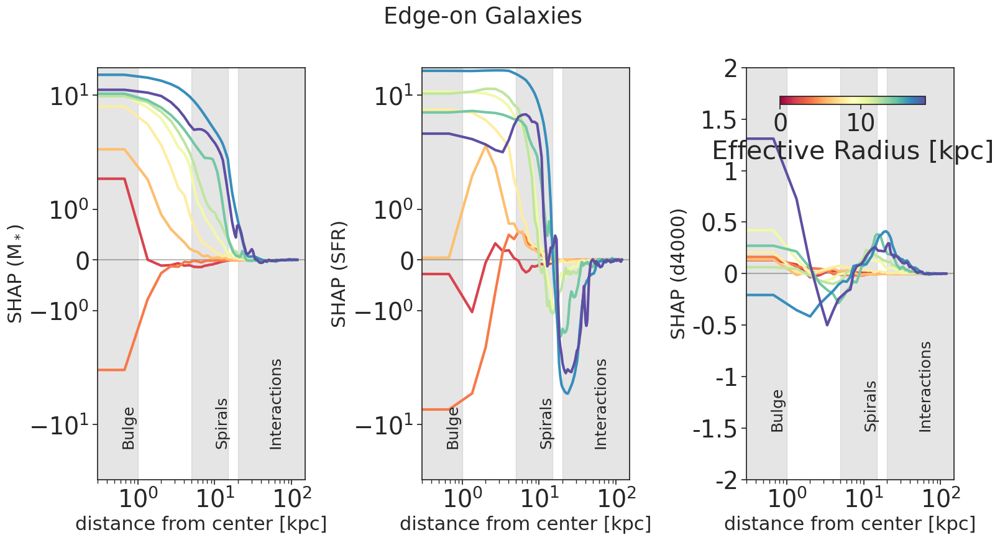

In [117]:
plt.rcParams['font.size'] = 22
make_radial_shapplot_edge_on(mv = er, 
                     massbins = np.arange(0,20,2),
                     clabel = 'Effective Radius [kpc]')

[ 0  2  4  6  8 10 12 14 16 18]
(4, 179)
(1052, 179)
(977, 179)
(643, 179)
(347, 179)
(170, 179)
(109, 179)
(55, 179)
(24, 179)
(22, 179)


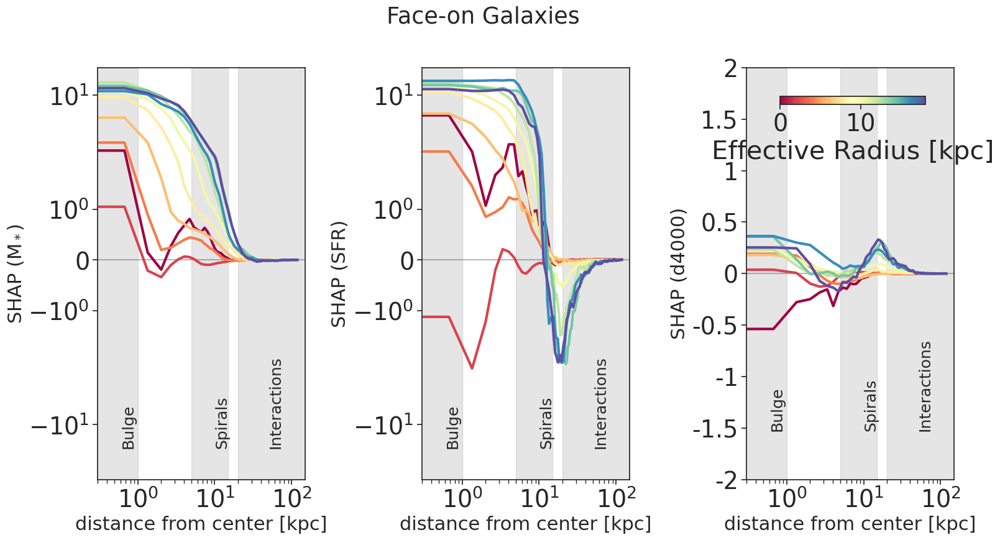

In [115]:
plt.rcParams['font.size'] = 22
make_radial_shapplot_face_on(mv = er, 
                     massbins = np.arange(0,20,2),
                     clabel = 'Effective Radius [kpc]')

In [126]:
ssfr = np.array(manga_scalars['log_sfr'])-np.array(manga_scalars['log_mstar'])
mask = np.where(ssfr < -10.8)[0]

In [127]:
len(mask)

5329

Chain Uncertanties

In [18]:
device = 'cuda'
model_used = 'ResNet50_log_t50_chain_90_10'

model_mass = models.resnet50(weights=None)
model_mass.fc = nn.Linear(2048, 1)
model_mass = nn.DataParallel(model_mass,device_ids=(0,1))
model_mass.load_state_dict(torch.load(work_dir+'models/Mass_'+model_used+'.pytorch'),strict=True)#strict is set to false since it was trained on multiple GPUs it causes an error when loaded on the model that is not on multiple GPUs yet
                                                                                                # DO NOT DO THIS!! MESSES WITH THE MODEL PREDECTIONS HEAVILY
model_mass.eval()

model_sfr = models.resnet50(weights='ResNet50_Weights.IMAGENET1K_V1')
model_sfr.conv1 = nn.Conv2d(4, 64, kernel_size=7, stride=2, padding=3,bias=False)
model_sfr.fc = nn.Linear(2048, 1)
model_sfr = nn.DataParallel(model_sfr,device_ids=(0,1))
model_sfr.load_state_dict(torch.load(work_dir+'models/SFR_'+model_used+'.pytorch'),strict=True)
model_sfr.eval()

model_used = 'd4000_chain'

model_t50 = models.resnet50(weights='ResNet50_Weights.IMAGENET1K_V1')
model_t50.conv1 = nn.Conv2d(5, 64, kernel_size=7, stride=2, padding=3,bias=False)
model_t50.fc = nn.Linear(2048, 1)
model_t50 = nn.DataParallel(model_t50,device_ids=(0,1))
model_t50.load_state_dict(torch.load(work_dir+'models/d4000_'+model_used+'.pytorch'),strict=True)
model_t50.eval()

model_mass, model_sfr, model_t50 = model_mass.to(device), model_sfr.to(device), model_t50.to(device)



In [19]:
# Define the one-layer linear neural network class
class LinearNet(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(LinearNet, self).__init__()
        self.linear_in = nn.Linear(input_size, hidden_size)
        self.linear_out = nn.Linear(hidden_size, output_size)
        self.linear = nn.Linear(hidden_size,hidden_size)
        self.activation = nn.ReLU()
    
    def forward(self, x):
        # print(x.size())
        out = self.linear_in(x)
        # print(out.size())
        out = self.activation(out)
        out = self.linear(out)
        out = self.activation(out)
        out = self.linear(out)
        out = self.activation(out)
        out = self.linear(out)
        out = self.activation(out)
        # out = self.linear(out)
        # out = self.activation(out)
        out = self.linear_out(out)
        return out

# Example usage
input_size = 2
hidden_size = 100
output_size = 1

# Create an instance of the LinearNet
d4000_to_t50 = LinearNet(input_size, hidden_size, output_size).to('cuda')
d4000_to_t50.load_state_dict(torch.load(work_dir+'models/d400_to_t50.pytorch'))


<All keys matched successfully>

In [203]:
import cv2
import numpy as np
from PIL import Image

def estimate_sky_noise(image):
    """
    Estimates sky noise from a 256x256 RGB galaxy image.

    Args:
        image: A numpy array (RGB) or PIL Image representing the image.

    Returns:
        A tuple containing the average and standard deviation of the sky noise.
    """

    # Handle NumPy, PIL, and PyTorch tensor image types
    if isinstance(image, np.ndarray):
        image_np = image  
    elif isinstance(image, Image.Image):
        image_np = np.array(image)[:, :, ::-1]  # Convert PIL RGB to NumPy BGR 
    elif isinstance(image, torch.Tensor):
        image_np = image.permute(1, 2, 0).numpy()  # Convert to NumPy (H x W x C)
    else:
        raise ValueError("Unsupported image format. Please provide a NumPy array, PIL Image, or PyTorch tensor.")

    #Define border widths
    border_width_h = 5 
    border_width_w = 5

     # Extract borders with overlaps
    height, width, channels = image_np.shape 
    sky_pixels = []
    for channel in range(channels):
        top_border = image_np[:border_width_h, :, channel]
        bottom_border = image_np[height-border_width_h:, :, channel]
        left_border = image_np[:, :border_width_w, channel].T  # Include up to the border
        right_border = image_np[:, width-border_width_w:, channel].T  # Include up to the border

        # Combine all borders
        # print("top_border shape:", top_border.shape)
        # print("bottom_border shape:", bottom_border.shape)
        # print("left_border shape:", left_border.shape)
        # print("right_border shape:", right_border.shape)
        sky_pixels.append(np.concatenate((top_border, bottom_border, left_border, right_border)))

  
    # Flatten and calculate statistics
    sky_pixels = np.concatenate(sky_pixels)
    sky_mean = np.mean(sky_pixels)
    sky_std = np.std(sky_pixels)

    return sky_mean, sky_std

background_std = []
for image in test_images_list:
    sky_mean, sky_std = estimate_sky_noise(image)
    # print("Sky mean:", sky_mean)
    # print("Sky standard deviation (noise):", sky_std)
    background_std.append(sky_std)

background_std = np.array(background_std)
test_image_array= np.array(test_images_list)

# np.save('background_std.npy',background_std)

In [ ]:
import numpy as np

def add_sky_noise(image, sky_std, num_iterations=100):
    """Adds sky noise to an image multiple times for uncertainty estimation.

    Args:
        image: The original image (NumPy array).
        sky_std: The standard deviation of the sky noise.
        num_iterations: The number of times to add noise and generate new images.

    Returns:
        A list of noise-added images.
    """

    noisy_images = []

    for _ in range(num_iterations):
        noise = np.random.normal(0, np.full_like(image,sky_std), image.shape)
        # print(image.shape, noise.shape)
        noisy_image = image + noise
        noisy_images.append(noisy_image)

    return noisy_images

# Example usage with the 'estimate_sky_noise' function we defined earlier:
for i in tqdm(range(len(background_std))):
    sky_std = background_std[i] 
    noisy_images = add_sky_noise(test_images_list[i],sky_std) 


In [35]:
import numpy as np
batch_size = 32
background_std = np.load('background_std.npy')

all_predicted_mstar =[]
all_predicted_sfr=[]
all_predicted_d4000=[]
all_predicted_t50 = []


def run_through_pipeline_and_predict(num_iterations=100):
    """Adds sky noise, runs image through a model pipeline, and saves predictions."""


    # predicted_mstar = []
    # predicted_sfr =[]
    # predicted_d4000 =[]
    # predicted_t50 =[]

    for p in tqdm(range(num_iterations)):
        #Run images through the model and extract the predicitions

        predictions_test_mass = []
        predictions_test_sfr =[]
        predictions_test_d4000 =[]
        predictions_test_t50 =[]

        incomplete_batch_id_test=len(val_ids)-1

        remainder_test=len(val_ids[incomplete_batch_id_test])

        total_values_test=(len(val_ids)*batch_size)-(batch_size-remainder_test)
        #Getting Predicitions for the Test set 
        for batch_idx, temp in enumerate(val_loader):

            if batch_idx<incomplete_batch_id_test:
                image_batch = temp['image']
                for i in range(batch_size):
                    noise = np.random.normal(0, np.full_like(image_batch[i], background_std[batch_idx*32+i]), image_batch[i].shape)
                    image_batch[i,:,:,:]=image_batch[i,:,:,:]+noise
                
                image_batch = image_batch.to('cuda')
                
                pred_mass_batch = model_mass(image_batch)
                # print(pred_mass_batch.shape)
                mass_batch = np.zeros((batch_size,1,256,256))
                for i in range(batch_size):
                    mass_batch[i,:,:,:]=np.ones((1,1,256,256))*pred_mass_batch.detach().cpu().numpy().flatten()[i]
                image_mass_batch = torch.concat((image_batch,torch.tensor(mass_batch).float().to('cuda')),1)

                pred_sfr_batch= model_sfr(image_mass_batch)
                # print(pred_sfr_batch.shape)
                sfr_batch = np.zeros((batch_size,1,256,256))
                for i in range(batch_size):
                    sfr_batch[i,:,:,:]=np.ones((1,1,256,256))*pred_sfr_batch.detach().cpu().numpy().flatten()[i]
                
                
                image_mass_sfr_batch = torch.concat((image_mass_batch,torch.tensor(sfr_batch).float().to('cuda')),1)

                pred_d4000_batch = model_t50(image_mass_sfr_batch)
  
                input_data_plot = torch.stack((torch.tensor(pred_d4000_batch,dtype=torch.float32),torch.tensor(pred_sfr_batch,dtype=torch.float32)-torch.tensor(pred_mass_batch,dtype=torch.float32)),dim=1)
                input_data_plot = input_data_plot.reshape(input_data_plot.shape[0],input_data_plot.shape[1])

                t50_outputs_test = d4000_to_t50(input_data_plot.to(device))
                # print(t50_outputs_test.shape)

                pred_mass_batch, pred_sfr_batch, pred_d4000_batch, pred_t50_batch = pred_mass_batch.detach().cpu().numpy() ,pred_sfr_batch.detach().cpu().numpy(), pred_d4000_batch.detach().cpu().numpy(), t50_outputs_test.detach().cpu().numpy()

                # print(pred_mass_batch.shape, pred_sfr_batch.shape, pred_d4000_batch.shape) 


                for j in range(batch_size):
                    predictions_test_mass.append(pred_mass_batch[j])     
                    predictions_test_sfr.append(pred_sfr_batch[j])
                    predictions_test_d4000.append(pred_d4000_batch[j])
                    predictions_test_t50.append(pred_t50_batch[j])
                    
              

            else:
                image_batch = temp['image']
                for i in range(remainder_test):
                    noise = np.random.normal(0, np.full_like(image_batch[i], background_std[batch_idx*remainder_test+i]), image_batch[i].shape)
                    image_batch[i,:,:,:]=image_batch[i,:,:,:]+noise
                
                image_batch = image_batch.to('cuda')


                pred_mass_batch = model_mass(image_batch)
                mass_batch = np.zeros((remainder_test,1,256,256))
                for i in range(remainder_test):
                    mass_batch[i,:,:,:]=np.ones((1,1,256,256))*pred_mass_batch.detach().cpu().numpy().flatten()[i]
                image_mass_batch = torch.concat((image_batch,torch.tensor(mass_batch).float().to('cuda')),1)

                pred_sfr_batch= model_sfr(image_mass_batch)
                sfr_batch = np.zeros((remainder_test,1,256,256))
                for i in range(remainder_test):
                    sfr_batch[i,:,:,:]=np.ones((1,1,256,256))*pred_sfr_batch.detach().cpu().numpy().flatten()[i]
                
                
                image_mass_sfr_batch = torch.concat((image_mass_batch,torch.tensor(sfr_batch).float().to('cuda')),1)
                pred_d4000_batch = model_t50(image_mass_sfr_batch)

                input_data_plot = torch.stack((torch.tensor(pred_d4000_batch,dtype=torch.float32),torch.tensor(pred_sfr_batch,dtype=torch.float32)-torch.tensor(pred_mass_batch,dtype=torch.float32)),dim=1)
                input_data_plot = input_data_plot.reshape(input_data_plot.shape[0],input_data_plot.shape[1])

                t50_outputs_test = d4000_to_t50(input_data_plot.to(device))
                # print(t50_outputs_test.shape)

                pred_mass_batch, pred_sfr_batch, pred_d4000_batch, pred_t50_batch = pred_mass_batch.detach().cpu().numpy() ,pred_sfr_batch.detach().cpu().numpy(), pred_d4000_batch.detach().cpu().numpy(), t50_outputs_test.detach().cpu().numpy()

                # print(pred_mass_batch.shape, pred_sfr_batch.shape, pred_d4000_batch.shape) 


                for j in range(remainder_test):
                    predictions_test_mass.append(pred_mass_batch[j])     
                    predictions_test_sfr.append(pred_sfr_batch[j])
                    predictions_test_d4000.append(pred_d4000_batch[j])

            
                
        all_predicted_mstar.append(np.array(predictions_test_mass))
        all_predicted_sfr.append(np.array(predictions_test_sfr))
        all_predicted_d4000.append(np.array(predictions_test_d4000))
        all_predicted_t50.append(np.array(predictions_test_t50))


    
    # all_predicted_mstar.append(np.array(predicted_mstar))
    # all_predicted_sfr.append(np.array(predictions_test_sfr))
    # all_predicted_d4000.append(np.array(predicted_d4000))
    # all_predicted_t50.append(np.array(predicted_t50))
    



    # return predictions

run_through_pipeline_and_predict()


100%|██████████| 100/100 [20:44<00:00, 12.44s/it]


In [71]:
print(len(all_predicted_mstar),len(all_predicted_mstar[0]))
np.shape(all_predicted_mstar_array)

100 939


(100, 939, 1)

In [72]:
all_predicted_mstar_array=np.array(all_predicted_mstar)
standard_deviations_mass = np.std(all_predicted_mstar_array, axis=0)

all_predicted_sfr_array=np.array(all_predicted_sfr)
standard_deviations_sfr = np.std(all_predicted_sfr_array, axis=0)

all_predicted_d4000_array=np.array(all_predicted_d4000)
standard_deviations_d4000 = np.std(all_predicted_d4000_array, axis=0)

all_predicted_t50_array=np.array(all_predicted_t50)
standard_deviations_t50 = np.std(all_predicted_t50_array, axis=0)


In [78]:
print(np.mean(standard_deviations_mass),np.mean(standard_deviations_sfr),np.mean(standard_deviations_d4000),np.mean(standard_deviations_t50))

0.023271352 0.09574368 0.011694481 0.021158028


In [ ]:
import numpy as np
import torch

def run_through_pipeline_and_predict(image, sky_std, model_mass=model_mass, model_sfr=model_sfr, model_t50=model_t50, num_iterations=100):
    """Adds sky noise, runs images through the pipeline, and collects predictions.

    Args:
        image: The original image (NumPy array or PyTorch tensor).
        sky_std: The standard deviation of the sky noise.
        model_mass: The PyTorch model for M* prediction.
        model_sfr: The PyTorch model for SFR prediction.
        model_t50: The PyTorch model for t50 prediction.
        num_iterations: Number of times to add noise and generate predictions.

    Returns:
        predicted_mstar: A list of M* predictions for each iteration.
        predicted_sfr: A list of SFR predictions for each iteration.
        predicted_d4000: A list of d4000 predictions for each iteration.
        predicted_t50: A list of t50 predictions for each iteration.
    """

    predicted_mstar = []
    predicted_sfr = []
    predicted_d4000 = []
    predicted_t50=[]

    for _ in range(num_iterations):
        # Add noise
        image_np = image.numpy()  # Assuming PyTorch tensor input
        noise = np.random.normal(0, np.full_like(image_np, sky_std), image_np.shape)
        noisy_image_np = image_np + noise  
        noisy_image = torch.from_numpy(noisy_image_np)
        noisy_image = torch.tensor(noisy_image, dtype=torch.float32).to('cuda')

        # Model inference (assuming models are already on 'cuda')
        with torch.no_grad(): 
            pred_mass = model_mass(noisy_image.unsqueeze(0))  # Add batch dimension
            pred_mass = pred_mass.unsqueeze(2).unsqueeze(3)  # Add dimensions 
            pred_mass = pred_mass.expand(-1, 3, -1, -1)  # Expand across channels 
            # pred_mass = torch.tensor(pred_mass.item()*np.ones((1,256,256)),dtype=torch.float32).to('cuda')
            # print(pred_mass.shape,noisy_image.shape)
            image_mass = torch.concat((noisy_image, pred_mass), 1)

            pred_sfr = model_sfr(image_mass)
            image_mass_sfr = torch.concat((image_mass, pred_sfr), 1)

            pred_d4000 = model_t50(image_mass_sfr)

        # Extract and store predictions
        predicted_mstar.append(pred_mass.item())  # Or extract the relevant value
        predicted_sfr.append(pred_sfr.item())
        predicted_d4000.append(pred_d4000.item())

        input_data_plot = torch.stack((torch.tensor(pred_d4000.item(),dtype=torch.float32),torch.tensor(pred_sfr.item(),dtype=torch.float32)-torch.tensor(pred_mass.item(),dtype=torch.float32)),dim=1)
        input_data_plot = input_data_plot.reshape(input_data_plot.shape[0],input_data_plot.shape[1])

        t50_output = d4000_to_t50(input_data_plot.to('cuda'))
        t50_output = t50_output.detach().cpu().numpy().flatten()
        t50_output = t50_output*13.6 #to make it in units of Gyr 

        predicted_t50.append(t50_output)

    return predicted_mstar, predicted_sfr, predicted_d4000, predicted_t50

all_predicted_mstar =[]
all_predicted_sfr=[]
all_predicted_d4000=[]
all_predicted_t50 = []

for i in tqdm(range(len(background_std))):  
    sky_std = background_std[i] 
    a,b ,c ,d =run_through_pipeline_and_predict(test_images_list[i], sky_std)
    all_predicted_mstar.append(a)
    all_predicted_sfr.append(b)
    all_predicted_d4000.append(c)
    all_predicted_t50.append(d)
    


In [ ]:
import numpy as np
from PIL import Image
import os 

def add_sky_noise_and_save(image, sky_std, filename, num_iterations=100, save_path='.'):
    """Adds sky noise to an image multiple times and saves the results.

    Args:
        image: The original image (NumPy array).
        sky_std: The standard deviation of the sky noise.
        num_iterations: The number of times to add noise and generate new images.
        save_path: The directory where to save the noisy images.
    """

    for i in range(num_iterations):
        # Convert tensor to NumPy for noise generation
        image_np = image.numpy()
        noise = np.random.normal(0, sky_std, image_np.shape)
        noisy_image_np = image_np + noise  

        min_val, max_val = noisy_image_np.min(), noisy_image_np.max()
        if min_val != max_val:  # Check if normalization is necessary
            noisy_image_np = (noisy_image_np - min_val) / (max_val - min_val) * 255
            noisy_image_np = noisy_image_np.astype('uint8')


        # Convert back to PyTorch tensor
        noisy_image = torch.from_numpy(noisy_image_np)

        

        # Convert to PIL Image for saving
        noisy_image_pil = Image.fromarray(noisy_image.permute(1, 2, 0).numpy().astype('uint8'))

    
        save_filepath = os.path.join(save_path, filename)

        # Save the image
        noisy_image_pil.save(save_filepath)



save_directory = '/home/juanpabloalfonzo/Documents/Manga CNNs/Noisy Images'  # Create a directory if it doesn't exist

for i in tqdm(range(len(test_image_array))):
    image = test_image_array[i]
    sky_std = background_std[i]
    filename = str(test_ids_list[i]) + '.png'
    add_sky_noise_and_save(image, sky_std, filename, num_iterations=100, save_path=save_directory)


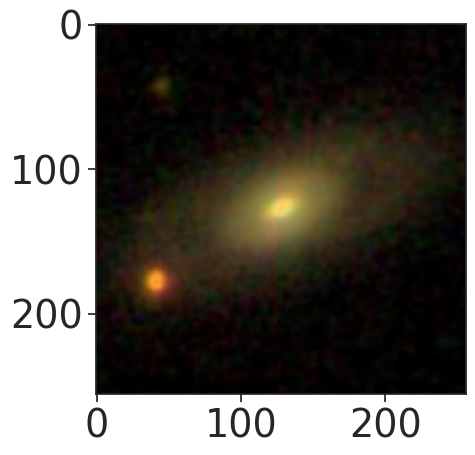

In [215]:
plt.imshow(test_images_list[0].permute(2,1,0))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


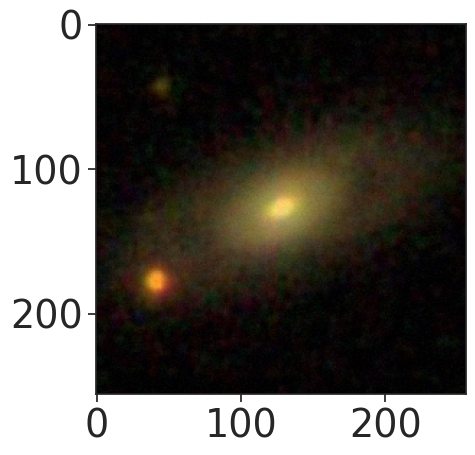

In [213]:
plt.imshow(noisy_images[0].permute(2,1,0))

Reduced Image Quality Check

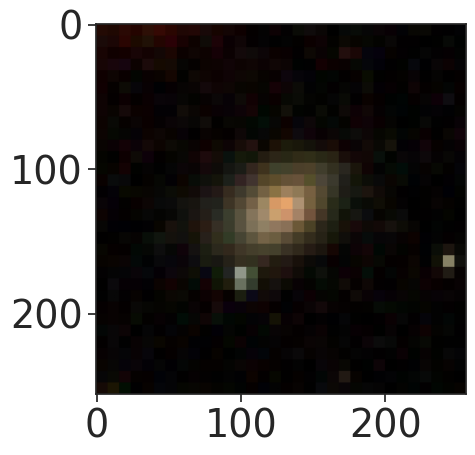

In [59]:
from PIL import Image

# def degrade_pixelation(image, factor=2):
#     if image.shape[2] == 3:  # Check if it's an RGB image
#         image = (image * 255).astype(np.uint8)  # Convert to uint8 
#         img = Image.fromarray(image, mode='RGB')  # Create PIL Image (important!)
#         small_img = img.resize((img.width // factor, img.height // factor), resample=Image.NEAREST)
#         return np.array(small_img.resize((img.width, img.height), resample=Image.NEAREST))  
#     else:
#         # Handle grayscale or other image types appropriately
#         pass 

def degrade_pixelation(image, factor=8):
    if image.shape[2] == 3:  # Check if it's an RGB image
        image = (image * 255).astype(np.uint8)  # Convert to uint8 
        img = Image.fromarray(image, mode='RGB')  
        small_img = img.resize((img.width // factor, img.height // factor), resample=Image.NEAREST)
        result =  np.array(small_img.resize((img.width, img.height), resample=Image.NEAREST)) / 255.0  # Renormalize
        return result 
    else:
        # Handle grayscale or other image types appropriately
        pass 



model = models.resnet50()
model.fc= nn.Linear(2048, 1)
model = nn.DataParallel(model,device_ids=(0,1))
model_used = 'Manga_(DR17)_ResNet50_Mass'
# model_used = 'd4000'
model.load_state_dict(torch.load(work_dir+'models/'+model_used+'.pytorch'),strict=True)
model.to('cuda')
model.eval()

#Run images through the model and extract the predicitions

predictions_train =[]
predictions_test =[]

incomplete_batch_id_test=len(val_ids)-1

remainder_test=len(val_ids[incomplete_batch_id_test])

total_values_test=(len(val_ids)*batch_size)-(batch_size-remainder_test)

incomplete_batch_id_train=len(train_ids)-1

remainder_train=len(train_ids[incomplete_batch_id_train])

total_values_train=(len(train_ids)*batch_size)-(batch_size-remainder_train)


for batch_idx, temp in enumerate(train_loader):
    image = temp['image']
     # Degradation Step:
    if isinstance(image, torch.Tensor):  # If it's a tensor
        image = image.permute(0, 2, 3, 1).cpu().numpy()  # Convert to suitable format
        for i in range(image.shape[0]):
            image[i] = degrade_pixelation(image[i])  # Apply degradation
        image = torch.from_numpy(image).permute(0, 3, 1, 2).to('cuda')
    else:  # Assuming image paths
        for i in range(len(image)):
            image[i] = degrade_pixelation(image[i])  # Apply degradation
    if batch_idx ==0:
        plt.imshow(image[0].detach().cpu().permute(2,1,0))
    else:
        pass
    image = image.to('cuda')

    # Continue your code:
    outputs = model(image).detach().cpu().numpy()
    if batch_idx<incomplete_batch_id_train:
        for j in range(batch_size):     
            predictions_train.append(outputs[j])
    else:
        for k in range(remainder_train):
            predictions_train.append(outputs[k])

for batch_idx, temp in enumerate(val_loader):
    image = temp['image']
    # Degradation Step:
    if isinstance(image, torch.Tensor):  # If it's a tensor
        image = image.permute(0, 2, 3, 1).cpu().numpy()  # Convert to suitable format
        for i in range(image.shape[0]):
            image[i] = degrade_pixelation(image[i])  # Apply degradation
        image = torch.from_numpy(image).permute(0, 3, 1, 2).to('cuda')
    else:  # Assuming image paths
        for i in range(len(image)):
            image[i] = degrade_pixelation(image[i])  # Apply degradation

    image = image.to('cuda')
    outputs = model(image).detach().cpu().numpy()
    if batch_idx<incomplete_batch_id_test:
        for j in range(batch_size):     
            predictions_test.append(outputs[j])
    else:
        for k in range(remainder_test):
            predictions_test.append(outputs[k])
        




(8.5, 12.0)

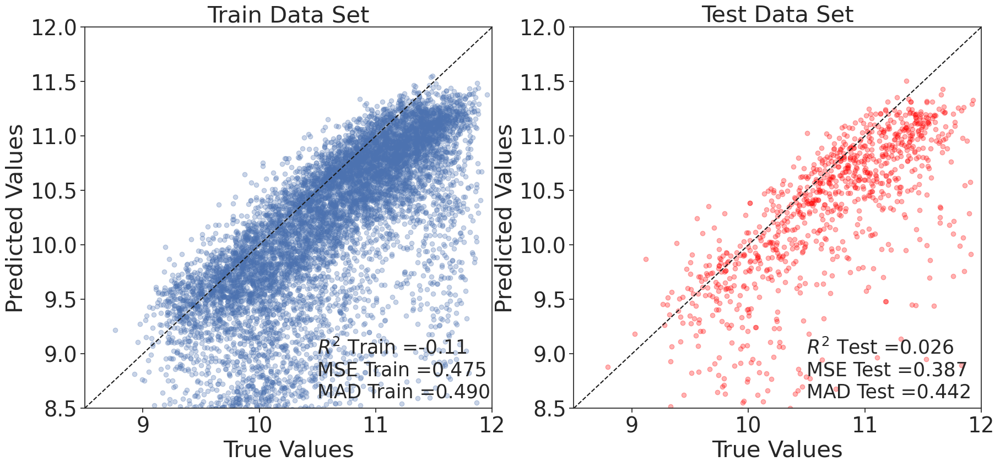

In [60]:
outlier = np.where((np.array(train_mass_list)<13) & (np.array(train_mass_list)>8))[0]
outlier_test = np.where((np.array(test_mass_list)<13))[0]

plt.figure(figsize=(21,9))
plt.subplot(1,2,1)
plt.title('Train Data Set')
plt.scatter(np.array(train_mass_list)[outlier],np.array(predictions_train)[outlier],alpha=0.3)
plt.plot([8.5,12],[8.5,12],'k--')
plt.text(10.5,9,'$R^2$ Train ='+str((r2_score(np.array(train_mass_list)[outlier],np.array(predictions_train)[outlier])))[0:5],fontsize='small')
plt.text(10.5,8.8,'MSE Train =' +str(mean_squared_error(np.array(train_mass_list)[outlier],np.array(predictions_train)[outlier]))[0:5], fontsize='small')
plt.text(10.5,8.6,'MAD Train ='+ str(mean_absolute_error(np.array(train_mass_list)[outlier],np.array(predictions_train)[outlier]))[0:5], fontsize='small')
plt.xlabel('True Values')
plt.ylabel('Predicted Values')
plt.xlim(8.5,12)
plt.ylim(8.5,12)
plt.subplot(1,2,2)
plt.title('Test Data Set')
plt.scatter(np.array(test_mass_list)[outlier_test],np.array(predictions_test)[outlier_test],alpha=0.3,c='red')
plt.plot([8.5,12],[8.5,12],'k--')
plt.text(10.5,9,'$R^2$ Test ='+str((r2_score(np.array(test_mass_list)[outlier_test],np.array(predictions_test)[outlier_test])))[0:5],fontsize='small')
plt.text(10.5,8.8,'MSE Test =' +str(mean_squared_error(np.array(test_mass_list)[outlier_test],np.array(predictions_test)[outlier_test]))[0:5], fontsize='small')
plt.text(10.5,8.6,'MAD Test ='+str(mean_absolute_error(np.array(test_mass_list)[outlier_test],np.array(predictions_test)[outlier_test]))[0:5], fontsize='small')
plt.xlabel('True Values')
plt.ylabel('Predicted Values')
plt.xlim(8.5,12)
plt.ylim(8.5,12)


In [61]:
#Run images through the model and extract the predicitions

predictions_train_sfr =[]
predictions_train_t50 =[]

predictions_test_sfr =[]
predictions_test_t50 =[]

incomplete_batch_id_test=len(val_ids)-1

remainder_test=len(val_ids[incomplete_batch_id_test])

total_values_test=(len(val_ids)*batch_size)-(batch_size-remainder_test)

incomplete_batch_id_train=len(train_ids)-1

remainder_train=len(train_ids[incomplete_batch_id_train])

total_values_train=(len(train_ids)*batch_size)-(batch_size-remainder_train)

#Getting predictions for the train set 
for batch_idx, temp in enumerate(train_loader):

    if batch_idx<incomplete_batch_id_train:
        image = temp['image']
        # Degradation Step:
        if isinstance(image, torch.Tensor):  # If it's a tensor
            image = image.permute(0, 2, 3, 1).cpu().numpy()  # Convert to suitable format
            for i in range(image.shape[0]):
                image[i] = degrade_pixelation(image[i])  # Apply degradation
            image = torch.from_numpy(image).permute(0, 3, 1, 2).to('cuda')
        else:  # Assuming image paths
            for i in range(len(image)):
                image[i] = degrade_pixelation(image[i])  # Apply degradation
        
        image_batch = image.to('cuda')

        pred_mass_batch = model_mass(image_batch)
        # print(pred_mass_batch)
        mass_batch = np.zeros((batch_size,1,256,256))

      
        for i in range(batch_size):
            mass_batch[i,:,:,:]=np.ones((1,1,256,256))*pred_mass_batch.detach().cpu().numpy().flatten()[i]
        image_mass_batch = torch.concat((image_batch,torch.tensor(mass_batch).float().to('cuda')),1)

        pred_sfr_batch= model_sfr(image_mass_batch)
        sfr_batch = np.zeros((batch_size,1,256,256))
        for i in range(batch_size):
            sfr_batch[i,:,:,:]=np.ones((1,1,256,256))*pred_sfr_batch.detach().cpu().numpy().flatten()[i]
        

        image_mass_sfr_batch = torch.concat((image_mass_batch,torch.tensor(sfr_batch).float().to('cuda')),1)

        pred_t50_batch = model_t50(image_mass_sfr_batch)

        pred_sfr_batch, pred_t50_batch = pred_sfr_batch.detach().cpu().numpy(), pred_t50_batch.detach().cpu().numpy()
    
        for j in range(batch_size):     
            predictions_train_sfr.append(pred_sfr_batch[j])
            predictions_train_t50.append(pred_t50_batch[j])


    else:
        image = temp['image']
        # Degradation Step:
        if isinstance(image, torch.Tensor):  # If it's a tensor
            image = image.permute(0, 2, 3, 1).cpu().numpy()  # Convert to suitable format
            for i in range(image.shape[0]):
                image[i] = degrade_pixelation(image[i])  # Apply degradation
            image = torch.from_numpy(image).permute(0, 3, 1, 2).to('cuda')
        else:  # Assuming image paths
            for i in range(len(image)):
                image[i] = degrade_pixelation(image[i])  # Apply degradation
        
        image_batch = image.to('cuda')
        pred_mass_batch = model_mass(image_batch)
        mass_batch = np.zeros((remainder_train,1,256,256))
        for i in range(remainder_train):
            mass_batch[i,:,:,:]=np.ones((1,1,256,256))*pred_mass_batch.detach().cpu().numpy().flatten()[i]
        image_mass_batch = torch.concat((image_batch,torch.tensor(mass_batch).float().to('cuda')),1)

        pred_sfr_batch= model_sfr(image_mass_batch)
        sfr_batch = np.zeros((remainder_train,1,256,256))
        for i in range(remainder_train):
            sfr_batch[i,:,:,:]=np.ones((1,1,256,256))*pred_sfr_batch.detach().cpu().numpy().flatten()[i]
        

        image_mass_sfr_batch = torch.concat((image_mass_batch,torch.tensor(sfr_batch).float().to('cuda')),1)

        pred_t50_batch = model_t50(image_mass_sfr_batch)

        pred_sfr_batch, pred_t50_batch = pred_sfr_batch.detach().cpu().numpy(), pred_t50_batch.detach().cpu().numpy()
    
        for k in range(remainder_train):
            predictions_train_sfr.append(pred_sfr_batch[k])
            predictions_train_t50.append(pred_t50_batch[k])




#Getting Predicitions for the Test set 
for batch_idx, temp in enumerate(val_loader):

    if batch_idx<incomplete_batch_id_test:
        image = temp['image']
        # Degradation Step:
        if isinstance(image, torch.Tensor):  # If it's a tensor
            image = image.permute(0, 2, 3, 1).cpu().numpy()  # Convert to suitable format
            for i in range(image.shape[0]):
                image[i] = degrade_pixelation(image[i])  # Apply degradation
            image = torch.from_numpy(image).permute(0, 3, 1, 2).to('cuda')
        else:  # Assuming image paths
            for i in range(len(image)):
                image[i] = degrade_pixelation(image[i])  # Apply degradation
        
        image_batch = image.to('cuda')
        pred_mass_batch = model_mass(image_batch)
        mass_batch = np.zeros((batch_size,1,256,256))
        for i in range(batch_size):
            mass_batch[i,:,:,:]=np.ones((1,1,256,256))*pred_mass_batch.detach().cpu().numpy().flatten()[i]
        image_mass_batch = torch.concat((image_batch,torch.tensor(mass_batch).float().to('cuda')),1)

        pred_sfr_batch= model_sfr(image_mass_batch)
        sfr_batch = np.zeros((batch_size,1,256,256))
        for i in range(batch_size):
            sfr_batch[i,:,:,:]=np.ones((1,1,256,256))*pred_sfr_batch.detach().cpu().numpy().flatten()[i]
        
        
        image_mass_sfr_batch = torch.concat((image_mass_batch,torch.tensor(sfr_batch).float().to('cuda')),1)

        pred_t50_batch = model_t50(image_mass_sfr_batch)

        pred_sfr_batch, pred_t50_batch = pred_sfr_batch.detach().cpu().numpy(), pred_t50_batch.detach().cpu().numpy()

        for j in range(batch_size):     
            predictions_test_sfr.append(pred_sfr_batch[j])
            predictions_test_t50.append(pred_t50_batch[j])


    else:
        image = temp['image']
        # Degradation Step:
        if isinstance(image, torch.Tensor):  # If it's a tensor
            image = image.permute(0, 2, 3, 1).cpu().numpy()  # Convert to suitable format
            for i in range(image.shape[0]):
                image[i] = degrade_pixelation(image[i])  # Apply degradation
            image = torch.from_numpy(image).permute(0, 3, 1, 2).to('cuda')
        else:  # Assuming image paths
            for i in range(len(image)):
                image[i] = degrade_pixelation(image[i])  # Apply degradation
        
        image_batch = image.to('cuda')
        pred_mass_batch = model_mass(image_batch)
        mass_batch = np.zeros((remainder_test,1,256,256))
        for i in range(remainder_test):
            mass_batch[i,:,:,:]=np.ones((1,1,256,256))*pred_mass_batch.detach().cpu().numpy().flatten()[i]
        image_mass_batch = torch.concat((image_batch,torch.tensor(mass_batch).float().to('cuda')),1)

        pred_sfr_batch= model_sfr(image_mass_batch)
        sfr_batch = np.zeros((remainder_test,1,256,256))
        for i in range(remainder_test):
            sfr_batch[i,:,:,:]=np.ones((1,1,256,256))*pred_sfr_batch.detach().cpu().numpy().flatten()[i]
        
        
        image_mass_sfr_batch = torch.concat((image_mass_batch,torch.tensor(sfr_batch).float().to('cuda')),1)
        pred_t50_batch = model_t50(image_mass_sfr_batch)

        pred_sfr_batch, pred_t50_batch = pred_sfr_batch.detach().cpu().numpy(), pred_t50_batch.detach().cpu().numpy()
        
        for k in range(remainder_test):
            predictions_test_sfr.append(pred_sfr_batch[k])
            predictions_test_t50.append(pred_t50_batch[k])



Text(0, 0.5, 'Predicted Values')

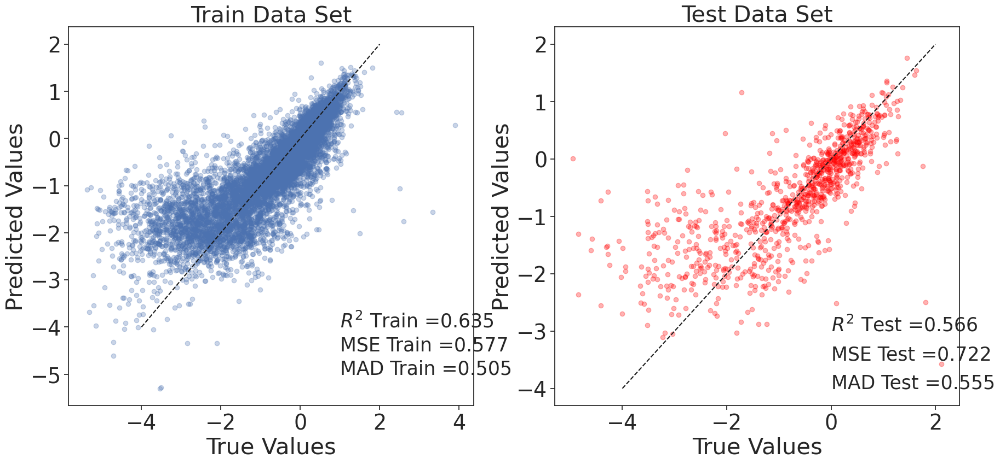

In [62]:
outlier_index_train = np.where((np.array(predictions_train_sfr)>-6) & (np.array(predictions_train_sfr)<3))[0]
outlier_index_test = np.where(np.array(predictions_test_sfr)>-6)[0]

plt.figure(figsize=(21,9))
plt.subplot(1,2,1)
plt.title('Train Data Set')
plt.scatter(np.array(train_sfr_list)[outlier_index_train],np.array(predictions_train_sfr)[outlier_index_train],alpha=0.3)
plt.plot([-4,2],[-4,2],'k--')
plt.text(1,-4,'$R^2$ Train ='+str((r2_score(np.array(train_sfr_list)[outlier_index_train],np.array(predictions_train_sfr)[outlier_index_train])))[0:5],fontsize='small')
plt.text(1,-4.5,'MSE Train ='+str((mean_squared_error(np.array(train_sfr_list)[outlier_index_train],np.array(predictions_train_sfr)[outlier_index_train])))[0:5],fontsize='small')
plt.text(1,-5,'MAD Train ='+str((mean_absolute_error(np.array(train_sfr_list)[outlier_index_train],np.array(predictions_train_sfr)[outlier_index_train])))[0:5],fontsize='small')
plt.xlabel('True Values')
plt.ylabel('Predicted Values')
plt.subplot(1,2,2)
plt.title('Test Data Set')
plt.scatter(np.array(test_sfr_list)[outlier_index_test],np.array(predictions_test_sfr)[outlier_index_test],alpha=0.3,c='red')
plt.plot([-4,2],[-4,2],'k--')
plt.text(0,-3,'$R^2$ Test ='+str((r2_score(np.array(test_sfr_list)[outlier_index_test],np.array(predictions_test_sfr)[outlier_index_test])))[0:5],fontsize='small')
plt.text(0,-3.5,'MSE Test ='+str((mean_squared_error(np.array(test_sfr_list)[outlier_index_test],np.array(predictions_test_sfr)[outlier_index_test])))[0:5],fontsize='small')
plt.text(0,-4,'MAD Test ='+str((mean_absolute_error(np.array(test_sfr_list)[outlier_index_test],np.array(predictions_test_sfr)[outlier_index_test])))[0:5],fontsize='small')
plt.xlabel('True Values')
plt.ylabel('Predicted Values')
# plt.savefig('SFR_Accuracy.pdf')

Text(0, 0.5, 'Predicted Values')

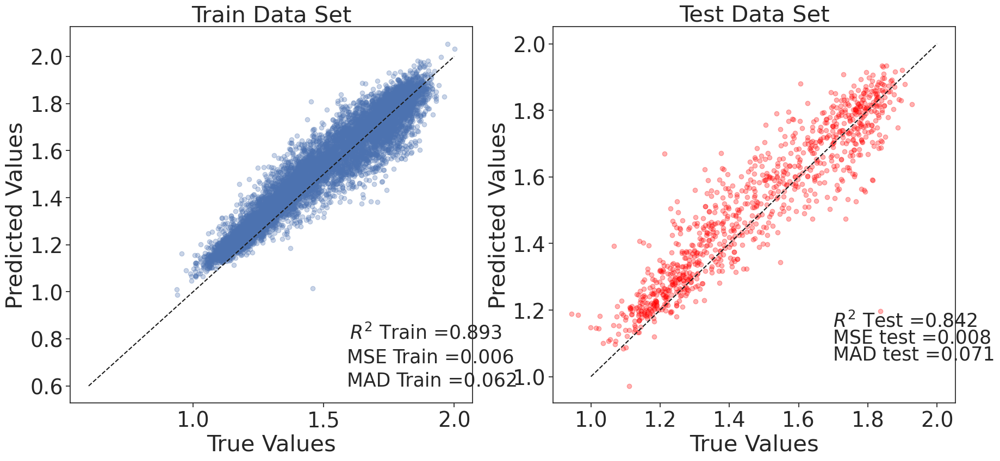

In [63]:
outlier_index_train = np.where((np.array(predictions_train_t50)<10))[0]

plt.figure(figsize=(21,9))
plt.subplot(1,2,1)
plt.title('Train Data Set')
plt.scatter(np.array(train_t50_list)[outlier_index_train],np.array(predictions_train_t50)[outlier_index_train],alpha=0.3)
plt.plot([0.6,2],[0.6,2],'k--')
# plt.ylim(top=2)
plt.text(1.6,0.8,'$R^2$ Train ='+str((r2_score(np.array(train_t50_list)[outlier_index_train],np.array(predictions_train_t50)[outlier_index_train])))[0:5],fontsize='small')
plt.text(1.59,0.7,'MSE Train ='+str((mean_squared_error(np.array(train_t50_list)[outlier_index_train],np.array(predictions_train_t50)[outlier_index_train])))[0:5],fontsize='small')
plt.text(1.59,0.6,'MAD Train ='+str((mean_absolute_error(np.array(train_t50_list)[outlier_index_train],np.array(predictions_train_t50)[outlier_index_train])))[0:5],fontsize='small')
plt.xlabel('True Values')
plt.ylabel('Predicted Values')
plt.subplot(1,2,2)
plt.title('Test Data Set')
plt.scatter(np.array(test_t50_list),predictions_test_t50,alpha=0.3,c='red')
plt.plot([1,2],[1,2],'k--')
plt.text(1.7,1.15,'$R^2$ Test ='+str((r2_score(np.array(test_t50_list),predictions_test_t50)))[0:5],fontsize='small')
plt.text(1.7,1.1,'MSE test ='+str((mean_squared_error(np.array(test_t50_list)[outlier_index_test],np.array(predictions_test_t50)[outlier_index_test])))[0:5],fontsize='small')
plt.text(1.7,1.05,'MAD test ='+str((mean_absolute_error(np.array(test_t50_list)[outlier_index_test],np.array(predictions_test_t50)[outlier_index_test])))[0:5],fontsize='small')
plt.xlabel('True Values')
plt.ylabel('Predicted Values')
# plt.savefig('D4000_Accuracy.pdf')